research question : 
- Does the fuinding impact the gas fees colected by the funding projects? 
- was the funding ROI positive?
- can we define what was the ROI? 

In [1]:
### disclaimer . The Analysis is performed one month afeter the final of the season 7.  The effects of the funding may have a Laged effect and may have not yet shown up. 

# Analysis

In [1]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime
from datetime import timedelta
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
from time import time
import seaborn as sns
import os
import causalimpact
import tensorflow as tf


### importing the data 
- ocb = Onchain Builders ( all grants recipients for onchian builders and the grants amounts)


In [2]:
ocb = pd.read_csv('../data/recipients_and_grants.csv')
metrics = pd.read_parquet('../data/ocb_metrics_raw.parquet')

In [3]:
ocb.head(5)

,Unnamed: 0,funding_date,title,to_project_name,grant_pool_name,op_amount,usd_amount,url,season,mechanism,application
0,0,2025-04-05 00:00:00.000,CreateX,createx,retrofunding_s7_onchain_builders,1367.00,1025.2500,https://atlas.optimism.io/project/op_atlas_id ...,Season 7,Retro Funding,Season 7 - Retro Funding - CreateX
1,1,2025-04-05 00:00:00.000,WOOFi,woonetwork,retrofunding_s7_onchain_builders,7718.74,5789.0550,https://atlas.optimism.io/project/op_atlas_id ...,Season 7,Retro Funding,Season 7 - Retro Funding - WOOFi
2,2,2025-04-05 00:00:00.000,Exa App,exactly,retrofunding_s7_onchain_builders,576.41,432.3075,https://atlas.optimism.io/project/op_atlas_id ...,Season 7,Retro Funding,Season 7 - Retro Funding - Exa App
3,3,2025-04-05 00:00:00.000,Velodrome Finance,velodrome,retrofunding_s7_onchain_builders,66666.67,50000.0025,https://atlas.optimism.io/project/op_atlas_id ...,Season 7,Retro Funding,Season 7 - Retro Funding - Velodrome Finance
4,4,2025-04-05 00:00:00.000,pods.media,pods-media,retrofunding_s7_onchain_builders,5757.66,4318.2450,https://atlas.optimism.io/project/op_atlas_id ...,Season 7,Retro Funding,Season 7 - Retro Funding - pods.media


In [4]:
ocb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 866 entries, 0 to 865
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Unnamed: 0       866 non-null    int64  
 1   funding_date     866 non-null    object 
 2   title            866 non-null    object 
 3   to_project_name  776 non-null    object 
 4   grant_pool_name  866 non-null    object 
 5   op_amount        866 non-null    float64
 6   usd_amount       866 non-null    float64
 7   url              866 non-null    object 
 8   season           866 non-null    object 
 9   mechanism        866 non-null    object 
 10  application      866 non-null    object 
dtypes: float64(2), int64(1), object(8)
memory usage: 74.6+ KB


In [5]:
ocb.usd_amount.sum()

np.float64(6134447.25)

In [6]:
ocb = ocb.dropna(subset = 'to_project_name')

In [7]:
ocb[ocb.to_project_name == 'uniswap'].funding_date.min() ,  ocb[ocb.to_project_name == 'uniswap'].funding_date.max()

('2025-04-05 00:00:00.000', '2025-08-06 00:00:00.000')

In [8]:
ocb[ocb.to_project_name == 'velodrome'].funding_date.min() ,  ocb[ocb.to_project_name == 'velodrome'].funding_date.max()

('2025-04-05 00:00:00.000', '2025-08-06 00:00:00.000')

### selecting top 5 receiver and top bottom receivers

In [9]:
#### projects that received funding on both rounds
multiRound = ocb.groupby('to_project_name').grant_pool_name.nunique().sort_values(ascending=False)
multiRound = multiRound[multiRound > 1]
multiRound.shape


(10,)

In [10]:
multiRound

to_project_name
0x-splits                       2
aave                            2
brahma                          2
createx                         2
multicaller-vectorized          2
party-dao                       2
ethereum-attestation-service    2
lifinance                       2
velodrome                       2
stargate-finance                2
Name: grant_pool_name, dtype: int64

In [11]:
ocba = ocb.groupby('to_project_name').agg({'op_amount': 'sum', 'usd_amount': 'sum', 'grant_pool_name': 'nunique', 'funding_date': 'nunique' }).sort_values(by='usd_amount', ascending=False)
ocba.to_csv('onchain_builders_aggregated.csv')

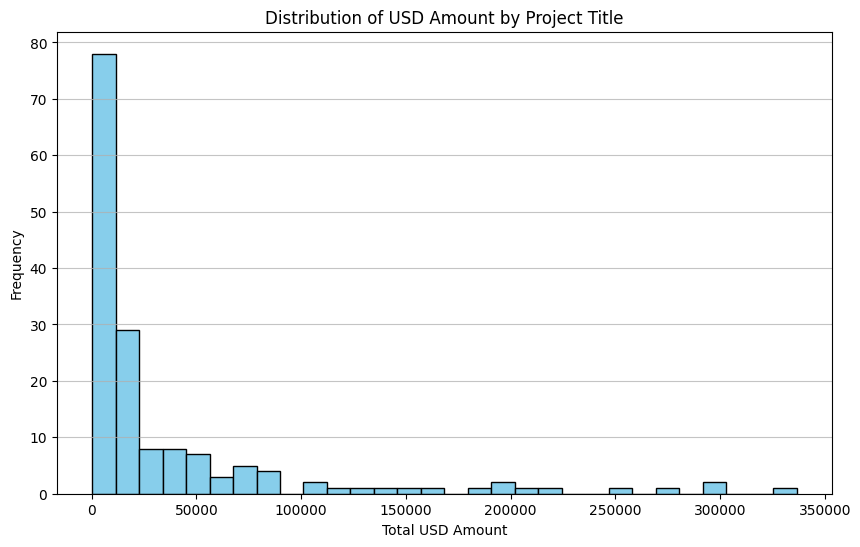

In [12]:
import matplotlib.pyplot as plt

# Group the data by 'title' and sum the 'usd_amount'
usd_distribution = ocba.usd_amount

# Plotting the distribution
plt.figure(figsize=(10, 6))
plt.hist(usd_distribution, bins=30, color='skyblue', edgecolor='black')
plt.title('Distribution of USD Amount by Project Title')
plt.xlabel('Total USD Amount')
plt.ylabel('Frequency')
plt.grid(axis='y', alpha=0.75)
plt.show()


In [13]:
ocba.usd_amount.describe()

count       159.000000
mean      37305.394292
std       63918.045546
min         161.932500
25%        4256.426250
50%       11499.390000
75%       37006.736250
max      336597.907500
Name: usd_amount, dtype: float64

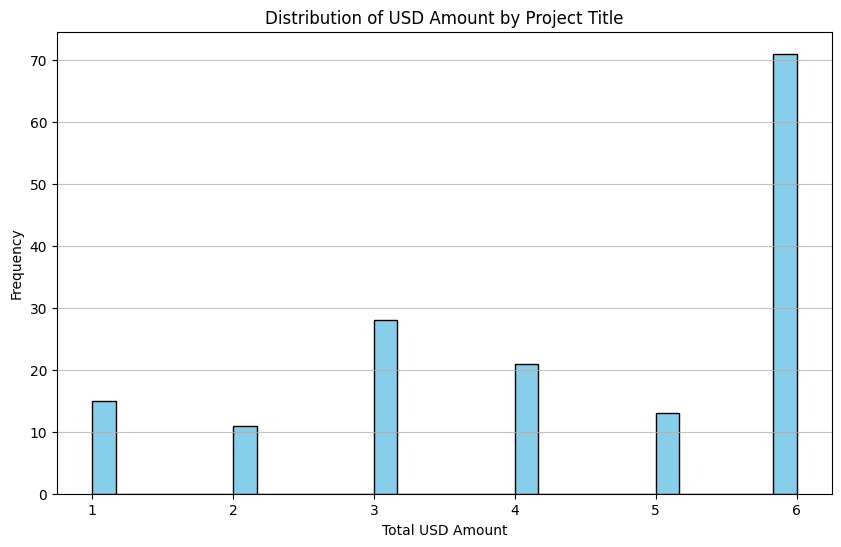

In [14]:
import matplotlib.pyplot as plt

# Group the data by 'title' and sum the 'usd_amount'
funds_deployed_distribution = ocba.funding_date

# Plotting the distribution
plt.figure(figsize=(10, 6))
plt.hist(funds_deployed_distribution, bins=30, color='skyblue', edgecolor='black')
plt.title('Distribution of USD Amount by Project Title')
plt.xlabel('Total USD Amount')
plt.ylabel('Frequency')
plt.grid(axis='y', alpha=0.75)
plt.show()


In [15]:
ocba.funding_date.describe()

count    159.000000
mean       4.377358
std        1.745443
min        1.000000
25%        3.000000
50%        5.000000
75%        6.000000
max        6.000000
Name: funding_date, dtype: float64

In [16]:
296250/ocba.usd_amount.sum()

np.float64(0.04994472200356162)

In [17]:
ocba['total_usd_amount_share'] = ocba.usd_amount / ocba.usd_amount.sum()

In [18]:
ocba.total_usd_amount_share.describe()

count    159.000000
mean       0.006289
std        0.010776
min        0.000027
25%        0.000718
50%        0.001939
75%        0.006239
max        0.056747
Name: total_usd_amount_share, dtype: float64

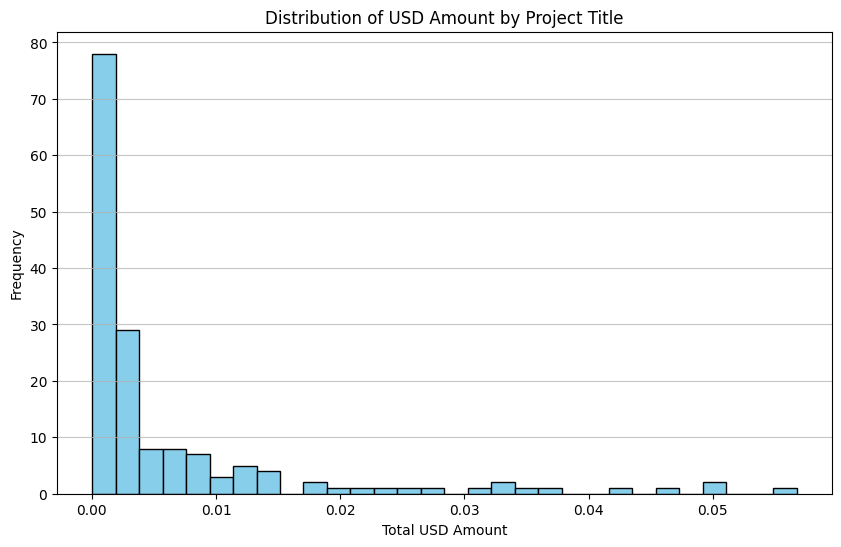

In [19]:
import matplotlib.pyplot as plt

# Group the data by 'title' and sum the 'usd_amount'
funds_deployed_distribution = ocba.total_usd_amount_share

# Plotting the distribution
plt.figure(figsize=(10, 6))
plt.hist(funds_deployed_distribution, bins=30, color='skyblue', edgecolor='black')
plt.title('Distribution of USD Amount by Project Title')
plt.xlabel('Total USD Amount')
plt.ylabel('Frequency')
plt.grid(axis='y', alpha=0.75)
plt.show()

### filtering objects of analysis

In [20]:
## getting projects that were funded at least 2 times and were above the first quartile of funds received (Q1 = 1474.957500)
proj = ocba[ (ocba.funding_date > 1) & (ocba.usd_amount > 1474.957500)].copy()
proj.sort_values(by='usd_amount', ascending=False, inplace=True)
## Final projects that will be analysed 
top5 = proj.head(5)
bot5 = proj.tail(5)


In [21]:

top5

,op_amount,usd_amount,grant_pool_name,funding_date,total_usd_amount_share
to_project_name,,,,,
party-dao,448797.21,336597.9075,2,6,0.056747
uniswap,395000.01,296250.0075,1,6,0.049945
aerodrome-finance,395000.01,296250.0075,1,6,0.049945
velodrome,369518.12,277138.5900,2,6,0.046723
eth-infinitism-account-abstraction,336853.25,252639.9375,1,6,0.042593


In [22]:
bot5

,op_amount,usd_amount,grant_pool_name,funding_date,total_usd_amount_share
to_project_name,,,,,
daobase-ai,2864.33,2148.2475,1,2,0.000362
hedgey-finance,2852.67,2139.5025,1,3,0.000361
phi-labs-inc,2685.66,2014.2450,1,4,0.000340
krystaldefi,2427.17,1820.3775,1,2,0.000307
meson-fi,2179.47,1634.6025,1,4,0.000276


## Projects metrics in time


In [23]:
metrics.head(10)

,sample_date,project_name,chain,metric,amount,rolling_30d_amount
0,2022-01-01,across,Optimism,gas_fees_daily,0.000002,0.0
1,2022-01-01,across,Optimism,transactions_daily,23.0,0.766667
2,2022-01-01,d-hedge,Optimism,gas_fees_daily,0.000017,0.000001
3,2022-01-01,d-hedge,Optimism,transactions_daily,10.0,0.333333
4,2022-01-01,hop-protocol,Optimism,defillama_tvl_daily,14755283.0,983685.533333
5,2022-01-01,hop-protocol,Optimism,gas_fees_daily,0.000297,0.00001
6,2022-01-01,hop-protocol,Optimism,transactions_daily,411.0,13.7
7,2022-01-01,smoldapp,Optimism,gas_fees_daily,0.000002,0.0
8,2022-01-01,smoldapp,Optimism,transactions_daily,6.0,0.2
9,2022-01-01,socket,Optimism,gas_fees_daily,0.000001,0.0


In [25]:
metricstop = metrics[metrics.project_name.isin(top5.index)]
metricsbot= metrics[metrics.project_name.isin(bot5.index)]
# metricsbot.to_csv('../data/metricsbot5.csv')
# metricstop.to_csv('../data/metricstop5.csv')

In [26]:
## modofying data to have and weekly aggreagtions
metricstop_weekly = metricstop.set_index('sample_date')

metricstop_weekly = metricstop_weekly.groupby([pd.Grouper(freq='W-MON'), 'project_name', 'chain', 'metric'])['amount'].sum().reset_index()


metricsbot_weekly = metricsbot.set_index('sample_date')

metricsbot_weekly = metricsbot_weekly.groupby([pd.Grouper(freq='W-MON'), 'project_name', 'chain', 'metric'])['amount'].sum().reset_index()
metricstop_weekly = pd.DataFrame(metricstop_weekly.groupby(['sample_date', 'project_name', 'metric']).amount.sum()).reset_index()
metricsbot_weekly = pd.DataFrame(metricsbot_weekly.groupby(['sample_date', 'project_name', 'metric']).amount.sum()).reset_index()

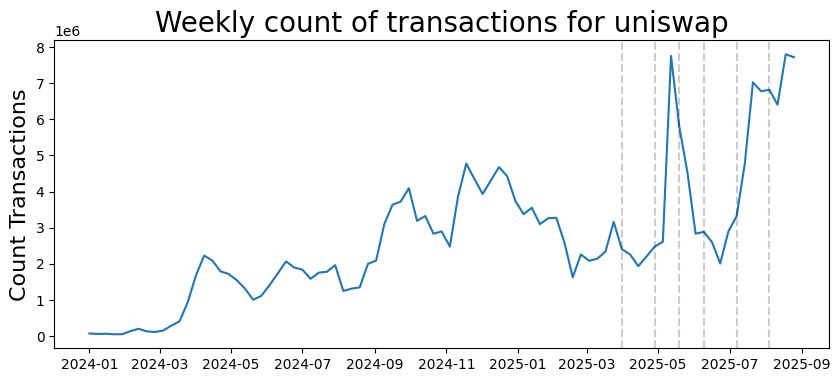

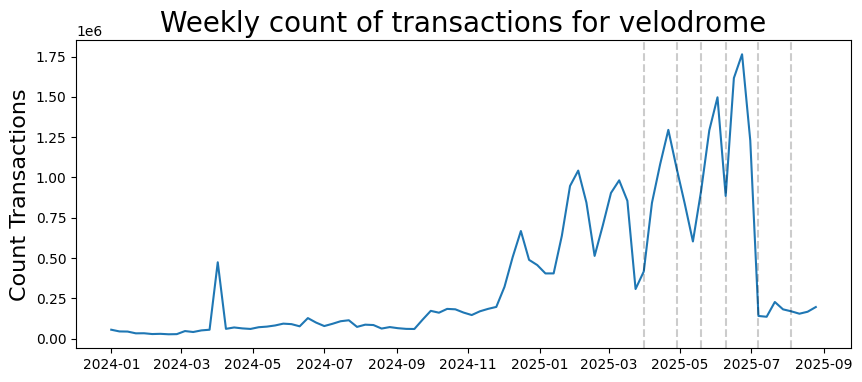

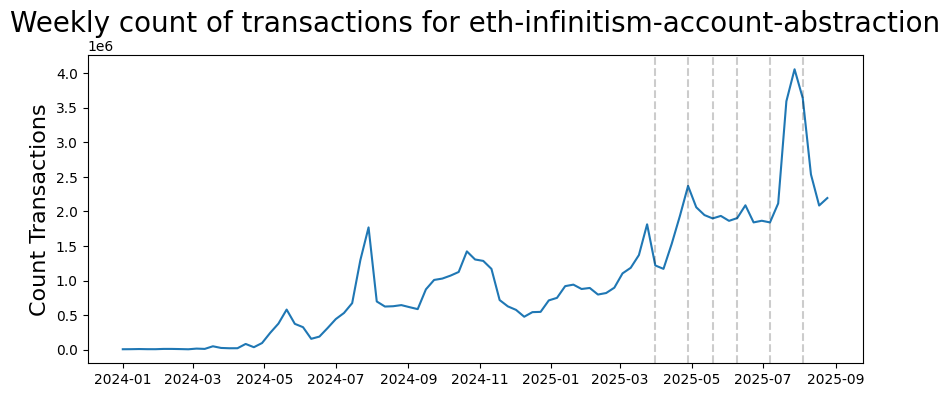

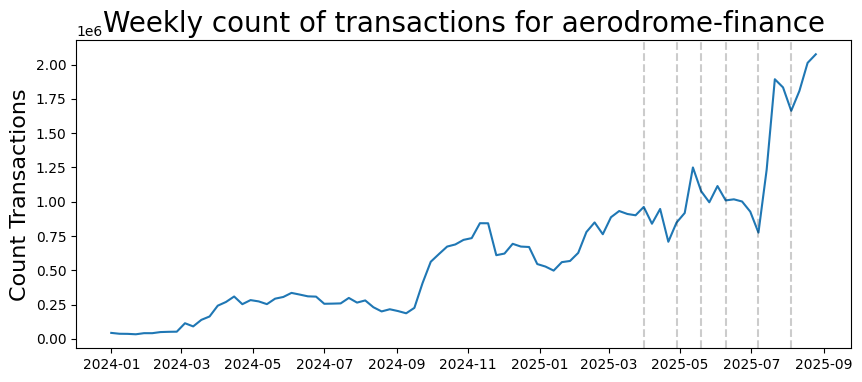

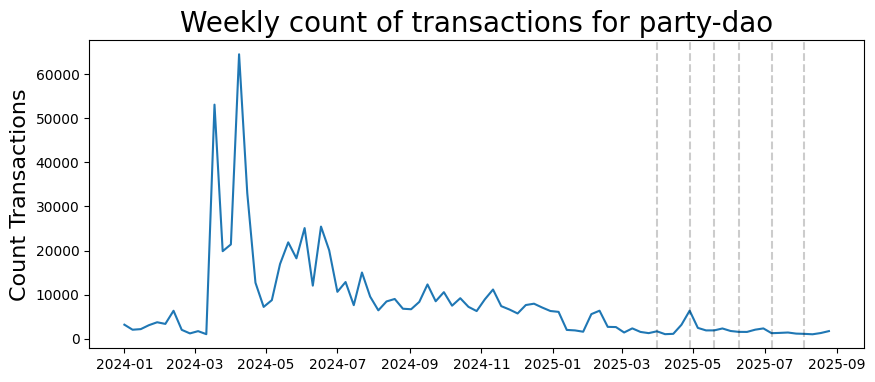

In [27]:
for i  in metricstop_weekly[metricstop_weekly.metric == 'transactions_daily'].project_name.unique():
    plt.figure(figsize=(10,4))
    start_date = datetime(2024,1,1)
    end_date = datetime(2025,8,31)
    temp_df = metricstop_weekly[(metricstop_weekly.metric == 'transactions_daily') 
                         & ( metricstop_weekly.project_name == i)
                         & (metricstop_weekly.sample_date >= start_date)
                         & (metricstop_weekly.sample_date <= end_date) ]
    plt.plot(temp_df['sample_date'], temp_df['amount'])
    plt.title(f'Weekly count of transactions for {i}', fontsize=20)
    plt.ylabel('Count Transactions', fontsize=16)
    ocb['funding_date'] = pd.to_datetime(ocb['funding_date'])
    funding_dates = ocb[ocb.to_project_name == i].funding_date.dt.to_period('W').drop_duplicates().dt.start_time
    for invest_date in funding_dates:
        plt.axvline(pd.to_datetime(invest_date), color='k', linestyle='--', alpha=0.2)

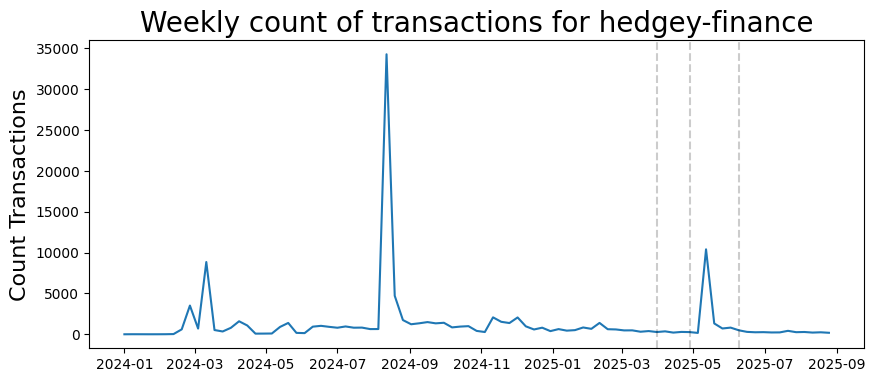

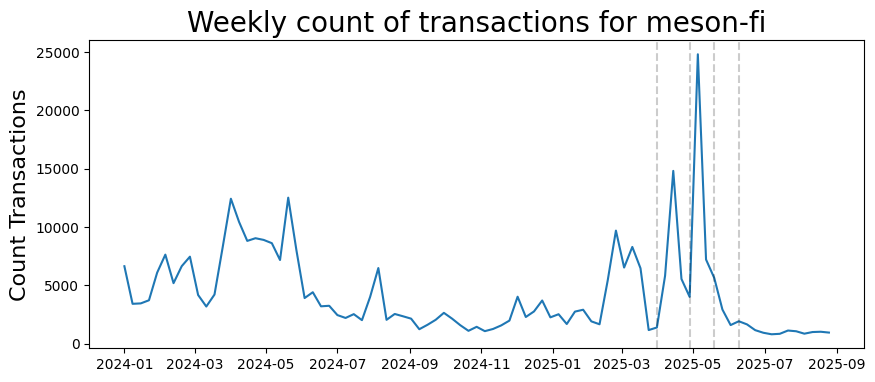

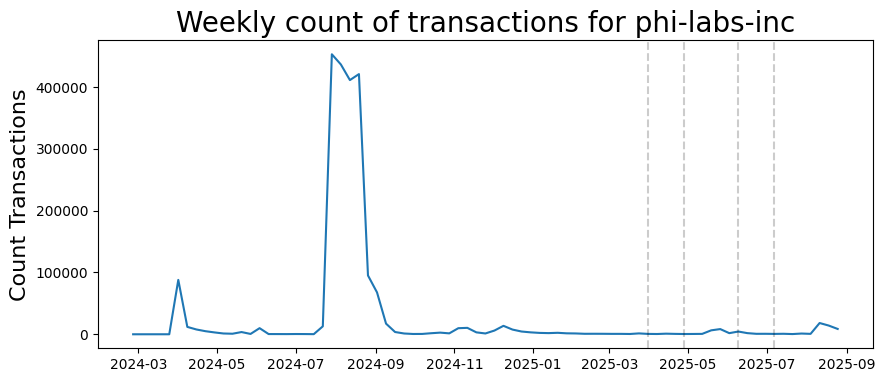

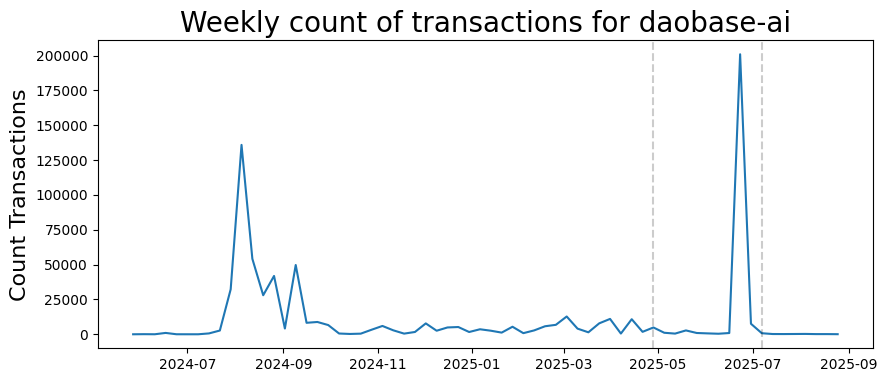

In [28]:
for i  in metricsbot_weekly[metricsbot_weekly.metric == 'transactions_daily'].project_name.unique():
    plt.figure(figsize=(10,4))
    start_date = datetime(2024,1,1)
    end_date = datetime(2025,8,31)
    temp_df = metricsbot_weekly[(metricsbot_weekly.metric == 'transactions_daily') 
                         & ( metricsbot_weekly.project_name == i)
                         & (metricsbot_weekly.sample_date >= start_date)
                         & (metricsbot_weekly.sample_date <= end_date) ]
    plt.plot(temp_df['sample_date'], temp_df['amount'])
    plt.title(f'Weekly count of transactions for {i}', fontsize=20)
    plt.ylabel('Count Transactions', fontsize=16)
    ocb['funding_date'] = pd.to_datetime(ocb['funding_date'])
    funding_dates = ocb[ocb.to_project_name == i].funding_date.dt.to_period('W').drop_duplicates().dt.start_time
    for invest_date in funding_dates:
        plt.axvline(pd.to_datetime(invest_date), color='k', linestyle='--', alpha=0.2)

### Notes
given eth Duncon update during the analysis process, utilizing gas fess collected as a comparison metric would not be possibel as gass fees have dropped significantly, there fore count of transactions will be used as the best proxy


### Creating the analysis data frame 

In [29]:
top = pd.read_csv( '../data/metricstop5.csv')


In [30]:
top.project_name.unique()

array(['uniswap', 'velodrome', 'eth-infinitism-account-abstraction',
       'aerodrome-finance', 'party-dao'], dtype=object)

In [31]:
uni = top[(top.project_name == 'uniswap') & ( top.metric == 'transactions_daily')]
uni= pd.DataFrame(uni.groupby('sample_date').amount.sum())
uni.reset_index(inplace=True)
uni.sample_date = pd.to_datetime(uni.sample_date)

uni.head()

,sample_date,amount
0,2022-01-01,949.0
1,2022-01-02,665.0
2,2022-01-03,796.0
3,2022-01-04,595.0
4,2022-01-05,988.0


In [32]:
## first and last date of funding 
ocb[ocb.to_project_name == 'uniswap'].funding_date.min() ,  ocb[ocb.to_project_name == 'uniswap'].funding_date.max()

(Timestamp('2025-04-05 00:00:00'), Timestamp('2025-08-06 00:00:00'))

In [33]:
## total transactions on the analyse funding period 
uni[(uni.sample_date >= "2025-03-01 00:00:00.000") & (uni.sample_date <= "2025-07-31 00:00:00.000")].amount.sum()

np.float64(78990267.0)

In [34]:
aero = top[(top.project_name == 'aerodrome-finance') & ( top.metric == 'transactions_daily')]
aero= pd.DataFrame(aero.groupby('sample_date').amount.sum())
aero.reset_index(inplace=True)
aero.sample_date = pd.to_datetime(aero.sample_date)
aero.head()

,sample_date,amount
0,2023-07-13,1.0
1,2023-08-28,572.0
2,2023-08-29,2772.0
3,2023-08-30,6856.0
4,2023-08-31,56661.0


In [35]:
ocb[ocb.to_project_name == 'aerodrome-finance'].funding_date.min() ,  ocb[ocb.to_project_name == 'aerodrome-finance'].funding_date.max()

(Timestamp('2025-04-05 00:00:00'), Timestamp('2025-08-06 00:00:00'))

In [36]:
## total transactions on the analyse funding period 
aero[(aero.sample_date >= "2025-03-01 00:00:00.000") & (aero.sample_date <= "2025-07-31 00:00:00.000")].amount.sum()

np.float64(23172176.0)

In [37]:
velo = top[(top.project_name == 'velodrome') & ( top.metric == 'transactions_daily')]
velo= pd.DataFrame(velo.groupby('sample_date').amount.sum())
velo.reset_index(inplace=True)
velo.sample_date = pd.to_datetime(velo.sample_date)
velo.head()

,sample_date,amount
0,2022-05-30,1.0
1,2022-06-01,1173.0
2,2022-06-02,52718.0
3,2022-06-03,15062.0
4,2022-06-04,6771.0


In [38]:
ocb[ocb.to_project_name == 'velodrome'].funding_date.min() ,  ocb[ocb.to_project_name == 'velodrome'].funding_date.max()

(Timestamp('2025-04-05 00:00:00'), Timestamp('2025-08-06 00:00:00'))

In [39]:
## total transactions on the analyse funding period 
velo[(velo.sample_date >= "2025-03-01 00:00:00.000") & (velo.sample_date <= "2025-07-31 00:00:00.000")].amount.sum()

np.float64(18662064.0)

In [40]:
curve = pd.read_parquet('../data/curve_metrics.parquet')
curve = curve[ curve.metric == 'transactions_daily']
curve= pd.DataFrame(curve.groupby('sample_date').amount.sum())
curve.reset_index(inplace=True)
curve.sample_date = pd.to_datetime(curve.sample_date)
curve.tail()

,sample_date,amount
1285,2025-07-27,841.0
1286,2025-07-28,1060.0
1287,2025-07-29,1050.0
1288,2025-07-30,1105.0
1289,2025-07-31,1232.0


In [41]:
balancer = pd.read_parquet('../data/balancer_metrics.parquet')
balancer = balancer[ balancer.metric == 'transactions_daily']
balancer= pd.DataFrame(balancer.groupby('sample_date').amount.sum())
balancer.reset_index(inplace=True)
balancer.sample_date = pd.to_datetime(balancer.sample_date)
balancer.tail()

,sample_date,amount
1162,2025-07-27,380.0
1163,2025-07-28,351.0
1164,2025-07-29,373.0
1165,2025-07-30,264.0
1166,2025-07-31,464.0


In [42]:
eth_price = pd.read_csv('../data/eth_price_market_cap_volume.csv')
eth_price.timestamp = pd.to_datetime(eth_price.timestamp)
eth_price = eth_price.iloc[:-1]
eth_price.head(5)


,timestamp,price,market_caps,total_volumes
0,2024-09-04,2437.147156,2.938183e+11,9.565142e+09
1,2024-09-05,2448.307858,2.943294e+11,1.663970e+10
2,2024-09-06,2367.770051,2.849891e+11,1.106019e+10
3,2024-09-07,2223.780428,2.675745e+11,2.608793e+10
4,2024-09-08,2272.697285,2.733503e+11,1.040519e+10


In [43]:
chains = pd.read_parquet('../data/chain_metrics.parquet')
chains = chains[ chains.metric == 'Transaction Count']
chains= pd.DataFrame(chains.groupby(['chain','sample_date']).amount.sum())
chains.reset_index(inplace=True)
chains.sample_date = pd.to_datetime(chains.sample_date)
chains.head()

,chain,sample_date,amount
0,Base,2023-06-15,9.0
1,Base,2023-06-16,1.0
2,Base,2023-06-17,4.0
3,Base,2023-06-19,3.0
4,Base,2023-06-20,5.0


In [44]:
## Eth_trasaction count 
eth_trx = pd.read_csv('../data/eth_txcount.csv')
eth_trx.date = pd.to_datetime(eth_trx.date)
eth_trx.head()

,metric_key,origin_key,date,value
0,txcount,ethereum,2021-12-13,1242978.0
1,txcount,ethereum,2021-11-30,1280926.0
2,txcount,ethereum,2021-11-18,1284250.0
3,txcount,ethereum,2021-11-15,1289636.0
4,txcount,ethereum,2020-01-06,626525.0


In [ ]:
eth_trx.sort_values(by= 'date', ascending= True, inplace= True)

uni = uni.set_index('sample_date')
aero = aero.set_index('sample_date')
velo = velo.set_index('sample_date')
curve = curve.set_index('sample_date')
balancer = balancer.set_index('sample_date')
chainBase = chains[chains.chain == "Base"].set_index('sample_date')
chainOp = chains[chains.chain == "Optimism"].set_index('sample_date')
chainUni = chains[chains.chain == "Unichain"].set_index('sample_date')
chainSoneum = chains[chains.chain == "Soneium"].set_index('sample_date')
eth_price = eth_price.set_index('timestamp')
eth_trx = eth_trx.set_index('date')



uni_trx = uni[['amount']].rename(columns={'amount': 'uni_trx'})
aero_trx = aero[['amount']].rename(columns={'amount': 'aero_trx'})
velo_trx = velo[['amount']].rename(columns={'amount': 'velo_trx'})
curve_trx= curve[['amount']].rename(columns={'amount': 'curve_trx'})
balancer_trx = balancer[['amount']].rename(columns={'amount': 'balancer_trx'})
chainBase_trx = chainBase[['amount']].rename(columns={'amount': 'Base_trx'})
chainOp_trx = chainOp[['amount']].rename(columns={'amount': 'Optmism_trx'})
chainUni_trx = chainUni[['amount']].rename(columns={'amount': 'Unichain_trx'})
chainSoneum_trx = chainSoneum[['amount']].rename(columns={'amount': 'Seneium_trx'})
eth_info = eth_price.rename(columns={'total_volumes': 'eth_volume', "market_caps": "eth_market_caps", "price": "eth_prices" })
eth_trx = eth_trx[['value']].rename(columns={'value': 'eth_trx'})
merged_data = pd.concat([uni_trx, aero_trx, velo_trx, curve_trx, balancer_trx,chainBase_trx, chainOp_trx,chainUni_trx,chainSoneum_trx, eth_info, eth_trx['eth_trx']], axis=1)

# merged_data.to_parquet('../data/raw_merged_data.parquet')


# Uniswap Causal Impact Analysis 


### Visualizing the count transactions in time

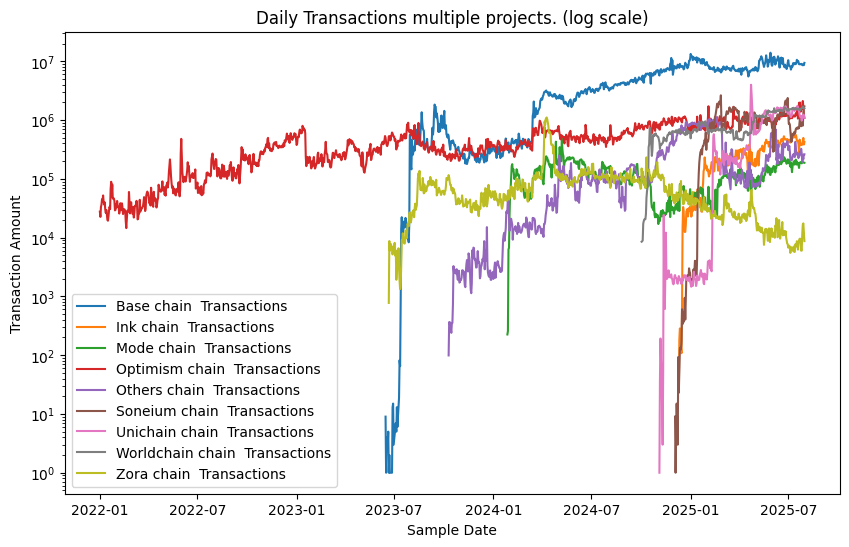

In [46]:
plt.figure(figsize=(10, 6))
for c in chains.chain.unique(): 
    plt.plot(chains[chains.chain == f"{c}"]['sample_date'], chains[chains.chain == f"{c}"]['amount'], label=f'{c} chain  Transactions')



# Adding labels and title
plt.xlabel('Sample Date')
plt.ylabel('Transaction Amount')
plt.title('Daily Transactions multiple projects. (log scale)')
plt.legend()

# Set y-axis to a logarithmic scale
plt.yscale('log')

# Display the plot
plt.show()

Notes: Different chains has data available from different dates

In [47]:
 chains.chain.unique()

array(['Base', 'Ink', 'Mode', 'Optimism', 'Others', 'Soneium', 'Unichain',
       'Worldchain', 'Zora'], dtype=object)

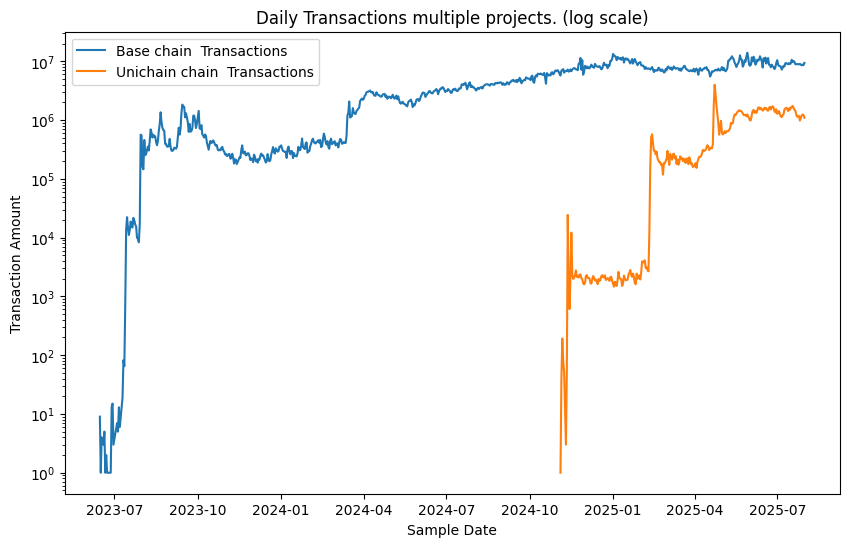

In [48]:


plt.figure(figsize=(10, 6))
for c in ["Base", "Unichain"]: 
    plt.plot(chains[chains.chain == f"{c}"]['sample_date'], chains[chains.chain == f"{c}"]['amount'], label=f'{c} chain  Transactions')



# Adding labels and title
plt.xlabel('Sample Date')
plt.ylabel('Transaction Amount')
plt.title('Daily Transactions multiple projects. (log scale)')
plt.legend()

# Set y-axis to a logarithmic scale
plt.yscale('log')

# Display the plot
plt.show()

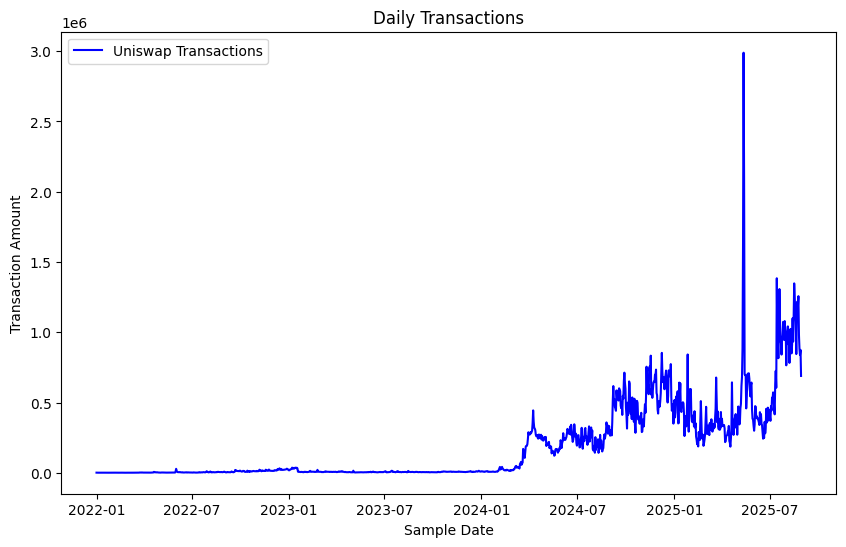

In [49]:
plt.figure(figsize=(10, 6))

plt.plot(uni['amount'], label='Uniswap Transactions', color='blue')

# Plotting the 'curve' DataFrame
# plt.plot(curve['sample_date'], curve['amount'], label='Curve Transactions', color='green')

# plt.plot(eth_price['timestamp'], eth_price['total_volumes'], label='Eth transacted Volume', color='red')

# plt.plot(eth_price['timestamp'], eth_price['market_caps'], label='Eth Market cap ', color='black')

# plt.plot(eth_price['timestamp'], eth_price['price'], label='Eth price ', color='orange')

# plt.plot(balancer['sample_date'], balancer['amount'], label='Balancer Transactions', color='yellow')
# Adding labels and title
plt.xlabel('Sample Date')
plt.ylabel('Transaction Amount')
plt.title('Daily Transactions')
plt.legend()

# # Set y-axis to a logarithmic scale
# plt.yscale()

# Display the plot
plt.show()

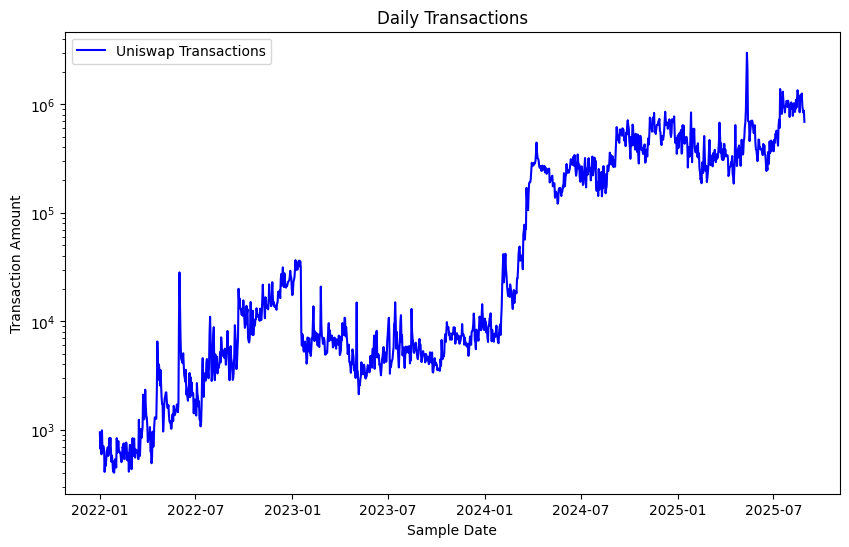

In [50]:
plt.figure(figsize=(10, 6))

plt.plot(uni['amount'], label='Uniswap Transactions', color='blue')

# Plotting the 'curve' DataFrame
# plt.plot(curve['sample_date'], curve['amount'], label='Curve Transactions', color='green')

# plt.plot(eth_price['timestamp'], eth_price['total_volumes'], label='Eth transacted Volume', color='red')

# plt.plot(eth_price['timestamp'], eth_price['market_caps'], label='Eth Market cap ', color='black')

# plt.plot(eth_price['timestamp'], eth_price['price'], label='Eth price ', color='orange')

# plt.plot(balancer['sample_date'], balancer['amount'], label='Balancer Transactions', color='yellow')
# Adding labels and title
plt.xlabel('Sample Date')
plt.ylabel('Transaction Amount')
plt.title('Daily Transactions')
plt.legend()

# Set y-axis to a logarithmic scale
plt.yscale('log')

# Display the plot
plt.show()

In [44]:
# plt.figure(figsize=(10, 6))

# plt.plot(uni['sample_date'], uni['amount'], label='Uniswap Transactions', color='blue')

# # Plotting the 'curve' DataFrame
# plt.plot(eth_trx['date'], eth_trx['value'], label='Eth transaction count', color='purple')

# plt.plot(curve['sample_date'], curve['amount'], label='Curve Transactions', color='green')

# plt.plot(eth_price['timestamp'], eth_price['total_volumes'], label='Eth transacted Volume', color='red')

# plt.plot(eth_price['timestamp'], eth_price['market_caps'], label='Eth Market cap ', color='black')

# plt.plot(eth_price['timestamp'], eth_price['price'], label='Eth price ', color='orange')

# plt.plot(balancer['sample_date'], balancer['amount'], label='Balancer Transactions', color='yellow')
# # Adding labels and title
# plt.xlabel('Sample Date')
# plt.ylabel('Transaction Amount')
# plt.title('Daily Transactions: Uniswap vs Curve')
# plt.legend()

# # Set y-axis to a logarithmic scale
# plt.yscale("log")

# # Display the plot
# plt.show()

#### notes 
- grabbing data from middle of 2023 to discart first years of low activity (find a better justification) 

In [ ]:
# eth_trx.sort_values(by= 'date', ascending= True, inplace= True)

# uni = uni.set_index('sample_date')
# curve = curve.set_index('sample_date')
# balancer = balancer.set_index('sample_date')
# chainBase = chains[chains.chain == "Base"].set_index('sample_date')
# chainOp = chains[chains.chain == "Optimism"].set_index('sample_date')
# chainUni = chains[chains.chain == "Unichain"].set_index('sample_date')
# chainSoneum = chains[chains.chain == "Soneium"].set_index('sample_date')
# eth_price = eth_price.set_index('timestamp')
# eth_trx = eth_trx.set_index('date')



# uni_trx = uni[['amount']].rename(columns={'amount': 'uni_trx'})
# curve_trx= curve[['amount']].rename(columns={'amount': 'curve_trx'})
# balancer_trx = balancer[['amount']].rename(columns={'amount': 'balancer_trx'})
# chainBase_trx = chainBase[['amount']].rename(columns={'amount': 'Base_trx'})
# chainOp_trx = chainOp[['amount']].rename(columns={'amount': 'Optmism_trx'})
# chainUni_trx = chainUni[['amount']].rename(columns={'amount': 'Unichain_trx'})
# chainSoneum_trx = chainSoneum[['amount']].rename(columns={'amount': 'Seneium_trx'})
# eth_info = eth_price.rename(columns={'total_volumes': 'eth_volume', "market_caps": "eth_market_caps", "price": "eth_prices" })
# eth_trx = eth_trx[['value']].rename(columns={'value': 'eth_trx'})
# merged_data = pd.concat([uni_trx, curve_trx, balancer_trx,chainBase_trx, chainOp_trx,chainUni_trx,chainSoneum_trx, eth_info, eth_trx['eth_trx']], axis=1)

# merge_data.to_parquet('raw_merged_data.parquet')


### Analysing sereies correlation to create the bes confounding set of variables


In [52]:
merge_data = pd.read_parquet('../data/raw_merged_data.parquet')

#### Raw series correalation with the treatment series - Pre/post treatment

Correlation with uni_trx:
                 Pre-Treatment  Post-Treatment  Whole Period
Series                                                      
curve_trx             0.320334       -0.045714      0.244454
balancer_trx         -0.122246       -0.150879     -0.137873
Base_trx              0.863331        0.370883      0.782236
Optmism_trx           0.788168        0.282233      0.771112
Unichain_trx         -0.613961        0.090963      0.137480
Seneium_trx          -0.610155       -0.164294     -0.192257
eth_volume            0.196771        0.526941      0.343355
eth_market_caps       0.512836        0.640624      0.560960
eth_prices            0.514266        0.640614      0.559752
eth_trx               0.413581        0.499619      0.651507


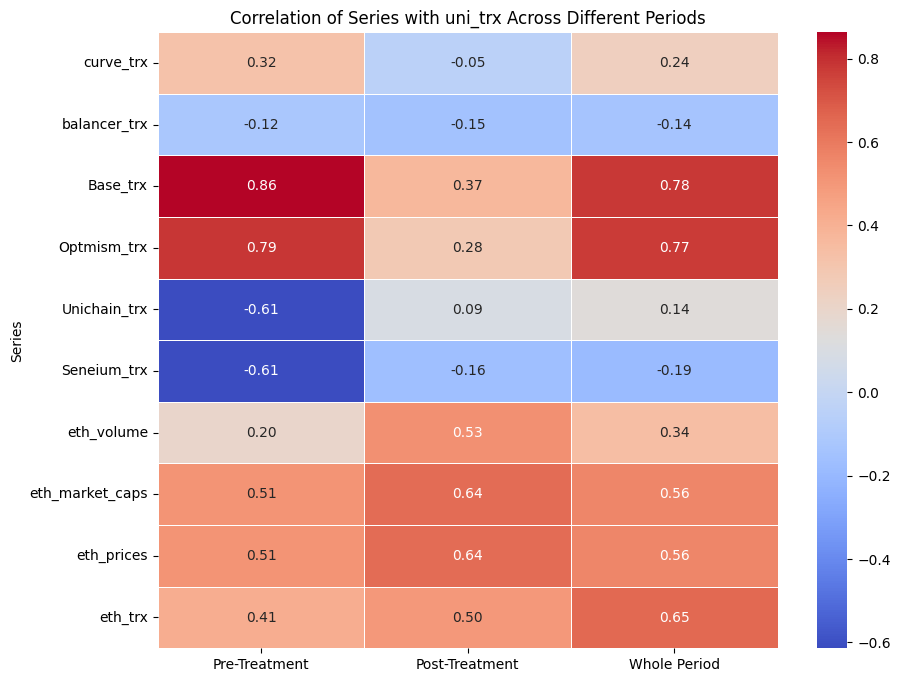

In [53]:

# Define the treatment date
treatment_date = pd.to_datetime('2025-04-01')

# Separate data into pre-treatment and post-treatment periods
pre_treatment_data = merged_data[merged_data.index < treatment_date]
post_treatment_data = merged_data[merged_data.index >= treatment_date]

# List of series to correlate with uni_trx
series_to_correlate = ['curve_trx', 'balancer_trx', 'Base_trx', 'Optmism_trx', 'Unichain_trx', 'Seneium_trx', 'eth_volume', 'eth_market_caps', 'eth_prices', 'eth_trx']

# Dictionary to store correlations
correlations = {'Series': [], 'Pre-Treatment': [], 'Post-Treatment': [], 'Whole Period': []}

for series_name in series_to_correlate:
    # Ensure both series exist in the data and drop NA values for correlation calculation
    temp_pre = pre_treatment_data[['uni_trx', series_name]].dropna()
    temp_post = post_treatment_data[['uni_trx', series_name]].dropna()
    temp_whole = merged_data[['uni_trx', series_name]].dropna()

    # Calculate correlation for each period
    pre_corr = temp_pre['uni_trx'].corr(temp_pre[series_name]) if not temp_pre.empty else np.nan
    post_corr = temp_post['uni_trx'].corr(temp_post[series_name]) if not temp_post.empty else np.nan
    whole_corr = temp_whole['uni_trx'].corr(temp_whole[series_name]) if not temp_whole.empty else np.nan

    # Store results
    correlations['Series'].append(series_name)
    correlations['Pre-Treatment'].append(pre_corr)
    correlations['Post-Treatment'].append(post_corr)
    correlations['Whole Period'].append(whole_corr)

# Create a DataFrame from the correlation results
correlation_df = pd.DataFrame(correlations)
correlation_df.set_index('Series', inplace=True)

print("Correlation with uni_trx:")
print(correlation_df)

# Visualize the correlations using a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_df, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Correlation of Series with uni_trx Across Different Periods')
plt.show()

#### Log trasnformed correlation analysis with the treatment series - Pre/post treatment 

Correlation with uni_trx (Log Transformed):
                 Pre-Treatment (Log)  Post-Treatment (Log)  Whole Period (Log)
Series                                                                        
curve_trx                   0.713196             -0.019275            0.704979
balancer_trx                0.196829             -0.180462            0.124608
Base_trx                    0.698932              0.419769            0.727714
Optmism_trx                 0.834332              0.369255            0.857814
Unichain_trx               -0.607144              0.325852           -0.114373
Seneium_trx                -0.675834             -0.212730           -0.268269
eth_volume                  0.157121              0.579463            0.370992
eth_market_caps             0.477555              0.771680            0.628986
eth_prices                  0.479113              0.771796            0.628315
eth_trx                     0.341485              0.600482            0.515037


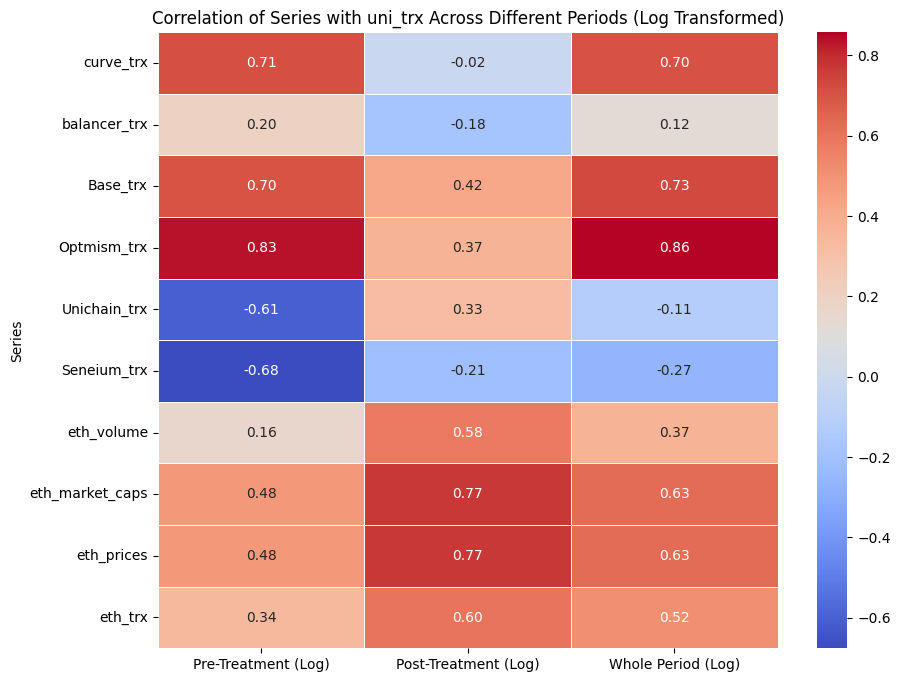

In [54]:

# Log transformation and correlation analysis

# Create a copy of merged_data to apply log transformation
merged_data_log = merged_data.copy()

# Apply log1p transformation to all relevant columns
for col in ['uni_trx'] + series_to_correlate:
    if col in merged_data_log.columns:
        merged_data_log[col] = np.log1p(merged_data_log[col])

# Separate log-transformed data into pre-treatment and post-treatment periods
pre_treatment_data_log = merged_data_log[merged_data_log.index < treatment_date]
post_treatment_data_log = merged_data_log[merged_data_log.index >= treatment_date]

# Dictionary to store log-transformed correlations
correlations_log = {'Series': [], 'Pre-Treatment (Log)': [], 'Post-Treatment (Log)': [], 'Whole Period (Log)': []}

for series_name in series_to_correlate:
    # Ensure both series exist in the data and drop NA values for correlation calculation
    temp_pre_log = pre_treatment_data_log[['uni_trx', series_name]].dropna()
    temp_post_log = post_treatment_data_log[['uni_trx', series_name]].dropna()
    temp_whole_log = merged_data_log[['uni_trx', series_name]].dropna()

    # Calculate correlation for each period using log-transformed data
    pre_corr_log = temp_pre_log['uni_trx'].corr(temp_pre_log[series_name]) if not temp_pre_log.empty else np.nan
    post_corr_log = temp_post_log['uni_trx'].corr(temp_post_log[series_name]) if not temp_post_log.empty else np.nan
    whole_corr_log = temp_whole_log['uni_trx'].corr(temp_whole_log[series_name]) if not temp_whole_log.empty else np.nan

    # Store results
    correlations_log['Series'].append(series_name)
    correlations_log['Pre-Treatment (Log)'].append(pre_corr_log)
    correlations_log['Post-Treatment (Log)'].append(post_corr_log)
    correlations_log['Whole Period (Log)'].append(whole_corr_log)

# Create a DataFrame from the log-transformed correlation results
correlation_df_log = pd.DataFrame(correlations_log)
correlation_df_log.set_index('Series', inplace=True)

print("Correlation with uni_trx (Log Transformed):")
print(correlation_df_log)

# Visualize the log-transformed correlations using a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_df_log, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Correlation of Series with uni_trx Across Different Periods (Log Transformed)')
plt.show()



#### Correlation analysis between all the variables

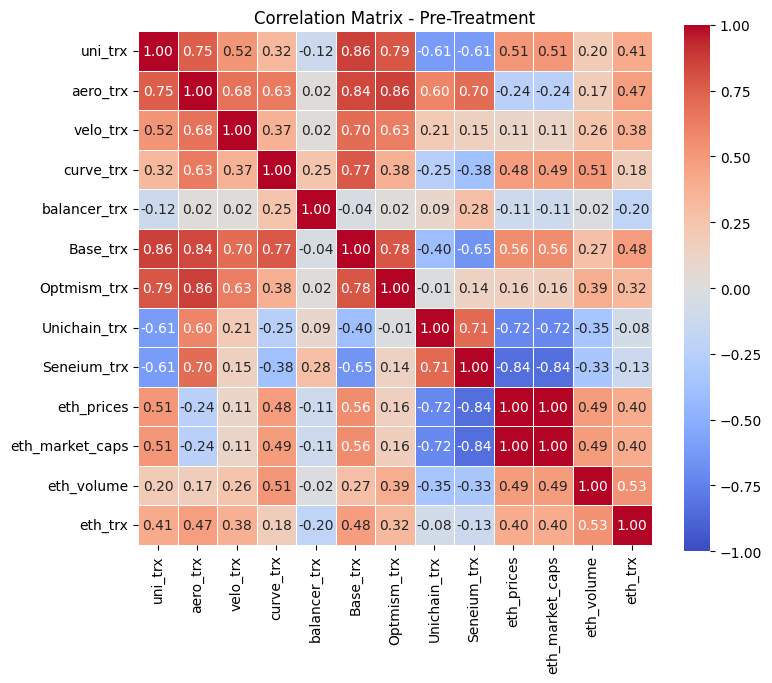

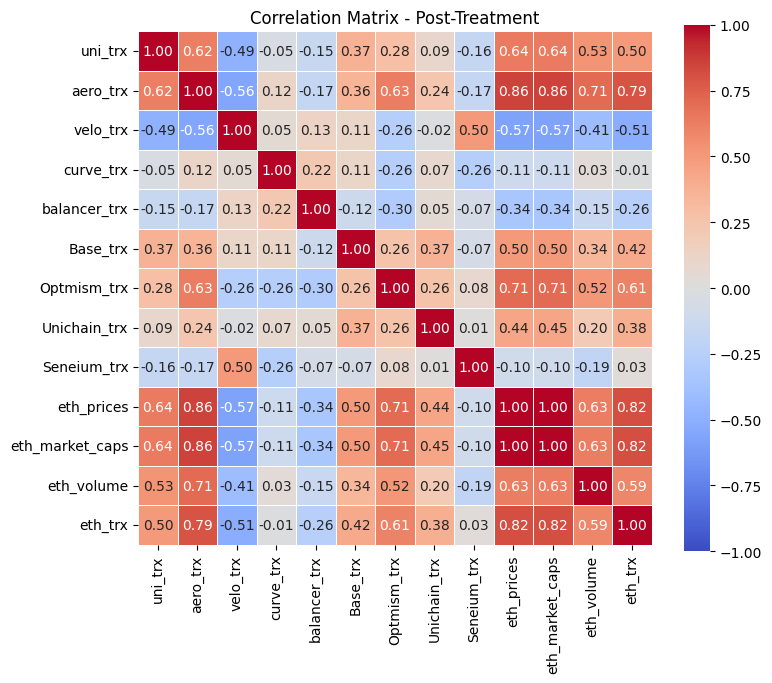

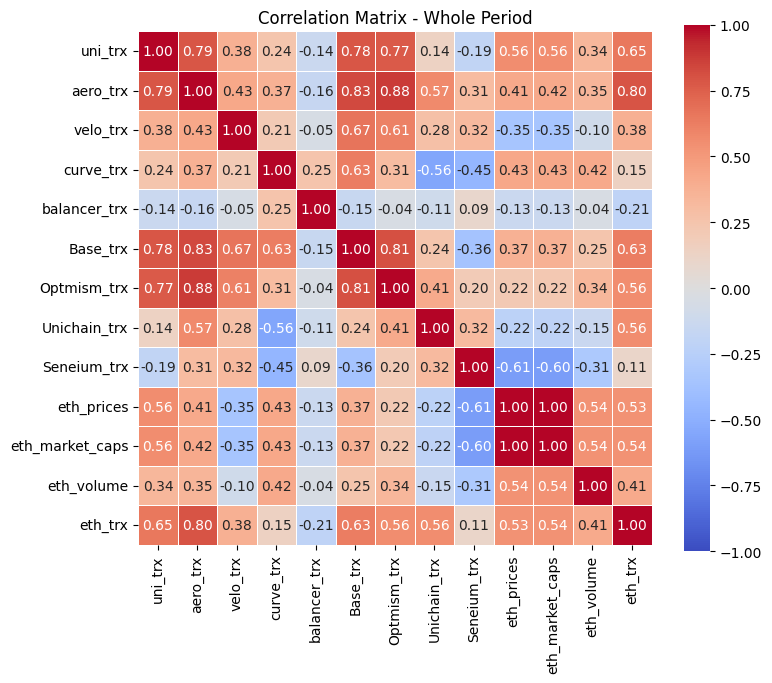

Pre-Treatment Correlations:
                  uni_trx  aero_trx  velo_trx  curve_trx  balancer_trx  \
uni_trx          1.000000  0.751206  0.517179   0.320334     -0.122246   
aero_trx         0.751206  1.000000  0.677661   0.633283      0.017967   
velo_trx         0.517179  0.677661  1.000000   0.367331      0.016693   
curve_trx        0.320334  0.633283  0.367331   1.000000      0.252923   
balancer_trx    -0.122246  0.017967  0.016693   0.252923      1.000000   
Base_trx         0.863331  0.843340  0.699036   0.774530     -0.041720   
Optmism_trx      0.788168  0.860489  0.630623   0.377070      0.019588   
Unichain_trx    -0.613961  0.596371  0.207292  -0.253192      0.089963   
Seneium_trx     -0.610155  0.700083  0.151529  -0.379901      0.280104   
eth_prices       0.514266 -0.236545  0.109279   0.483931     -0.113306   
eth_market_caps  0.512836 -0.235331  0.111329   0.485486     -0.113674   
eth_volume       0.196771  0.172992  0.255558   0.510074     -0.016487   
eth_trx   

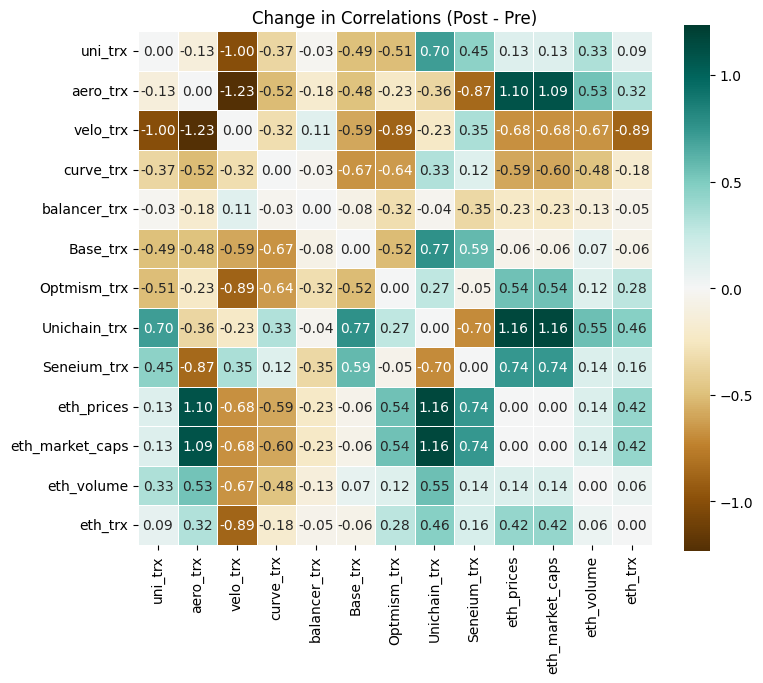

In [55]:

if not isinstance(merged_data.index, pd.DatetimeIndex):
    merged_data = merged_data.copy()
    merged_data.index = pd.to_datetime(merged_data.index)

# Split periods
pre_treatment_data = merged_data[merged_data.index < treatment_date]
post_treatment_data = merged_data[merged_data.index >= treatment_date]

# Use all numeric columns (so every variable is included)
numeric_cols = merged_data.select_dtypes(include=[np.number]).columns.tolist()

# Compute correlation matrices
corr_pre = pre_treatment_data[numeric_cols].corr()
corr_post = post_treatment_data[numeric_cols].corr()
corr_whole = merged_data[numeric_cols].corr()

# Helper: heatmap with smart annotation for large matrices
def plot_corr_heatmap(corr_df, title, annotate_threshold=15):
    annot = corr_df.shape[0] <= annotate_threshold  # avoid clutter on large matrices
    size = max(8, 0.55 * corr_df.shape[0])         # scale figure with number of vars
    plt.figure(figsize=(size, size))
    sns.heatmap(
        corr_df,
        vmin=-1, vmax=1, center=0,
        cmap='coolwarm',
        annot=annot, fmt=".2f" if annot else "",
        square=True, linewidths=0.5,
        cbar_kws={'shrink': 0.75}
    )
    plt.title(title)
    plt.tight_layout()
    plt.show()

# Plot per-period heatmaps
plot_corr_heatmap(corr_pre,  'Correlation Matrix - Pre-Treatment')
plot_corr_heatmap(corr_post, 'Correlation Matrix - Post-Treatment')
plot_corr_heatmap(corr_whole,'Correlation Matrix - Whole Period')

# Optional: print to console (and/or export to CSV)
print("Pre-Treatment Correlations:")
print(corr_pre)
print("\nPost-Treatment Correlations:")
print(corr_post)
print("\nWhole Period Correlations:")
print(corr_whole)

# Optional: visualize how correlations changed from pre to post
delta_corr = corr_post - corr_pre
v = np.nanmax(np.abs(delta_corr.values))
plt.figure(figsize=(max(8, 0.55 * delta_corr.shape[0]), max(8, 0.55 * delta_corr.shape[0])))
sns.heatmap(
    delta_corr,
    vmin=-v, vmax=v, center=0,
    cmap='BrBG',
    annot=delta_corr.shape[0] <= 15, fmt=".2f" if delta_corr.shape[0] <= 15 else "",
    square=True, linewidths=0.5,
    cbar_kws={'shrink': 0.75}
)
plt.title('Change in Correlations (Post - Pre)')
plt.tight_layout()
plt.show()

## checking rolling correlations 

In [59]:
cf_timeseries = ["curve_trx", "Base_trx", "Optmism_trx", "eth_trx"]
analysis_period_start = "2023-01-01"


In [60]:
curve_trx.index

DatetimeIndex(['2022-01-17', '2022-01-18', '2022-01-19', '2022-01-20',
               '2022-01-21', '2022-01-22', '2022-01-23', '2022-01-24',
               '2022-01-25', '2022-01-26',
               ...
               '2025-07-22', '2025-07-23', '2025-07-24', '2025-07-25',
               '2025-07-26', '2025-07-27', '2025-07-28', '2025-07-29',
               '2025-07-30', '2025-07-31'],
              dtype='datetime64[ns]', name='sample_date', length=1290, freq=None)

In [61]:
merged_data[merged_data.index >= pd.to_datetime(analysis_period_start)]

,uni_trx,aero_trx,velo_trx,curve_trx,balancer_trx,Base_trx,Optmism_trx,Unichain_trx,Seneium_trx,eth_prices,eth_market_caps,eth_volume,eth_trx
2023-01-01,17409.0,NaN,22981.0,815.0,9256.0,<NA>,376651.0,<NA>,<NA>,NaN,NaN,NaN,742785.0
2023-01-02,18374.0,NaN,23793.0,848.0,6041.0,<NA>,396881.0,<NA>,<NA>,NaN,NaN,NaN,920276.0
2023-01-03,23026.0,NaN,26942.0,1010.0,5720.0,<NA>,504789.0,<NA>,<NA>,NaN,NaN,NaN,948116.0
2023-01-04,24032.0,NaN,35924.0,945.0,5939.0,<NA>,525197.0,<NA>,<NA>,NaN,NaN,NaN,1046389.0
2023-01-05,25374.0,NaN,35043.0,4180.0,5194.0,<NA>,511981.0,<NA>,<NA>,NaN,NaN,NaN,1142818.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-08-30,NaN,NaN,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,4364.358521,5.268309e+11,3.800684e+10,1483368.0
2025-08-31,NaN,NaN,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,4373.360358,5.275395e+11,1.919918e+10,1577808.0
2025-09-01,NaN,NaN,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,4388.931465,5.297401e+11,2.226980e+10,1691908.0
2025-09-02,NaN,NaN,NaN,<NA>,<NA>,<NA>,<NA>,<NA>,<NA>,4303.202223,5.195348e+11,3.172520e+10,1721464.0


In [62]:

# Define window sizes
windows = [7, 30, 60]

# Create a dictionary to store rolling correlations
rolling_correlations = {}
analysis_data = merged_data[merged_data.index >= pd.to_datetime(analysis_period_start)]
# Calculate rolling correlations for each column and window size
for col in cf_timeseries:
    if col in analysis_data.columns:
        rolling_correlations[col] = {}
        for window in windows:
            # Calculate rolling correlation between uni_trx and the current column
            clean_data = analysis_data[["uni_trx" , col]].dropna()
            rolling_corr = clean_data['uni_trx'].rolling(window=window).corr(clean_data[col])
            rolling_correlations[col][f'corr_{window}d'] = rolling_corr

print("Rolling correlations calculated for:")
for col in rolling_correlations.keys():
    print(f"  - {col}: {list(rolling_correlations[col].keys())}")


Rolling correlations calculated for:
  - curve_trx: ['corr_7d', 'corr_30d', 'corr_60d']
  - Base_trx: ['corr_7d', 'corr_30d', 'corr_60d']
  - Optmism_trx: ['corr_7d', 'corr_30d', 'corr_60d']
  - eth_trx: ['corr_7d', 'corr_30d', 'corr_60d']


In [63]:
# Create a comprehensive DataFrame for plotting
# This will contain all rolling correlations with their dates

# Initialize the DataFrame with the date index
rolling_corr_df = pd.DataFrame(index=clean_data.index)

# Add rolling correlations for each column and window
for col in rolling_correlations.keys():
    for window_name, corr_series in rolling_correlations[col].items():
        column_name = f"{col}_{window_name}"
        rolling_corr_df[column_name] = corr_series

# Display basic info about the DataFrame
print("Rolling Correlation DataFrame Info:")
print(f"Shape: {rolling_corr_df.shape}")
print(f"Date range: {rolling_corr_df.index.min()} to {rolling_corr_df.index.max()}")
print("\nColumns:")
for col in rolling_corr_df.columns:
    non_null_count = rolling_corr_df[col].notna().sum()
    print(f"  {col}: {non_null_count} non-null values")

# Show first few rows
print("\nFirst 10 rows:")
rolling_corr_df.head(10)


Rolling Correlation DataFrame Info:
Shape: (971, 12)
Date range: 2023-01-01 00:00:00 to 2025-08-29 00:00:00

Columns:
  curve_trx_corr_7d: 936 non-null values
  curve_trx_corr_30d: 913 non-null values
  curve_trx_corr_60d: 883 non-null values
  Base_trx_corr_7d: 762 non-null values
  Base_trx_corr_30d: 739 non-null values
  Base_trx_corr_60d: 709 non-null values
  Optmism_trx_corr_7d: 936 non-null values
  Optmism_trx_corr_30d: 913 non-null values
  Optmism_trx_corr_60d: 883 non-null values
  eth_trx_corr_7d: 965 non-null values
  eth_trx_corr_30d: 942 non-null values
  eth_trx_corr_60d: 912 non-null values

First 10 rows:


,curve_trx_corr_7d,curve_trx_corr_30d,curve_trx_corr_60d,Base_trx_corr_7d,Base_trx_corr_30d,Base_trx_corr_60d,Optmism_trx_corr_7d,Optmism_trx_corr_30d,Optmism_trx_corr_60d,eth_trx_corr_7d,eth_trx_corr_30d,eth_trx_corr_60d
2023-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-01-07,0.902340,NaN,NaN,NaN,NaN,NaN,0.981283,NaN,NaN,0.447306,NaN,NaN
2023-01-08,0.873734,NaN,NaN,NaN,NaN,NaN,0.977804,NaN,NaN,0.213352,NaN,NaN
2023-01-09,0.614842,NaN,NaN,NaN,NaN,NaN,0.966541,NaN,NaN,-0.032408,NaN,NaN
2023-01-10,0.463752,NaN,NaN,NaN,NaN,NaN,0.953111,NaN,NaN,-0.422980,NaN,NaN


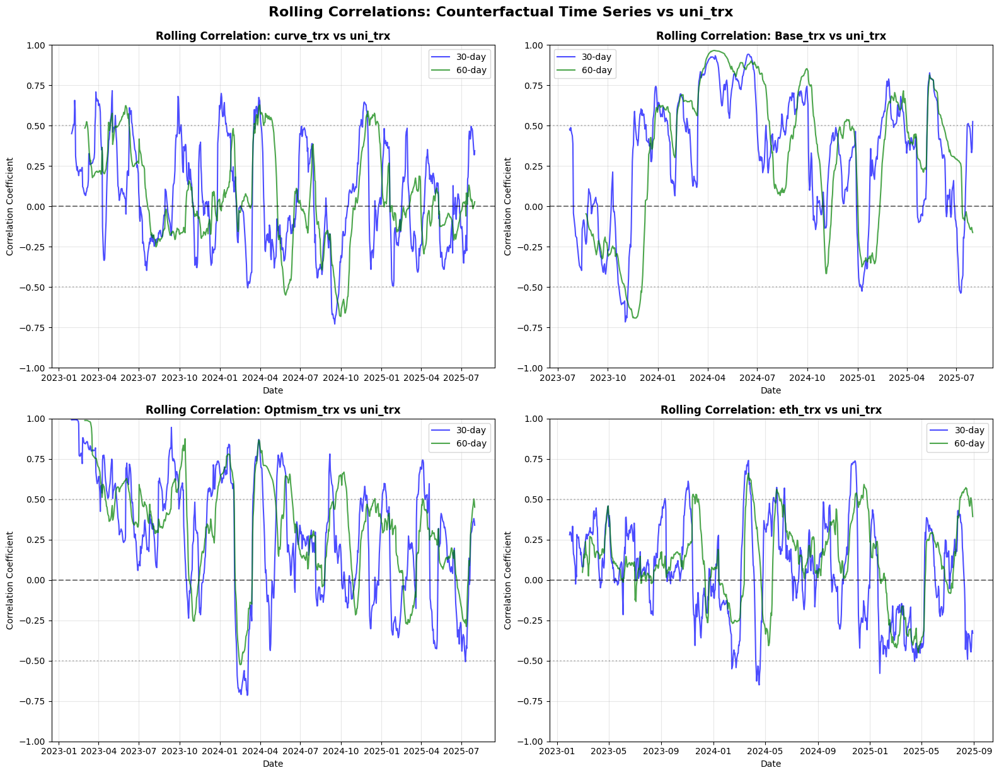

In [64]:
# Create visualization for rolling correlations
# Plot each column's rolling correlations with different window sizes

fig, axes = plt.subplots(2, 2, figsize=(16, 12))
axes = axes.flatten()

# Colors for different window sizes
colors = {'corr_7d': 'red', 'corr_30d': 'blue', 'corr_60d': 'green'}
window_labels = {'corr_7d': '7-day', 'corr_30d': '30-day', 'corr_60d': '60-day'}

for i, col in enumerate(cf_timeseries):
    if col in rolling_correlations.keys():
        ax = axes[i]
        
        # Plot each window size for this column
        for window_name in ['corr_30d', 'corr_60d']:
            if window_name in rolling_correlations[col]:
                corr_series = rolling_correlations[col][window_name]
                ax.plot(corr_series.index, corr_series.values, 
                       color=colors[window_name], 
                       label=window_labels[window_name],
                       alpha=0.7, linewidth=1.5)
        
        # Customize the subplot
        ax.set_title(f'Rolling Correlation: {col} vs uni_trx', fontsize=12, fontweight='bold')
        ax.set_xlabel('Date')
        ax.set_ylabel('Correlation Coefficient')
        ax.grid(True, alpha=0.3)
        ax.legend()
        ax.axhline(y=0, color='black', linestyle='--', alpha=0.5)
        ax.axhline(y=0.5, color='gray', linestyle=':', alpha=0.5)
        ax.axhline(y=-0.5, color='gray', linestyle=':', alpha=0.5)
        
        # Set y-axis limits
        ax.set_ylim(-1, 1)

# Remove empty subplot if we have fewer than 4 columns
if len(cf_timeseries) < 4:
    axes[-1].remove()

plt.tight_layout()
plt.suptitle('Rolling Correlations: Counterfactual Time Series vs uni_trx', 
             fontsize=16, fontweight='bold', y=1.02)
plt.show()


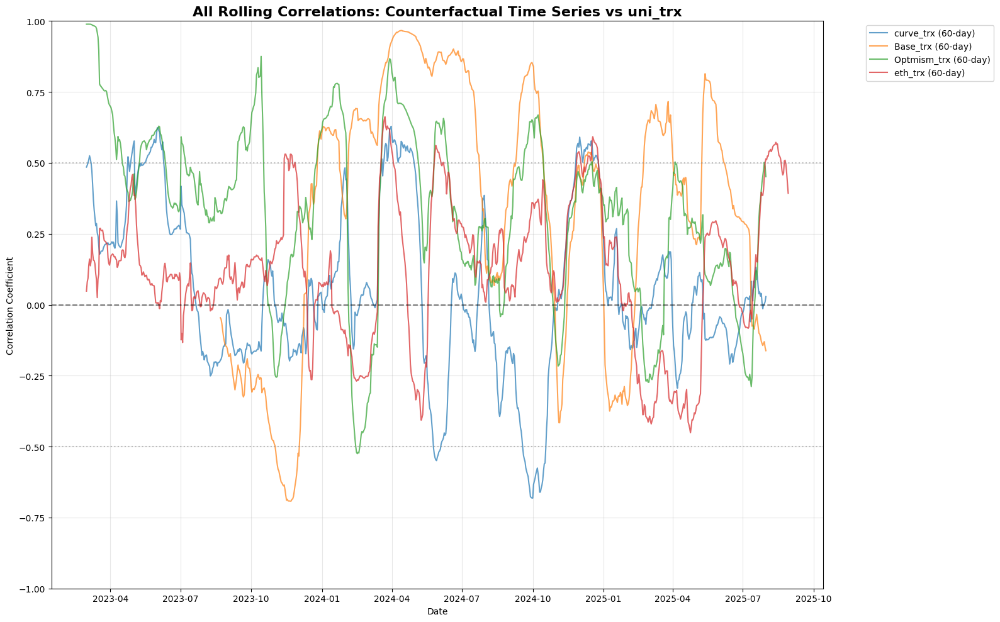

In [65]:
# Alternative visualization: All correlations in one plot for easier comparison
plt.figure(figsize=(16, 10))

# Plot all rolling correlations in one figure
for col in cf_timeseries:
    if col in rolling_correlations.keys():
        for window_name in [ 'corr_60d']:
            if window_name in rolling_correlations[col]:
                corr_series = rolling_correlations[col][window_name]
                label = f"{col} ({window_labels[window_name]})"
                plt.plot(corr_series.index, corr_series.values, 
                        label=label, alpha=0.7, linewidth=1.5)

plt.title('All Rolling Correlations: Counterfactual Time Series vs uni_trx', 
          fontsize=16, fontweight='bold')
plt.xlabel('Date')
plt.ylabel('Correlation Coefficient')
plt.grid(True, alpha=0.3)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.axhline(y=0, color='black', linestyle='--', alpha=0.5)
plt.axhline(y=0.5, color='gray', linestyle=':', alpha=0.5)
plt.axhline(y=-0.5, color='gray', linestyle=':', alpha=0.5)
plt.ylim(-1, 1)
plt.tight_layout()
plt.show()


In [66]:
# Summary statistics for rolling correlations
print("Rolling Correlation Summary Statistics")
print("=" * 50)

for col in cf_timeseries:
    if col in rolling_correlations.keys():
        print(f"\n{col.upper()}:")
        print("-" * 30)
        for window_name in ['corr_7d', 'corr_30d', 'corr_60d']:
            if window_name in rolling_correlations[col]:
                corr_series = rolling_correlations[col][window_name]
                # Remove NaN values for statistics
                clean_corr = corr_series.dropna()
                if len(clean_corr) > 0:
                    print(f"{window_labels[window_name]}:")
                    print(f"  Mean: {clean_corr.mean():.4f}")
                    print(f"  Std:  {clean_corr.std():.4f}")
                    print(f"  Min:  {clean_corr.min():.4f}")
                    print(f"  Max:  {clean_corr.max():.4f}")
                    print(f"  Median: {clean_corr.median():.4f}")
                else:
                    print(f"{window_labels[window_name]}: No valid data")


Rolling Correlation Summary Statistics

CURVE_TRX:
------------------------------
7-day:
  Mean: 0.0470
  Std:  0.4640
  Min:  -0.9458
  Max:  0.9503
  Median: 0.0450
30-day:
  Mean: 0.0503
  Std:  0.3182
  Min:  -0.7288
  Max:  0.7167
  Median: 0.0245
60-day:
  Mean: 0.0516
  Std:  0.2925
  Min:  -0.6813
  Max:  0.6288
  Median: 0.0132

BASE_TRX:
------------------------------
7-day:
  Mean: 0.2872
  Std:  0.4662
  Min:  -0.8757
  Max:  0.9751
  Median: 0.3561
30-day:
  Mean: 0.3172
  Std:  0.3923
  Min:  -0.7160
  Max:  0.9429
  Median: 0.3965
60-day:
  Mean: 0.3384
  Std:  0.4519
  Min:  -0.6921
  Max:  0.9662
  Median: 0.4348

OPTMISM_TRX:
------------------------------
7-day:
  Mean: 0.2790
  Std:  0.5147
  Min:  -0.9347
  Max:  0.9960
  Median: 0.3835
30-day:
  Mean: 0.2752
  Std:  0.3837
  Min:  -0.7147
  Max:  0.9931
  Median: 0.2849
60-day:
  Mean: 0.3253
  Std:  0.3065
  Min:  -0.5249
  Max:  0.9888
  Median: 0.3524

ETH_TRX:
------------------------------
7-day:
  Mean: 0.03

### Notes 
- check base + optmism capcacity of prediction vs all the variables to predict like the last 2 or 3 months before the recevein gof the funds 

# TFP- Causalimpact implementation


In [2]:
merged_data = pd.read_parquet('../data/raw_merged_data.parquet')

In [3]:
!pip install vega vega-datasets vega-lite altair

  Using cached vega-4.1.0-py3-none-any.whl.metadata (1.6 kB)
  Using cached vega_datasets-0.9.0-py3-none-any.whl.metadata (5.5 kB)


ERROR: Could not find a version that satisfies the requirement vega-lite (from versions: none)
ERROR: No matching distribution found for vega-lite


In [4]:
import sys
import os
print(f"Python executable: {sys.executable}")
print(f"Virtual env active: {'causal_impact_env' in sys.executable}")

# Test the import
import causalimpact
print("✅ CausalImpact imported successfully!")

# Check TensorFlow is working
import tensorflow as tf
print(f"TensorFlow version: {tf.__version__}")

Python executable: C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Scripts\python.exe
Virtual env active: True
✅ CausalImpact imported successfully!
TensorFlow version: 2.20.0


In [5]:
import sys
print("path:", getattr(causalimpact, "__file__", None))
print("version:", getattr(causalimpact, "__version__", "n/a"))
print("has fit_causalimpact:", hasattr(causalimpact, "fit_causalimpact"))

path: C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\__init__.py
version: 0.2.0
has fit_causalimpact: True


In [6]:
### Key Dates
start_date = "2023-08-01"
treatment_date = "2025-04-05"
day_after_treatment = "2025-04-06"
end_date = "2025-07-31"

In [7]:
# ### some missing values on the series
# merged_data_filled = merged_data.copy()
# merged_data_filled = merged_data_filled[(merged_data_filled.index >= start_date) & (merged_data_filled.index <= end_date)]
# merged_data_filled['Base_trx'] = merged_data_filled['Base_trx'].interpolate(
#     method='time',  # Time-aware interpolation
#     limit_direction='both'
# )
# merged_data_filled['uni_trx'] = merged_data_filled['uni_trx'].interpolate(
#     method='time',  # Time-aware interpolation
#     limit_direction='both'
# )

In [8]:
# merged_data_log = merged_data_filled.copy()
# for column in merged_data_log.columns:
#     merged_data_log[column] = np.log10(merged_data_log[column])

In [9]:
# merged_data_log.to_parquet('../data/merge_data_log.parquet')
merged_data_log = pd.read_parquet('../data/merge_data_log.parquet')
merged_data_log = merged_data_log.apply(pd.to_numeric, errors="coerce").astype("float64")

In [10]:
### treatement series come first than counterfactual series
merged_data_log = merged_data_log[[ "uni_trx" ,"Base_trx", "Optmism_trx"]]

In [12]:
%%time 
impact = causalimpact.fit_causalimpact(
    data=merged_data_log,
    pre_period=(start_date, treatment_date),
    post_period=(day_after_treatment, end_date))

causalimpact.plot(impact, kind = 'matplotlib' )

CPU times: total: 3.14 s
Wall time: 1.63 s


alt.FacetChart(...)

In [13]:
print(causalimpact.summary(impact, output_format='summary'))


Posterior Inference {CausalImpact}
                          Average            Cumulative
Actual                    5.7                665.3
Prediction (s.d.)         5.6 (0.19)         655.1 (21.67)
95% CI                    [5.2, 5.9]         [614.2, 695.9]

Absolute effect (s.d.)    0.1 (0.19)         10.2 (21.67)
95% CI                    [-0.3, 0.4]        [-30.5, 51.2]

Relative effect (s.d.)    1.7% (3.4%)        1.7% (3.0%)
95% CI                    [-4.4%, 8.3%]      [-4.4%, 8.3%]

Posterior tail-area probability p: 0.333
Posterior prob. of a causal effect: 66.70%

For more details run the command: summary(impact, output_format="report")


C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]


In [14]:
print(causalimpact.summary(impact, output_format='report'));


Analysis report {CausalImpact}


During the post-intervention period, the response variable had
an average value of approx. 5.7. In the absence of an
intervention, we would have expected an average response of 5.6.
The 95% interval of this counterfactual prediction is [5.2, 5.9].
Subtracting this prediction from the observed response yields
an estimate of the causal effect the intervention had on the
response variable. This effect is 0.1 with a 95% interval of
[-0.3, 0.4]. For a discussion of the significance of this effect,
see below.


Summing up the individual data points during the post-intervention
period (which can only sometimes be meaningfully interpreted), the
response variable had an overall value of 665.3.
Had the intervention not taken place, we would have expected
a sum of 655.1. The 95% interval of this prediction is [614.2, 695.9].


The above results are given in terms of absolute numbers. In relative
terms, the response variable showed an increase of +1.7%. The 95%
in

C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]


## Analysis of quality of the counter factual data and sample size

### Counter Factual Series Error Analysis - R2 and RMSE 

In [15]:
## error on the predicted period 
import numpy as np

# Extract observed and predicted for the pre-period only
y_pre = impact.series.loc[start_date:treatment_date, "observed"].values
yhat_pre = impact.series.loc[start_date:treatment_date, "posterior_mean"].values

# Residuals
resid = y_pre - yhat_pre

# RMSE and R²
rmse = np.sqrt(np.mean(resid**2))
ss_res = np.sum(resid**2)
ss_tot = np.sum((y_pre - y_pre.mean())**2)
r2 = 1 - ss_res / ss_tot

print("Pre-period RMSE:", rmse)
print("Pre-period R²:", r2)

Pre-period RMSE: 0.07074145371283634
Pre-period R²: 0.9922941425754148


In [16]:
import numpy as np

# Extract observed and predicted for the pre-period only
y_post = impact.series.loc[treatment_date: end_date, "observed"].values
yhat_post = impact.series.loc[treatment_date:end_date, "posterior_mean"].values

# Residuals
resid = y_post - yhat_post

# RMSE and R²
rmse = np.sqrt(np.mean(resid**2))
ss_res = np.sum(resid**2)
ss_tot = np.sum((y_post - y_post.mean())**2)
r2 = 1 - ss_res / ss_tot

print("Pre-period RMSE:", rmse)
print("Pre-period R²:", r2)

Pre-period RMSE: 0.22296494612631323
Pre-period R²: -0.01424211191811886


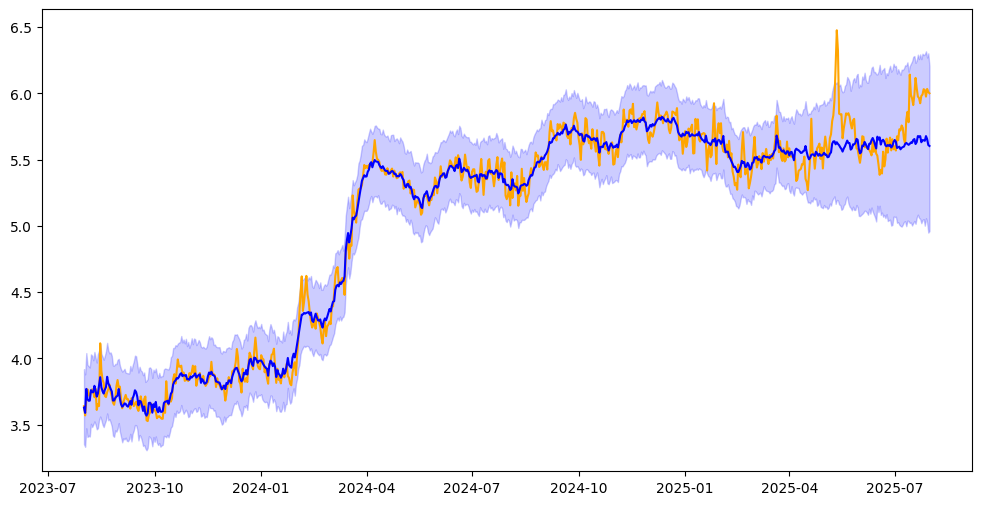

In [17]:
import matplotlib.pyplot as plt

# Extract series from the fitted object
df_plot = impact.series

plt.figure(figsize=(12,6))
plt.plot(df_plot.index, df_plot["observed"], color="orange", label="Observed")
plt.plot(df_plot.index, df_plot["posterior_mean"], color="blue", label="Posterior mean")
plt.fill_between(
    df_plot.index,
    df_plot["posterior_lower"],
    df_plot["posterior_upper"],
    color="blue",
    alpha=0.2,
    label="95% credible interval"
)


In [18]:
import numpy as np

# Get posterior draws for regression weights
weights = np.asarray(impact.posterior_samples.weights)  # shape: (n_draws, n_predictors)

# Split intercept and covariate betas
intercept_draws = weights[:, 0]
beta_draws = weights[:, 1:]  # assume col 0 is intercept, then your covariates

# Name your covariates in the same order used to fit the model
covariate_names = ["Base_trx", "Optimism_trx"]
assert beta_draws.shape[1] == len(covariate_names), (
    f"Expected {len(covariate_names)} betas, got {beta_draws.shape[1]}"
)

# Summaries
for i, name in enumerate(covariate_names):
    b = beta_draws[:, i]
    mean = b.mean()
    lower, upper = np.quantile(b, [0.025, 0.975])
    p_pos = (b > 0).mean()
    p_neg = (b < 0).mean()
    print(f"{name}: mean={mean:.4f}, 95% CI=({lower:.4f},{upper:.4f}), "
          f"P(>0)={p_pos:.3f}, P(<0)={p_neg:.3f}")

Base_trx: mean=0.0721, 95% CI=(0.0353,0.1125), P(>0)=1.000, P(<0)=0.000
Optimism_trx: mean=0.2974, 95% CI=(0.0558,0.4829), P(>0)=1.000, P(<0)=0.000


## Running the analysis with more variables and checking predictive power

In [19]:
start_date = "2023-08-01"
treatment_date = "2025-04-05"
day_after_treatment = "2025-04-06"
end_date = "2025-07-31"

merged_data_log = pd.read_parquet('../data/merge_data_log.parquet')
merged_data_log = merged_data_log.apply(pd.to_numeric, errors="coerce").astype("float64")
merged_data_log = merged_data_log[[ "uni_trx" ,'eth_trx', "Base_trx", "Optmism_trx"]]


In [20]:
merged_data_log.isna().sum()

uni_trx        0
eth_trx        0
Base_trx       0
Optmism_trx    0
dtype: int64

In [21]:

impact = causalimpact.fit_causalimpact(
    data=merged_data_log,
    pre_period=(start_date, treatment_date),
    post_period=(day_after_treatment, end_date))

causalimpact.plot(impact)



alt.FacetChart(...)

In [22]:
print(causalimpact.summary(impact, output_format='summary'))
print(causalimpact.summary(impact, output_format='report'));


Posterior Inference {CausalImpact}
                          Average            Cumulative
Actual                    5.7                665.3
Prediction (s.d.)         5.6 (0.18)         655.1 (20.83)
95% CI                    [5.3, 6.0]         [615.7, 697.9]

Absolute effect (s.d.)    0.1 (0.18)         10.3 (20.83)
95% CI                    [-0.3, 0.4]        [-32.5, 49.6]

Relative effect (s.d.)    1.7% (3.2%)        1.7% (3.0%)
95% CI                    [-4.7%, 8.1%]      [-4.7%, 8.1%]

Posterior tail-area probability p: 0.324
Posterior prob. of a causal effect: 67.59%

For more details run the command: summary(impact, output_format="report")

Analysis report {CausalImpact}


During the post-intervention period, the response variable had
an average value of approx. 5.7. In the absence of an
intervention, we would have expected an average response of 5.6.
The 95% interval of this counterfactual prediction is [5.3, 6.0].
Subtracting this prediction from the observed response yields

C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]
C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]


#### Analysis of quality of the counter factual data and sample size

In [23]:

### R2 and RMSE 
## error on the predicted period 
import numpy as np

# Extract observed and predicted for the pre-period only
y_pre = impact.series.loc[start_date:treatment_date, "observed"].values
yhat_pre = impact.series.loc[start_date:treatment_date, "posterior_mean"].values

# Residuals
resid = y_pre - yhat_pre

# RMSE and R²
rmse = np.sqrt(np.mean(resid**2))
ss_res = np.sum(resid**2)
ss_tot = np.sum((y_pre - y_pre.mean())**2)
r2 = 1 - ss_res / ss_tot

print("Pre-period RMSE:", rmse)
print("Pre-period R²:", r2)


Pre-period RMSE: 0.07122969083625724
Pre-period R²: 0.9921874083037837


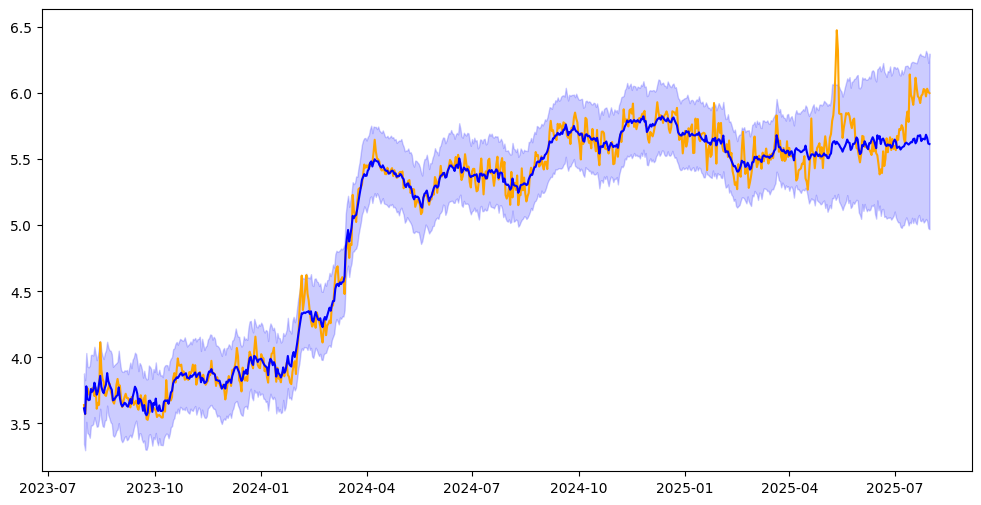

In [24]:
import matplotlib.pyplot as plt

# Extract series from the fitted object
df_plot = impact.series

plt.figure(figsize=(12,6))
plt.plot(df_plot.index, df_plot["observed"], color="orange", label="Observed")
plt.plot(df_plot.index, df_plot["posterior_mean"], color="blue", label="Posterior mean")
plt.fill_between(
    df_plot.index,
    df_plot["posterior_lower"],
    df_plot["posterior_upper"],
    color="blue",
    alpha=0.2,
    label="95% credible interval"
)



In [25]:
import numpy as np

# Get posterior draws for regression weights
weights = np.asarray(impact.posterior_samples.weights)  # shape: (n_draws, n_predictors)

# Split intercept and covariate betas
intercept_draws = weights[:, 0]
beta_draws = weights[:, 1:]  # assume col 0 is intercept, then your covariates

# Name your covariates in the same order used to fit the model
covariate_names = ['eth_trx', "Base_trx", "Optmism_trx"]
assert beta_draws.shape[1] == len(covariate_names), (
    f"Expected {len(covariate_names)} betas, got {beta_draws.shape[1]}"
)

# Summaries
for i, name in enumerate(covariate_names):
    b = beta_draws[:, i]
    mean = b.mean()
    lower, upper = np.quantile(b, [0.025, 0.975])
    p_pos = (b > 0).mean()
    p_neg = (b < 0).mean()
    print(f"{name}: mean={mean:.4f}, 95% CI=({lower:.4f},{upper:.4f}), "
          f"P(>0)={p_pos:.3f}, P(<0)={p_neg:.3f}")

eth_trx: mean=0.2633, 95% CI=(0.1891,0.3395), P(>0)=1.000, P(<0)=0.000
Base_trx: mean=0.0711, 95% CI=(0.0000,0.1131), P(>0)=0.967, P(<0)=0.000
Optmism_trx: mean=-0.0002, 95% CI=(0.0000,0.0000), P(>0)=0.013, P(<0)=0.024


# Data transformations tests to stabilize variance and eliminate Heteroscadadic


## Box cox transformation Analysis

In [2]:
merged_data = pd.read_parquet('../data/raw_merged_data.parquet')
merged_data= merged_data.apply(pd.to_numeric, errors="coerce").astype("float64")

### Key Dates
start_date = "2023-08-01"
treatment_date = "2025-04-05"
day_after_treatment = "2025-04-06"
end_date = "2025-07-31"

In [3]:
### some missing values on the series
merged_data_filled = merged_data.copy()
merged_data_filled = merged_data_filled[(merged_data_filled.index >= start_date) & (merged_data_filled.index <= end_date)]
merged_data_filled['Base_trx'] = merged_data_filled['Base_trx'].interpolate(
    method='time',  # Time-aware interpolation
    limit_direction='both'
)
merged_data_filled['uni_trx'] = merged_data_filled['uni_trx'].interpolate(
    method='time',  # Time-aware interpolation
    limit_direction='both'
)


In [4]:
boxcox= merged_data_filled[[ "uni_trx" ,'eth_trx', "Base_trx", "Optmism_trx"]].copy()

In [5]:
boxcox.head()

,uni_trx,eth_trx,Base_trx,Optmism_trx
2023-08-01,4361.0,1068108.0,158837.0,675865.0
2023-08-02,3717.0,1042149.0,145005.0,547768.0
2023-08-03,4792.0,1049539.0,458089.0,660791.0
2023-08-04,5849.0,1075359.0,253225.0,645983.0
2023-08-05,5385.0,1124372.0,264869.0,559862.0


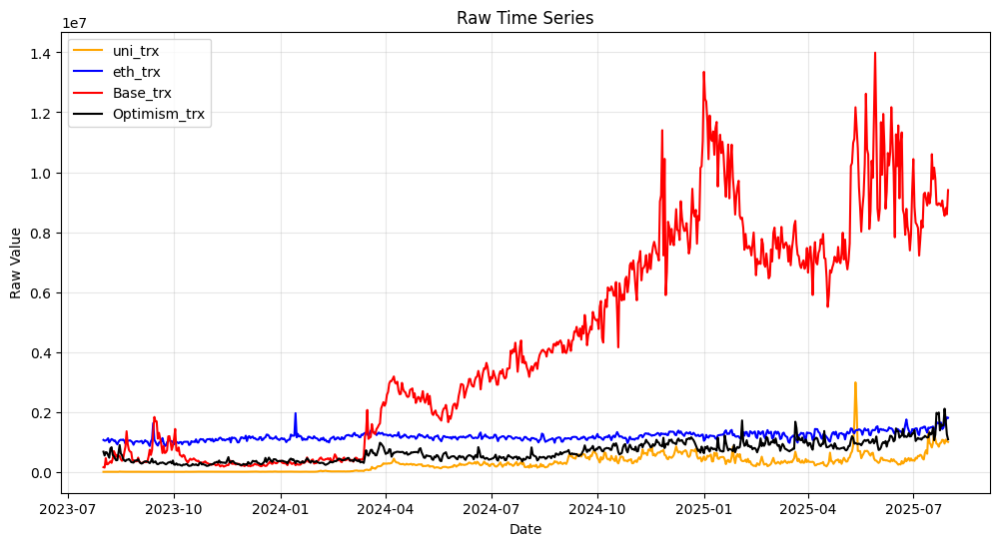

In [6]:
plt.figure(figsize=(12,6))

# Plot each series against the time index
plt.plot(boxcox.index, boxcox["uni_trx"], color="orange", label="uni_trx")
plt.plot(boxcox.index, boxcox["eth_trx"], color="blue", label="eth_trx")
plt.plot(boxcox.index, boxcox["Base_trx"], color="red", label="Base_trx")
plt.plot(boxcox.index, boxcox["Optmism_trx"], color="black", label="Optimism_trx")

plt.xlabel('Date')
plt.ylabel('Raw Value')
plt.title('Raw Time Series')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

In [7]:
boxcox.describe()

,uni_trx,eth_trx,Base_trx,Optmism_trx
count,7.310000e+02,7.310000e+02,7.310000e+02,7.310000e+02
mean,2.850269e+05,1.189337e+06,4.431786e+06,6.663850e+05
std,2.776148e+05,1.414366e+05,3.612457e+06,3.194046e+05
min,3.370000e+03,8.635030e+05,1.450050e+05,2.012000e+05
25%,1.240850e+04,1.097061e+06,5.265480e+05,3.943300e+05
50%,2.641620e+05,1.166560e+06,3.667072e+06,6.311830e+05
75%,4.216400e+05,1.264812e+06,7.512554e+06,8.786855e+05
max,2.988701e+06,1.961144e+06,1.399030e+07,2.109142e+06


##### Box-cox Alpha analysis

Finding optimal lambda for uni_trx...


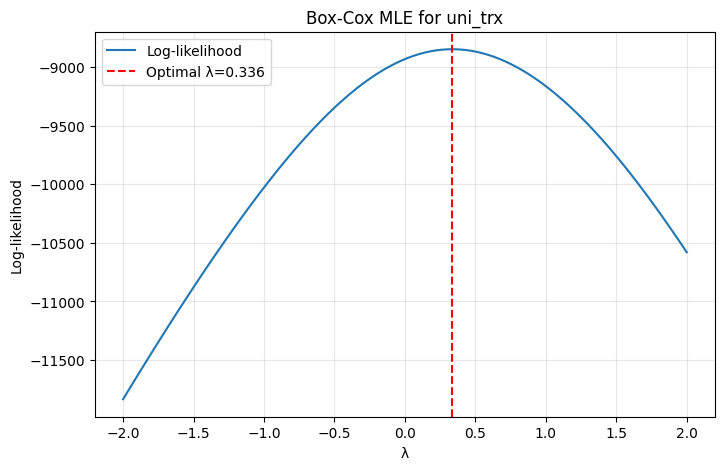

Finding optimal lambda for eth_trx...


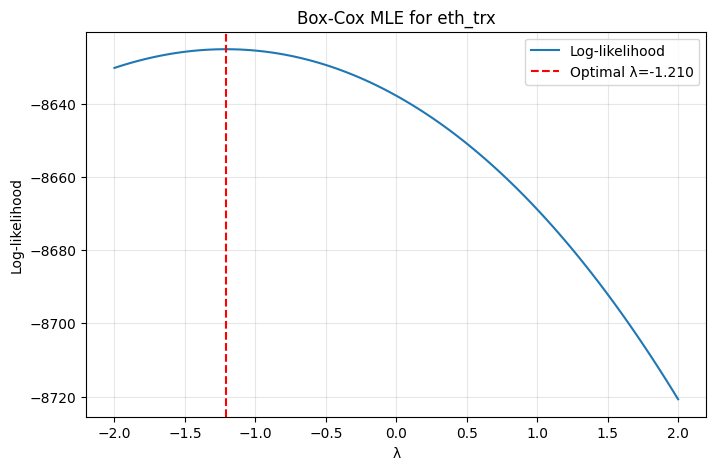

Finding optimal lambda for Base_trx...


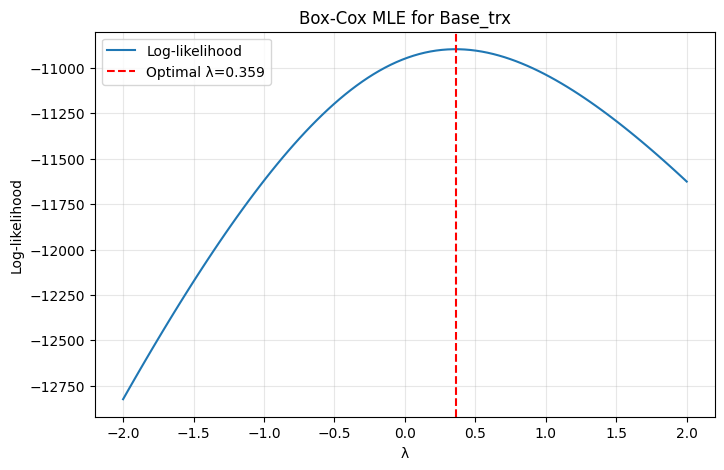

Finding optimal lambda for Optmism_trx...


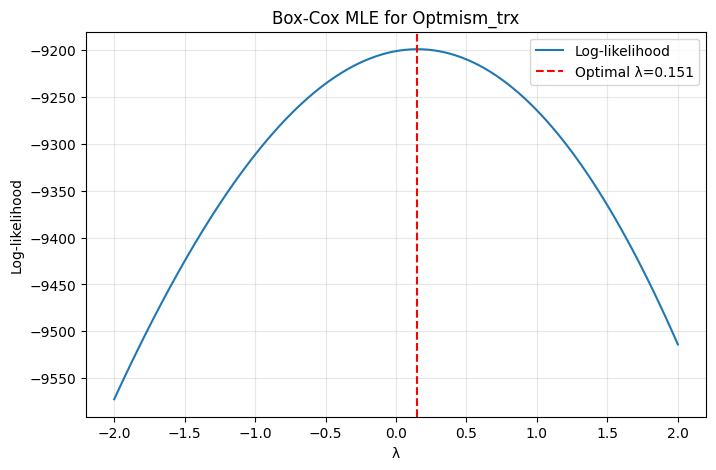


Optimal Lambda Values for Each Column:
             Optimal Lambda
uni_trx            0.336086
eth_trx           -1.210202
Base_trx           0.359359
Optmism_trx        0.151493


In [8]:
# Box-Cox transformation 

from scipy import stats


boxcox = boxcox[(boxcox.index >= start_date) & (boxcox.index <= end_date)]

# Function to find optimal lambda for Box-Cox transformation
def find_optimal_lambda(data_series, column_name):
    """Find the optimal lambda parameter for Box-Cox transformation with likelihood profile."""
    data = data_series.copy()
    if (data <= 0).any():
        print(f"Warning: {column_name} contains zeros or negative values. Adding offset...")
        offset = abs(data.min()) + 1
        data = data + offset

    # 1. Optimal lambda (MLE)
    fitted_lambda = stats.boxcox_normmax(data, method='mle')

    # 2. Evaluate log-likelihood across a range
    lambdas = np.linspace(-2, 2, 100)
    llf = [stats.boxcox_llf(lmb, data) for lmb in lambdas]

    # Plot profile likelihood
    plt.figure(figsize=(8, 5))
    plt.plot(lambdas, llf, label='Log-likelihood')
    plt.axvline(fitted_lambda, color='red', linestyle='--', label=f'Optimal λ={fitted_lambda:.3f}')
    plt.xlabel('λ')
    plt.ylabel('Log-likelihood')
    plt.title(f'Box-Cox MLE for {column_name}')
    plt.legend()
    plt.grid(alpha=0.3)
    plt.show()

    return fitted_lambda

# Find optimal lambda for each column and store results
lambda_values = {}
columns_to_transform = [ "uni_trx" ,'eth_trx', "Base_trx", "Optmism_trx"]

for col in columns_to_transform:
    if col in boxcox.columns:
        print(f"Finding optimal lambda for {col}...")
        lambda_values[col] = find_optimal_lambda(merged_data_filled[col], col)

# Display all optimal lambda values
lambda_df = pd.DataFrame.from_dict(lambda_values, orient='index', columns=['Optimal Lambda'])
print("\nOptimal Lambda Values for Each Column:")
print(lambda_df)

In [9]:
lambda_values

{'uni_trx': np.float64(0.33608596393306545),
 'eth_trx': np.float64(-1.210202178408908),
 'Base_trx': np.float64(0.3593586118721767),
 'Optmism_trx': np.float64(0.15149330446887727)}

In [10]:
# Apply Box-Cox transformation to the data
def apply_boxcox_transform(data, lambda_values):
    """
    Apply Box-Cox transformation to each column in the dataframe
    using the provided lambda values.
    
    Parameters:
    -----------
    data : pandas.DataFrame
        The dataframe to transform
    lambda_values : dict
        Dictionary mapping column names to their optimal lambda values
    
    Returns:
    --------
    pandas.DataFrame
        Transformed dataframe
    dict
        Dictionary of offsets applied to make data positive (for inverse transform)
    """
    transformed_data = pd.DataFrame(index=data.index)
    offsets = {}
    
    for col, lambda_val in lambda_values.items():
        if col in data.columns:
            series = data[col].copy()
            
            # Check if we need to add an offset (Box-Cox requires positive values)
            offset = 0
            if (series <= 0).any():
                offset = abs(series.min()) + 1
                series = series + offset
                offsets[col] = offset
            
            # Apply Box-Cox transformation
            if abs(lambda_val) < 1e-10:  # lambda ≈ 0
                transformed_data[col] = np.log(series)
            else:
                transformed_data[col] = (series**lambda_val - 1) / lambda_val
                
            # Add a note about the transformation
            print(f"Transformed {col} with lambda={lambda_val:.4f}" + 
                  (f" and offset={offset}" if offset > 0 else ""))
    
    return transformed_data, offsets



# Save the transformed data
# merged_data_boxcox.to_parquet('../data/merged_data_boxcox.parquet')


Transformed uni_trx with lambda=0.3361
Transformed eth_trx with lambda=-1.2102
Transformed Base_trx with lambda=0.3594
Transformed Optmism_trx with lambda=0.1515


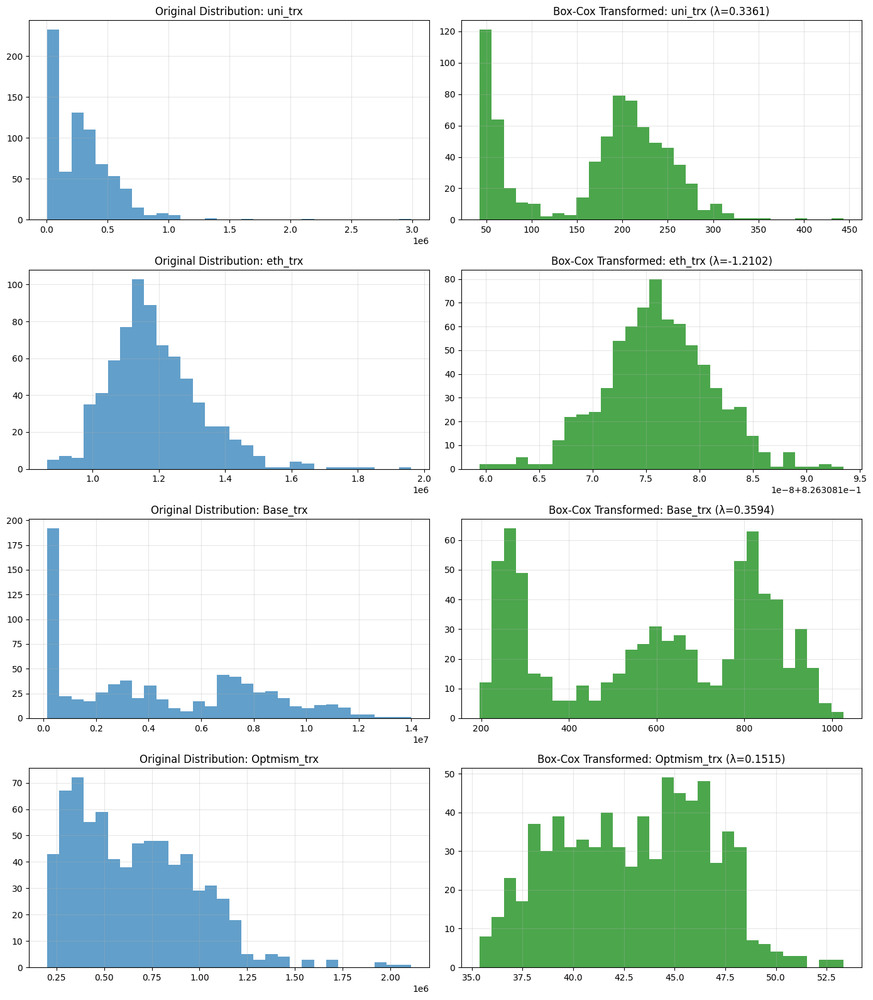

In [11]:
# Apply the transformation
merged_data_boxcox, offsets = apply_boxcox_transform(boxcox, lambda_values)

# Compare original and transformed distributions for a few key columns
key_columns = [ "uni_trx" ,'eth_trx', "Base_trx", "Optmism_trx"]
fig, axes = plt.subplots(len(key_columns), 2, figsize=(14, 4*len(key_columns)))

for i, col in enumerate(key_columns):
    if col in boxcox.columns and col in merged_data_boxcox.columns:
        # Original data histogram
        axes[i, 0].hist(boxcox[col], bins=30, alpha=0.7)
        axes[i, 0].set_title(f'Original Distribution: {col}')
        axes[i, 0].grid(alpha=0.3)
        
        # Transformed data histogram
        axes[i, 1].hist(merged_data_boxcox[col], bins=30, alpha=0.7, color='green')
        axes[i, 1].set_title(f'Box-Cox Transformed: {col} (λ={lambda_values[col]:.4f})')
        axes[i, 1].grid(alpha=0.3)

plt.tight_layout()
plt.show()

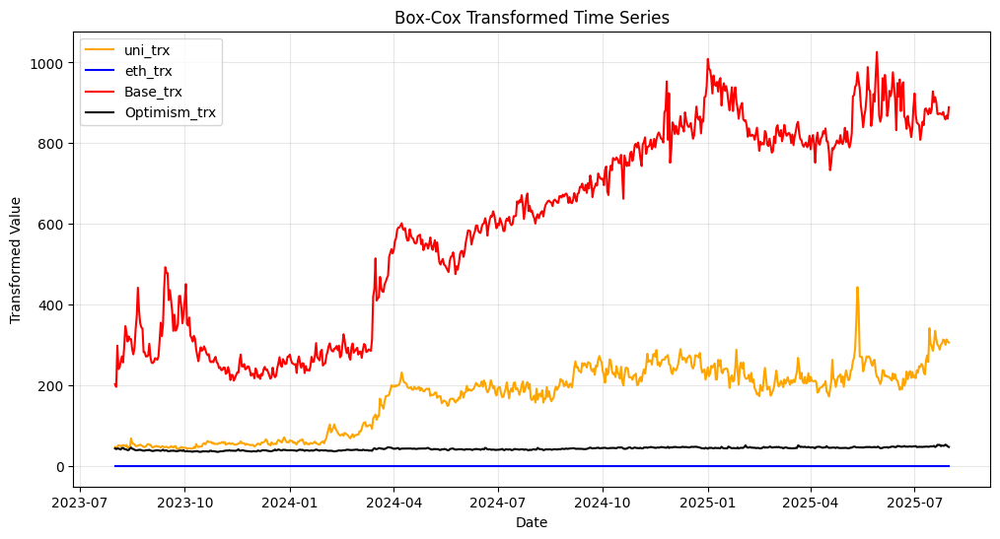

In [12]:
merged_data_boxcox

plt.figure(figsize=(12,6))

# Plot each series against the time index
plt.plot(merged_data_boxcox.index, merged_data_boxcox["uni_trx"], color="orange", label="uni_trx")
plt.plot(merged_data_boxcox.index, merged_data_boxcox["eth_trx"], color="blue", label="eth_trx")
plt.plot(merged_data_boxcox.index, merged_data_boxcox["Base_trx"], color="red", label="Base_trx")
plt.plot(merged_data_boxcox.index, merged_data_boxcox["Optmism_trx"], color="black", label="Optimism_trx")

plt.xlabel('Date')
plt.ylabel('Transformed Value')
plt.title('Box-Cox Transformed Time Series')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

In [13]:
# Running Causal Impact analysis with Box-Cox transformed data

# Define analysis periods
start_date = "2023-08-01"
treatment_date = "2025-04-05"
day_after_treatment = "2025-04-06"
end_date = "2025-07-31"

# Select columns for analysis
analysis_columns = ['uni_trx', 'Base_trx', 'Optmism_trx', 'eth_trx']
boxcox_data_for_analysis = merged_data_boxcox[analysis_columns].copy()

# Run causal impact analysis on Box-Cox transformed data
impact_boxcox = causalimpact.fit_causalimpact(
    data=boxcox_data_for_analysis,
    pre_period=(start_date, treatment_date),
    post_period=(day_after_treatment, end_date))


In [14]:
# Plot the results
causalimpact.plot(impact_boxcox)


alt.FacetChart(...)

In [15]:
# Print summary
print(causalimpact.summary(impact_boxcox, output_format='summary'))


Posterior Inference {CausalImpact}
                          Average            Cumulative
Actual                    243.3              28468.5
Prediction (s.d.)         225.0 (22.06)      26322.5 (2580.96)
95% CI                    [181.6, 267.7]     [21243.3, 31317.5]

Absolute effect (s.d.)    18.3 (22.06)       2145.9 (2580.96)
95% CI                    [-24.4, 61.8]      [-2849.0, 7225.2]

Relative effect (s.d.)    9.2% (11.0%)       9.2% (11.0%)
95% CI                    [-9.1%, 34.0%]     [-9.1%, 34.0%]

Posterior tail-area probability p: 0.199
Posterior prob. of a causal effect: 80.13%

For more details run the command: summary(impact, output_format="report")


C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]


In [16]:
print(causalimpact.summary(impact_boxcox, output_format='report'))


Analysis report {CausalImpact}


During the post-intervention period, the response variable had
an average value of approx. 243.3. In the absence of an
intervention, we would have expected an average response of 225.0.
The 95% interval of this counterfactual prediction is [181.6, 267.7].
Subtracting this prediction from the observed response yields
an estimate of the causal effect the intervention had on the
response variable. This effect is 18.3 with a 95% interval of
[-24.4, 61.8]. For a discussion of the significance of this effect,
see below.


Summing up the individual data points during the post-intervention
period (which can only sometimes be meaningfully interpreted), the
response variable had an overall value of 28468.5.
Had the intervention not taken place, we would have expected
a sum of 26322.5. The 95% interval of this prediction is [21243.3, 31317.5].


The above results are given in terms of absolute numbers. In relative
terms, the response variable showed an increase o

C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]


In [17]:
# Calculate model quality metrics
y_pre = impact_boxcox.series.loc[start_date:treatment_date, "observed"].values
yhat_pre = impact_boxcox.series.loc[start_date:treatment_date, "posterior_mean"].values

# Residuals
resid = y_pre - yhat_pre

# RMSE and R²
rmse = np.sqrt(np.mean(resid**2))
ss_res = np.sum(resid**2)
ss_tot = np.sum((y_pre - y_pre.mean())**2)
r2 = 1 - ss_res / ss_tot

print("\nBox-Cox Transformed Model Quality:")
print(f"Pre-period RMSE: {rmse:.6f}")
print(f"Pre-period R²: {r2:.6f}")


Box-Cox Transformed Model Quality:
Pre-period RMSE: 9.467980
Pre-period R²: 0.985412


### Checking residuals

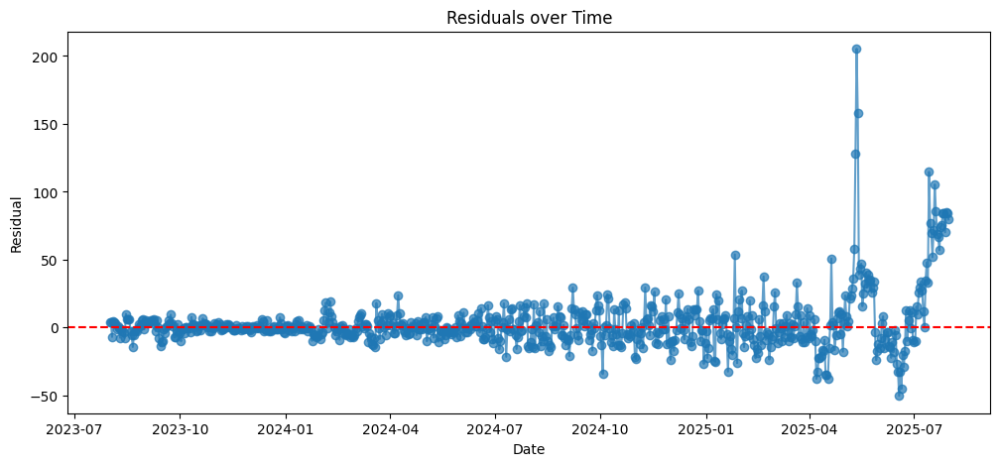

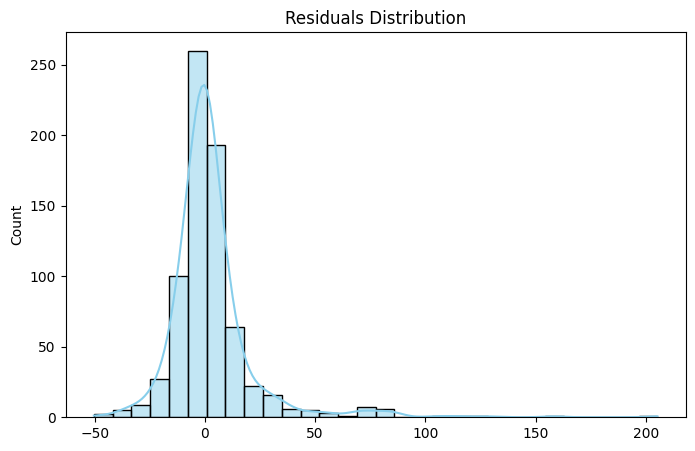

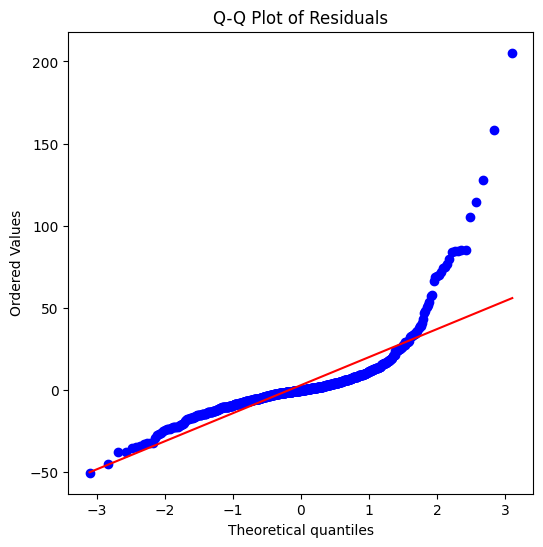

<Figure size 1000x400 with 0 Axes>

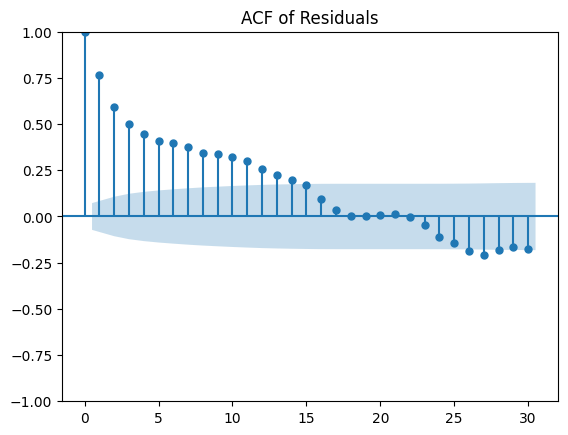

Shapiro-Wilk test: statistic=0.7018, p-value=0.0000
Durbin-Watson statistic: 0.4431 (≈2 means no autocorrelation)


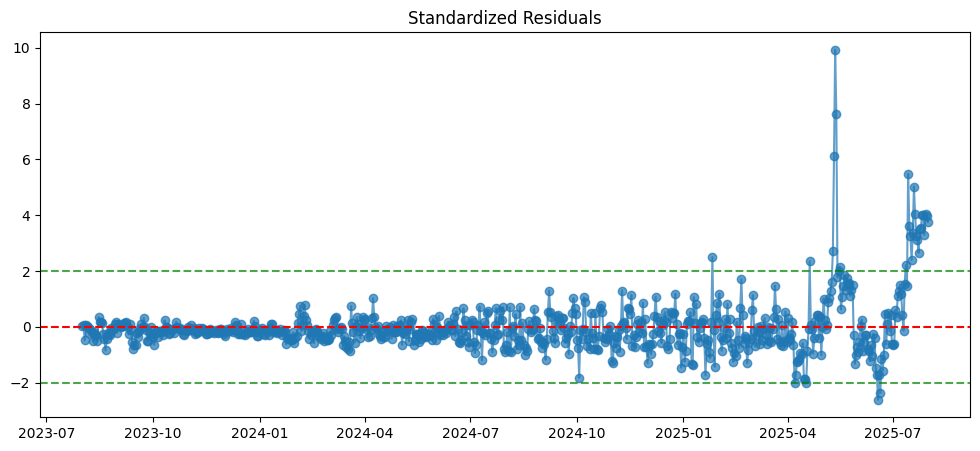

In [18]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf
from scipy import stats
import numpy as np
from statsmodels.stats.stattools import durbin_watson

# -----------------------------
# 1. Extract residuals
# -----------------------------
y_obs = impact_boxcox.series.loc[start_date:end_date, "observed"]
y_pred = impact_boxcox.series.loc[start_date:end_date, "posterior_mean"]

residuals = y_obs - y_pred

# -----------------------------
# 2. Residual plot
# -----------------------------
plt.figure(figsize=(12, 5))
plt.plot(residuals, marker='o', linestyle='-', alpha=0.7)
plt.axhline(0, color='red', linestyle='--')
plt.title("Residuals over Time")
plt.xlabel("Date")
plt.ylabel("Residual") 
plt.show()

# -----------------------------
# 3. Histogram and KDE
# -----------------------------
plt.figure(figsize=(8, 5))
sns.histplot(residuals, kde=True, bins=30, color='skyblue')
plt.title("Residuals Distribution")
plt.show()

# -----------------------------
# 4. Q-Q Plot for normality
# -----------------------------
plt.figure(figsize=(6, 6))
stats.probplot(residuals, dist="norm", plot=plt)
plt.title("Q-Q Plot of Residuals")
plt.show()

# -----------------------------
# 5. Autocorrelation check
# -----------------------------
plt.figure(figsize=(10, 4))
plot_acf(residuals, lags=30)
plt.title("ACF of Residuals")
plt.show()

# -----------------------------
# 6. Statistical tests
# -----------------------------
shapiro_test = stats.shapiro(residuals)
print(f"Shapiro-Wilk test: statistic={shapiro_test.statistic:.4f}, p-value={shapiro_test.pvalue:.4f}")

dw_stat = durbin_watson(residuals)
print(f"Durbin-Watson statistic: {dw_stat:.4f} (≈2 means no autocorrelation)")

# -----------------------------
# 7. Optional: standardized residuals
# -----------------------------
residuals_std = (residuals - residuals.mean()) / residuals.std()
plt.figure(figsize=(12, 5))
plt.plot(residuals_std, marker='o', linestyle='-', alpha=0.7)
plt.axhline(0, color='red', linestyle='--')
plt.axhline(2, color='green', linestyle='--', alpha=0.7)
plt.axhline(-2, color='green', linestyle='--', alpha=0.7)
plt.title("Standardized Residuals")
plt.show()


=== Residual Analysis: Pre-Intervention ===


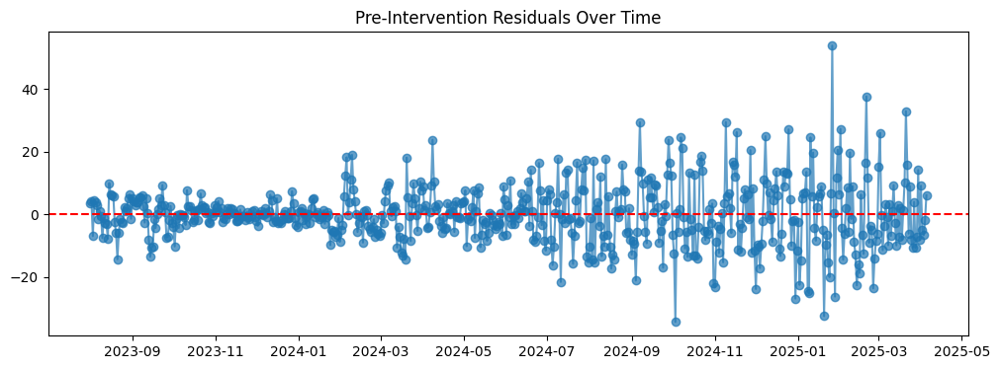

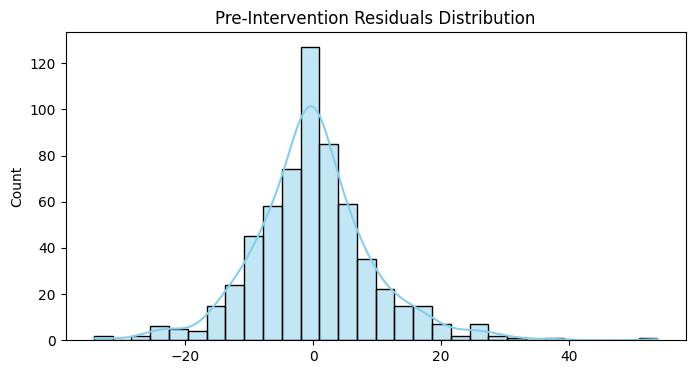

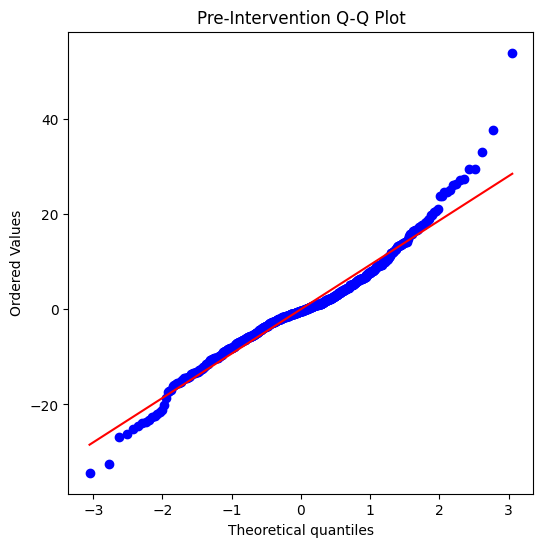

<Figure size 1000x400 with 0 Axes>

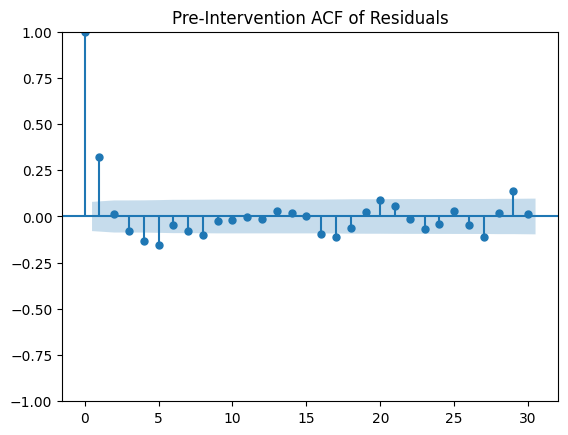

Shapiro-Wilk: stat=0.9621, p-value=0.0000
Durbin-Watson: 1.3558 (≈2 means no autocorrelation)


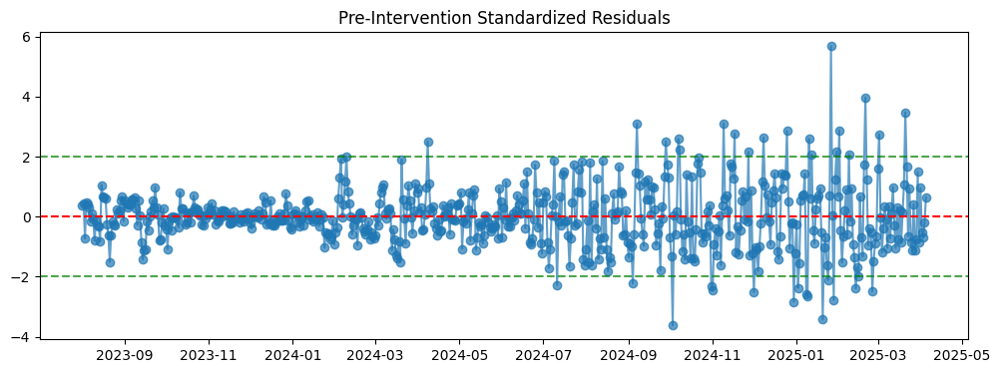

=== Residual Analysis: Post-Intervention ===


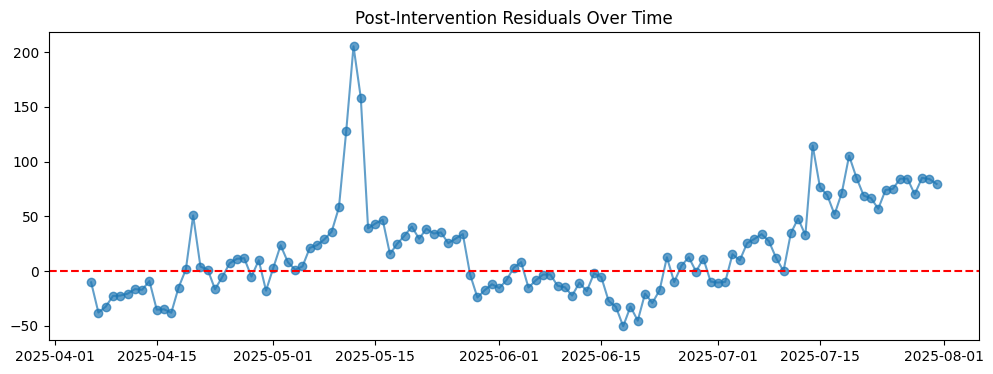

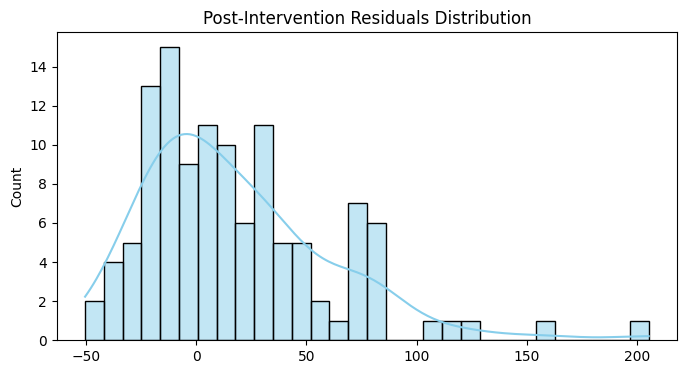

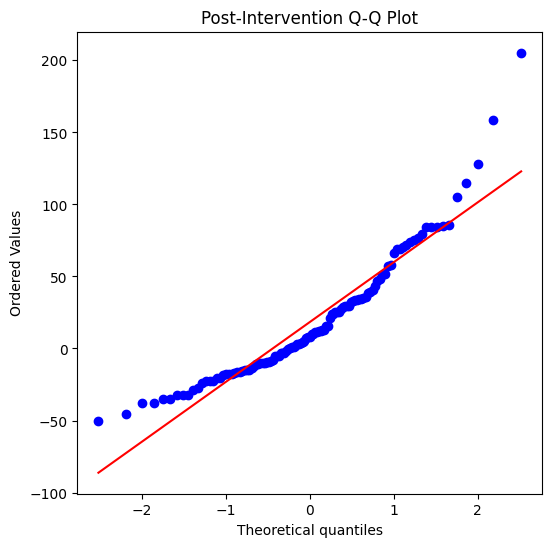

<Figure size 1000x400 with 0 Axes>

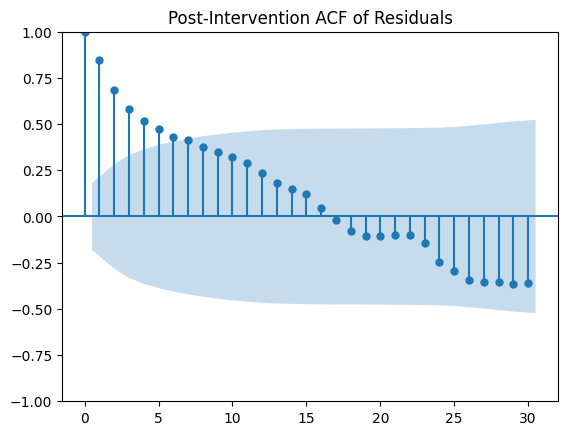

Shapiro-Wilk: stat=0.9090, p-value=0.0000
Durbin-Watson: 0.2448 (≈2 means no autocorrelation)


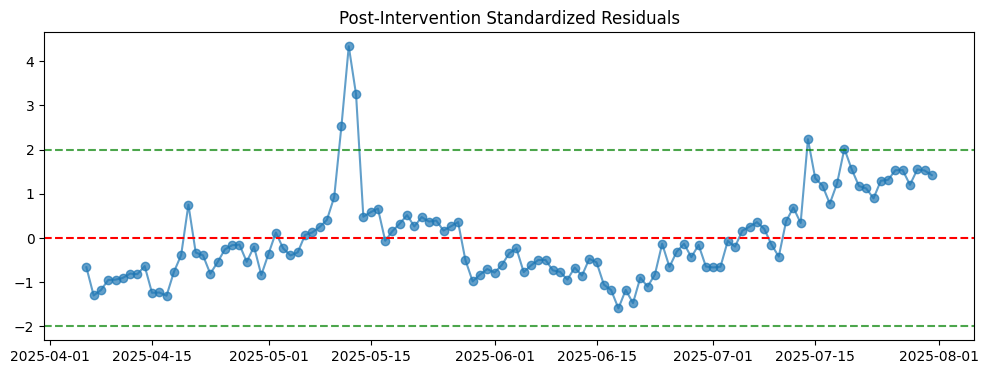

In [19]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf
from scipy import stats
from statsmodels.stats.stattools import durbin_watson

# -----------------------------
# 1. Extract residuals
# -----------------------------

y_obs = impact_boxcox.series.loc[start_date:end_date, "observed"]
y_pred = impact_boxcox.series.loc[start_date:end_date, "posterior_mean"] 

residuals = y_obs - y_pred

# Split into pre- and post-intervention
residuals_pre = residuals.loc[start_date:treatment_date]
residuals_post = residuals.loc[day_after_treatment:end_date]

# Function to analyze residuals
def analyze_residuals(res, period_name):
    print(f"=== Residual Analysis: {period_name} ===")
    
    # Residual over time
    plt.figure(figsize=(12, 4))
    plt.plot(res, marker='o', linestyle='-', alpha=0.7)
    plt.axhline(0, color='red', linestyle='--')
    plt.title(f"{period_name} Residuals Over Time")
    plt.show()
    
    # Histogram + KDE
    plt.figure(figsize=(8, 4))
    sns.histplot(res, kde=True, bins=30, color='skyblue')
    plt.title(f"{period_name} Residuals Distribution")
    plt.show()
    
    # Q-Q plot
    plt.figure(figsize=(6, 6))
    stats.probplot(res, dist="norm", plot=plt)
    plt.title(f"{period_name} Q-Q Plot")
    plt.show()
    
    # Autocorrelation
    plt.figure(figsize=(10, 4))
    plot_acf(res, lags=30)
    plt.title(f"{period_name} ACF of Residuals")
    plt.show()
    
    # Statistical tests
    shapiro_test = stats.shapiro(res)
    dw_stat = durbin_watson(res)
    print(f"Shapiro-Wilk: stat={shapiro_test.statistic:.4f}, p-value={shapiro_test.pvalue:.4f}")
    print(f"Durbin-Watson: {dw_stat:.4f} (≈2 means no autocorrelation)")
    
    # Standardized residuals
    res_std = (res - res.mean()) / res.std()
    plt.figure(figsize=(12, 4))
    plt.plot(res_std, marker='o', linestyle='-', alpha=0.7)
    plt.axhline(0, color='red', linestyle='--')
    plt.axhline(2, color='green', linestyle='--', alpha=0.7)
    plt.axhline(-2, color='green', linestyle='--', alpha=0.7)
    plt.title(f"{period_name} Standardized Residuals")
    plt.show()

# -----------------------------
# 2. Analyze pre- and post- residuals
# -----------------------------
analyze_residuals(residuals_pre, "Pre-Intervention")
analyze_residuals(residuals_post, "Post-Intervention")


## DIfferencing transformation 

In [20]:
merged_data = pd.read_parquet('../data/raw_merged_data.parquet')
merged_data= merged_data.apply(pd.to_numeric, errors="coerce").astype("float64")

### Key Dates
start_date = "2023-08-01"
treatment_date = "2025-04-05"
day_after_treatment = "2025-04-06"
end_date = "2025-07-31"

In [21]:
### some missing values on the series
merged_data_filled = merged_data.copy()
merged_data_filled = merged_data_filled[(merged_data_filled.index >= start_date) & (merged_data_filled.index <= end_date)]
merged_data_filled['Base_trx'] = merged_data_filled['Base_trx'].interpolate(
    method='time',  # Time-aware interpolation
    limit_direction='both'
)
merged_data_filled['uni_trx'] = merged_data_filled['uni_trx'].interpolate(
    method='time',  # Time-aware interpolation
    limit_direction='both'
)


In [27]:
cols = ["uni_trx" ,'eth_trx', "Base_trx", "Optmism_trx"]
differencing = merged_data_filled[cols].copy()

# Apply differencing to each column

diff_df = differencing.diff()
# Rename columns
diff_df.columns = [f"{col}_diff" for col in cols]


differencing = pd.concat([differencing, diff_df], axis=1)


In [28]:
differencing

,uni_trx,eth_trx,Base_trx,Optmism_trx,uni_trx_diff,eth_trx_diff,Base_trx_diff,Optmism_trx_diff
2023-08-01,4361.0,1068108.0,158837.0,675865.0,NaN,NaN,NaN,NaN
2023-08-02,3717.0,1042149.0,145005.0,547768.0,-644.0,-25959.0,-13832.0,-128097.0
2023-08-03,4792.0,1049539.0,458089.0,660791.0,1075.0,7390.0,313084.0,113023.0
2023-08-04,5849.0,1075359.0,253225.0,645983.0,1057.0,25820.0,-204864.0,-14808.0
2023-08-05,5385.0,1124372.0,264869.0,559862.0,-464.0,49013.0,11644.0,-86121.0
...,...,...,...,...,...,...,...,...
2025-07-27,1059439.0,1477026.0,8735697.0,1554319.0,-14271.0,45535.0,-321030.0,12501.0
2025-07-28,944555.0,1611238.0,8544265.0,2109142.0,-114884.0,134212.0,-191432.0,554823.0
2025-07-29,1079379.0,1713564.0,8806401.0,1711368.0,134824.0,102326.0,262136.0,-397774.0
2025-07-30,1022835.0,1820812.0,8594860.0,1250655.0,-56544.0,107248.0,-211541.0,-460713.0


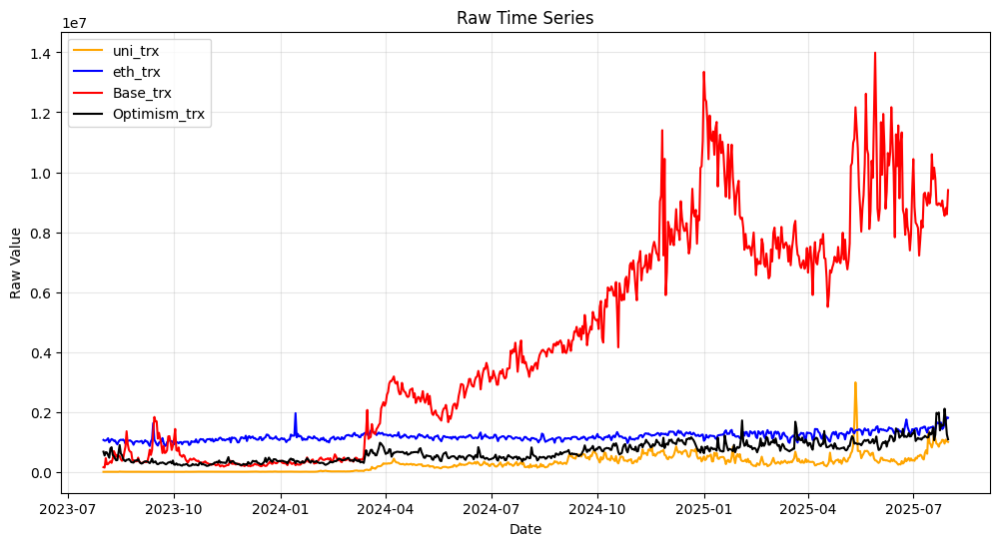

In [29]:
plt.figure(figsize=(12,6))

# Plot each series against the time index
plt.plot(merged_data_filled.index, merged_data_filled["uni_trx"], color="orange", label="uni_trx")
plt.plot(merged_data_filled.index, merged_data_filled["eth_trx"], color="blue", label="eth_trx")
plt.plot(merged_data_filled.index, merged_data_filled["Base_trx"], color="red", label="Base_trx")
plt.plot(merged_data_filled.index, merged_data_filled["Optmism_trx"], color="black", label="Optimism_trx")

plt.xlabel('Date')
plt.ylabel('Raw Value')
plt.title('Raw Time Series')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

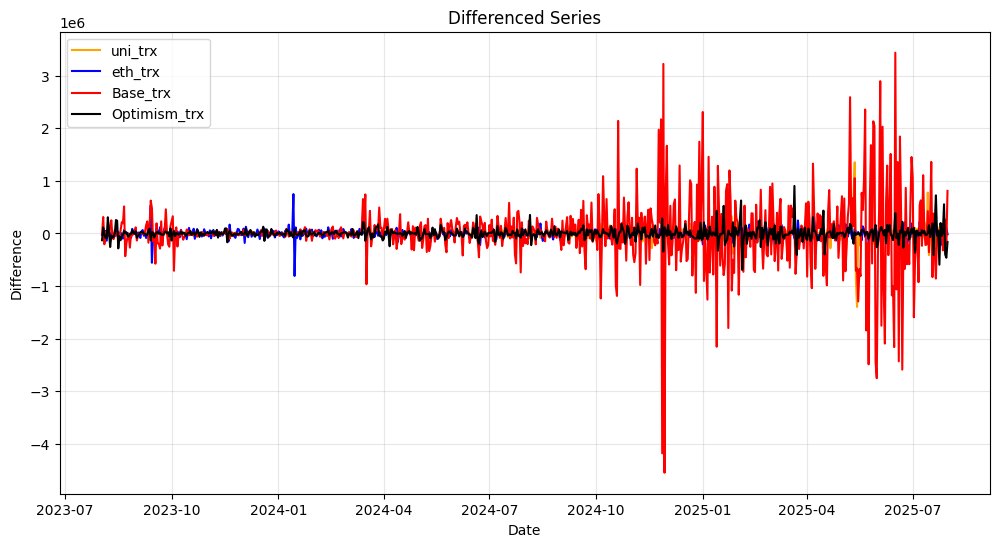

In [30]:
plt.figure(figsize=(12,6))

# Plot each series against the time index
plt.plot(differencing.index, differencing["uni_trx_diff"], color="orange", label="uni_trx")
plt.plot(differencing.index, differencing["eth_trx_diff"], color="blue", label="eth_trx")
plt.plot(differencing.index, differencing["Base_trx_diff"], color="red", label="Base_trx")
plt.plot(differencing.index, differencing["Optmism_trx_diff"], color="black", label="Optimism_trx")

plt.xlabel('Date')
plt.ylabel('Difference')
plt.title('Differenced Series')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

In [31]:
# Running Causal Impact analysis with Box-Cox transformed data

# Define analysis periods
start_date = "2023-08-01"
treatment_date = "2025-04-05"
day_after_treatment = "2025-04-06"
end_date = "2025-07-31"

# Select columns for analysis
analysis_columns = ['uni_trx_diff', 'Base_trx_diff', 'Optmism_trx_diff', 'eth_trx_diff']
differencing_data_for_analysis = differencing[analysis_columns].copy()
differencing_data_for_analysis.dropna(inplace= True)

# Run causal impact analysis on Box-Cox transformed data
impact_boxcox = causalimpact.fit_causalimpact(
    data=differencing_data_for_analysis,
    pre_period=(start_date, treatment_date),
    post_period=(day_after_treatment, end_date))


In [32]:
# Plot the results
causalimpact.plot(impact_boxcox)


alt.FacetChart(...)

In [33]:
# Print summary
print(causalimpact.summary(impact_boxcox, output_format='summary'))


Posterior Inference {CausalImpact}
                          Average            Cumulative
Actual                    5644.5             660406.0
Prediction (s.d.)         245.5 (8953.57)    28724.7 (1047567.25)
95% CI                    [-17494.0, 17184.0][-2046793.1, 2010525.8]

Absolute effect (s.d.)    5399.0 (8953.57)   631681.3 (1047567.22)
95% CI                    [-11539.5, 23138.5][-1350119.8, 2707199.1]

Relative effect (s.d.)    52.1% (3666.9%)    52.1% (3667.0%)
95% CI                    [-865.9%, 949.5%]  [-865.9%, 949.5%]

Posterior tail-area probability p: 0.279
Posterior prob. of a causal effect: 72.14%

For more details run the command: summary(impact, output_format="report")


C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]


## Anscombe + Differencing Combined

In [34]:
merged_data = pd.read_parquet('../data/raw_merged_data.parquet')
merged_data= merged_data.apply(pd.to_numeric, errors="coerce").astype("float64")

### Key Dates
start_date = "2023-08-01"
treatment_date = "2025-04-05"
day_after_treatment = "2025-04-06"
end_date = "2025-07-31"

In [35]:
### some missing values on the series
merged_data_filled = merged_data.copy()
merged_data_filled = merged_data_filled[(merged_data_filled.index >= start_date) & (merged_data_filled.index <= end_date)]
merged_data_filled['Base_trx'] = merged_data_filled['Base_trx'].interpolate(
    method='time',  # Time-aware interpolation
    limit_direction='both'
)
merged_data_filled['uni_trx'] = merged_data_filled['uni_trx'].interpolate(
    method='time',  # Time-aware interpolation
    limit_direction='both'
)


In [36]:
cols = ["uni_trx" ,'eth_trx', "Base_trx", "Optmism_trx"]

# Step 1: Anscombe transform
anscombe_df = merged_data_filled[cols].apply(lambda x: 2 * np.sqrt(x + 3/8))

# Step 2: Differencing
anscombe_diff_df = anscombe_df.diff()

# Rename
anscombe_diff_df.columns = [f"{col}_anscombe_diff" for col in cols]

# Merge
# merged_data_filled = pd.concat([merged_data_filled, anscombe_diff_df], axis=1)


In [37]:
anscombe_diff_df

,uni_trx_anscombe_diff,eth_trx_anscombe_diff,Base_trx_anscombe_diff,Optmism_trx_anscombe_diff
2023-08-01,NaN,NaN,NaN,NaN
2023-08-02,-10.140855,-25.272222,-35.496712,-163.993120
2023-08-03,16.513404,7.226227,592.054577,145.553988
2023-08-04,14.508450,25.050138,-347.215925,-18.319685
2023-08-05,-6.192185,46.737812,22.879157,-110.982785
...,...,...,...,...
2025-07-27,-13.818508,37.760504,-107.636786,10.047326
2025-07-28,-114.816654,108.031818,-65.127558,411.130424
2025-07-29,134.098912,79.372396,89.001223,-288.191756
2025-07-30,-55.157208,80.685925,-71.717841,-379.731493


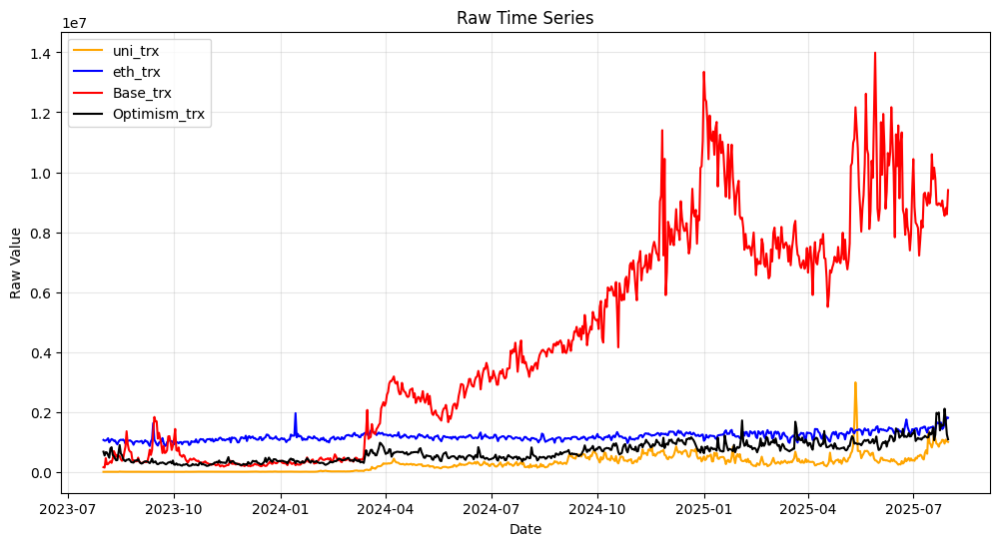

In [38]:
plt.figure(figsize=(12,6))

# Plot each series against the time index
plt.plot(merged_data_filled.index, merged_data_filled["uni_trx"], color="orange", label="uni_trx")
plt.plot(merged_data_filled.index, merged_data_filled["eth_trx"], color="blue", label="eth_trx")
plt.plot(merged_data_filled.index, merged_data_filled["Base_trx"], color="red", label="Base_trx")
plt.plot(merged_data_filled.index, merged_data_filled["Optmism_trx"], color="black", label="Optimism_trx")

plt.xlabel('Date')
plt.ylabel('Raw Value')
plt.title('Raw Time Series')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

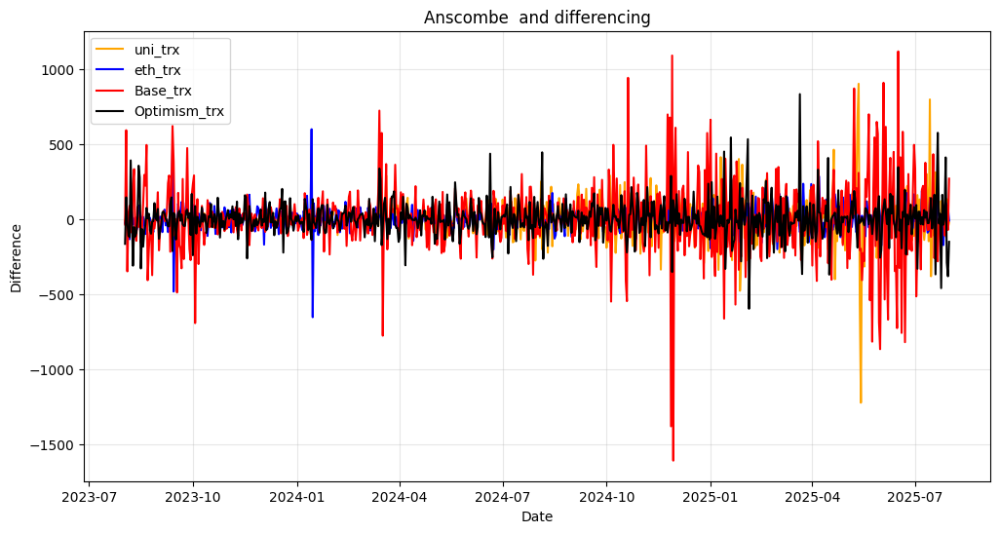

In [39]:
plt.figure(figsize=(12,6))

# Plot each series against the time index
plt.plot(anscombe_diff_df.index, anscombe_diff_df["uni_trx_anscombe_diff"], color="orange", label="uni_trx")
plt.plot(anscombe_diff_df.index, anscombe_diff_df["eth_trx_anscombe_diff"], color="blue", label="eth_trx")
plt.plot(anscombe_diff_df.index, anscombe_diff_df["Base_trx_anscombe_diff"], color="red", label="Base_trx")
plt.plot(anscombe_diff_df.index, anscombe_diff_df["Optmism_trx_anscombe_diff"], color="black", label="Optimism_trx")

plt.xlabel('Date')
plt.ylabel('Difference')
plt.title('Anscombe  and differencing')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

In [40]:
anscombe_diff_df.columns

Index(['uni_trx_anscombe_diff', 'eth_trx_anscombe_diff',
       'Base_trx_anscombe_diff', 'Optmism_trx_anscombe_diff'],
      dtype='object')

In [41]:
# Running Causal Impact analysis with Box-Cox transformed data

# Define analysis periods
start_date = "2023-08-01"
treatment_date = "2025-04-05"
day_after_treatment = "2025-04-06"
end_date = "2025-07-31"

# Select columns for analysis
analysis_columns = ['uni_trx_anscombe_diff', 'eth_trx_anscombe_diff','Base_trx_anscombe_diff', 'Optmism_trx_anscombe_diff']
anscombe_diff_data_for_analysis = anscombe_diff_df[analysis_columns].copy()
anscombe_diff_data_for_analysis.dropna(inplace= True)

# Run causal impact analysis on Box-Cox transformed data
impact_boxcox = causalimpact.fit_causalimpact(
    data=anscombe_diff_data_for_analysis,
    pre_period=(start_date, treatment_date),
    post_period=(day_after_treatment, end_date))


In [42]:
# Plot the results
causalimpact.plot(impact_boxcox)


alt.FacetChart(...)

In [43]:
# Print summary
print(causalimpact.summary(impact_boxcox, output_format='summary'))


Posterior Inference {CausalImpact}
                          Average            Cumulative
Actual                    7.1                834.2
Prediction (s.d.)         1.3 (13.93)        148.2 (1630.05)
95% CI                    [-25.6, 29.7]      [-3000.4, 3476.3]

Absolute effect (s.d.)    5.9 (13.93)        686.0 (1630.05)
95% CI                    [-22.6, 32.8]      [-2642.2, 3834.5]

Relative effect (s.d.)    -68.4% (1101.4%)   -68.4% (1101.0%)
95% CI                    [-813.8%, 645.2%]  [-813.8%, 645.2%]

Posterior tail-area probability p: 0.352
Posterior prob. of a causal effect: 64.82%

For more details run the command: summary(impact, output_format="report")


C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]


# ROI reflection 


In [23]:
##  https://x.com/Optimism/status/1968352499192209749 - ## optmism reference for the mean price of transaction execution

SyntaxError: invalid syntax (1081403180.py, line 1)

In [24]:
uniswap_received_funds = 296250.0075
median_trx_cost = 0.0014

expected_transactions_uni = uniswap_received_funds / median_trx_cost

expected_transactions_uni


211607148.21428573

In [25]:
trx_uni = metrics[(metrics.project_name == 'uniswap') 
                  & (metrics.metric == 'transactions_daily')
                  & (metrics.sample_date  >= '2025-01-01')
                  & (metrics.sample_date  <= '2025-07-31') ].amount.sum()
trx_uni

NameError: name 'metrics' is not defined

In [ ]:
trx_uni / expected_transactions_uni

# Aerodrome Impact Analysis

In [44]:
raw_merged_data =  pd.read_parquet("../data/raw_merged_data.parquet")

In [45]:
aero = raw_merged_data[~raw_merged_data["aero_trx"].isna()]

In [46]:
aero.drop(columns = ["uni_trx", "velo_trx"], inplace = True)

C:\Users\vieir\AppData\Local\Temp\ipykernel_9036\3941812874.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  aero.drop(columns = ["uni_trx", "velo_trx"], inplace = True)


In [47]:
aero.isna().sum()

aero_trx             0
curve_trx           29
balancer_trx        29
Base_trx            29
Optmism_trx         29
Unichain_trx       464
Seneium_trx        494
eth_prices         373
eth_market_caps    373
eth_volume         373
eth_trx              0
dtype: int64

## Correlation analysis

In [48]:
merged_data = aero.copy()

In [49]:

# Define the treatment date
treatment_date = pd.to_datetime('2025-04-01')

# Separate data into pre-treatment and post-treatment periods
pre_treatment_data = merged_data[merged_data.index < treatment_date]
post_treatment_data = merged_data[merged_data.index >= treatment_date]
# temp_pre = pre_treatment_data[['uni_trx', series_name]].dropna()

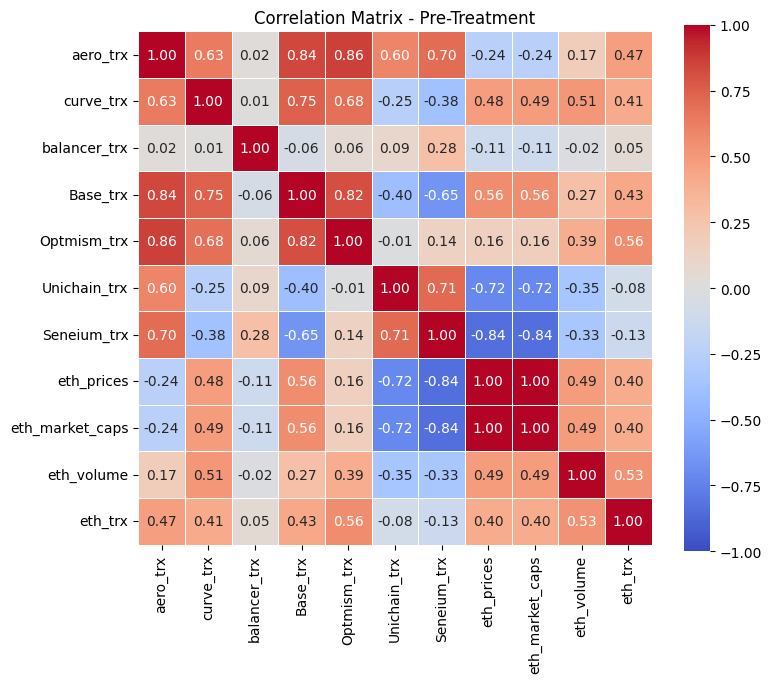

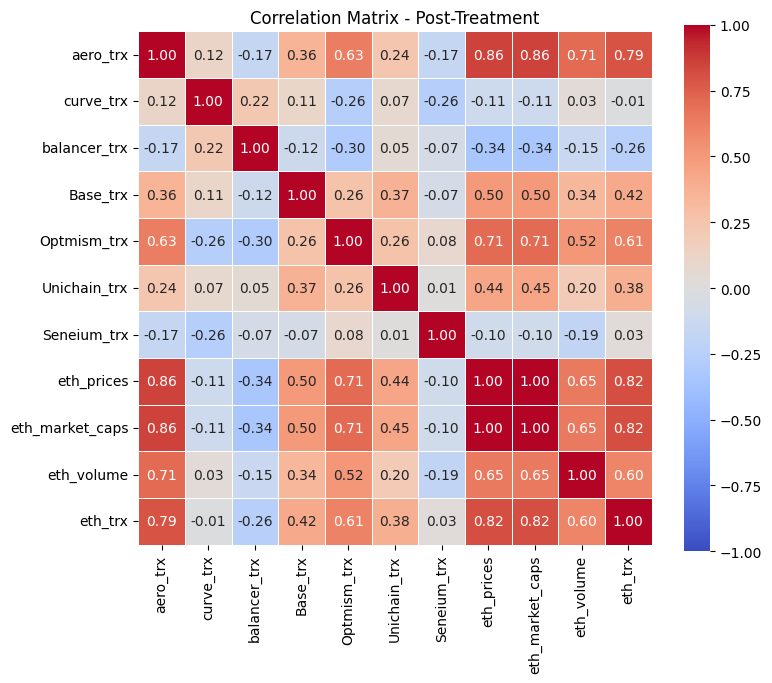

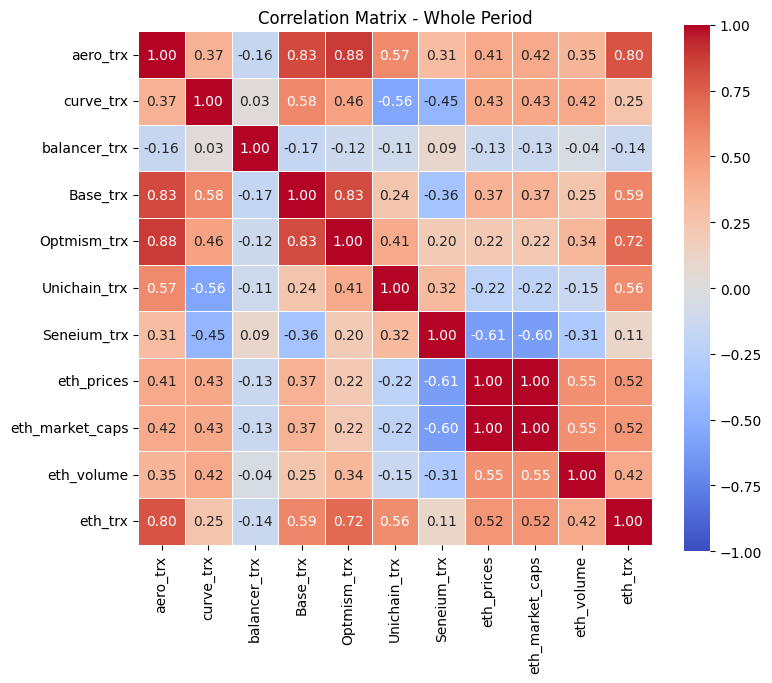

Pre-Treatment Correlations:
                 aero_trx  curve_trx  balancer_trx  Base_trx  Optmism_trx  \
aero_trx         1.000000   0.633283      0.017967  0.843340     0.860489   
curve_trx        0.633283   1.000000      0.008650  0.748069     0.682617   
balancer_trx     0.017967   0.008650      1.000000 -0.055323     0.059841   
Base_trx         0.843340   0.748069     -0.055323  1.000000     0.816709   
Optmism_trx      0.860489   0.682617      0.059841  0.816709     1.000000   
Unichain_trx     0.596371  -0.253192      0.089963 -0.398983    -0.010429   
Seneium_trx      0.700083  -0.379901      0.280104 -0.652384     0.135570   
eth_prices      -0.236545   0.483931     -0.113306  0.556420     0.163592   
eth_market_caps -0.235331   0.485486     -0.113674  0.558097     0.164502   
eth_volume       0.172992   0.510074     -0.016487  0.273873     0.392536   
eth_trx          0.470250   0.413609      0.048495  0.425805     0.560609   

                 Unichain_trx  Seneium_trx  eth

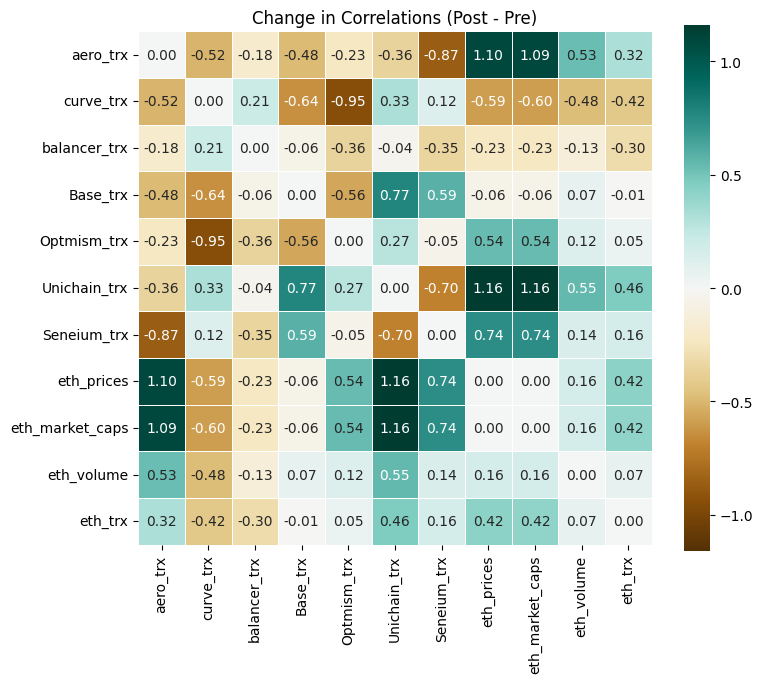

In [50]:

if not isinstance(merged_data.index, pd.DatetimeIndex):
    merged_data = merged_data.copy()
    merged_data.index = pd.to_datetime(merged_data.index)

# Split periods
pre_treatment_data = merged_data[merged_data.index < treatment_date]
post_treatment_data = merged_data[merged_data.index >= treatment_date]

# Use all numeric columns (so every variable is included)
numeric_cols = merged_data.select_dtypes(include=[np.number]).columns.tolist()

# Compute correlation matrices
corr_pre = pre_treatment_data[numeric_cols].corr()
corr_post = post_treatment_data[numeric_cols].corr()
corr_whole = merged_data[numeric_cols].corr()

# Helper: heatmap with smart annotation for large matrices
def plot_corr_heatmap(corr_df, title, annotate_threshold=15):
    annot = corr_df.shape[0] <= annotate_threshold  # avoid clutter on large matrices
    size = max(8, 0.55 * corr_df.shape[0])         # scale figure with number of vars
    plt.figure(figsize=(size, size))
    sns.heatmap(
        corr_df,
        vmin=-1, vmax=1, center=0,
        cmap='coolwarm',
        annot=annot, fmt=".2f" if annot else "",
        square=True, linewidths=0.5,
        cbar_kws={'shrink': 0.75}
    )
    plt.title(title)
    plt.tight_layout()
    plt.show()

# Plot per-period heatmaps
plot_corr_heatmap(corr_pre,  'Correlation Matrix - Pre-Treatment')
plot_corr_heatmap(corr_post, 'Correlation Matrix - Post-Treatment')
plot_corr_heatmap(corr_whole,'Correlation Matrix - Whole Period')

# Optional: print to console (and/or export to CSV)
print("Pre-Treatment Correlations:")
print(corr_pre)
print("\nPost-Treatment Correlations:")
print(corr_post)
print("\nWhole Period Correlations:")
print(corr_whole)

# Optional: visualize how correlations changed from pre to post
delta_corr = corr_post - corr_pre
v = np.nanmax(np.abs(delta_corr.values))
plt.figure(figsize=(max(8, 0.55 * delta_corr.shape[0]), max(8, 0.55 * delta_corr.shape[0])))
sns.heatmap(
    delta_corr,
    vmin=-v, vmax=v, center=0,
    cmap='BrBG',
    annot=delta_corr.shape[0] <= 15, fmt=".2f" if delta_corr.shape[0] <= 15 else "",
    square=True, linewidths=0.5,
    cbar_kws={'shrink': 0.75}
)
plt.title('Change in Correlations (Post - Pre)')
plt.tight_layout()
plt.show()

In [55]:
correlated_variables = ["aero_trx","curve_trx", "Base_trx", "Optmism_trx", "Unichain_trx", "Seneium_trx", "eth_trx"]

In [56]:
merged_data[correlated_variables].isna().sum()

KeyError: "['Unichain_trx', 'Seneium_trx'] not in index"

In [57]:
variables = ["aero_trx","curve_trx", "Base_trx", "Optmism_trx","eth_trx"]
merged_data = merged_data[variables].copy()

In [58]:
merged_data[merged_data.curve_trx.isna()]

,aero_trx,curve_trx,Base_trx,Optmism_trx,eth_trx
2025-08-01,274746.0,<NA>,<NA>,<NA>,1758306.0
2025-08-02,247406.0,<NA>,<NA>,<NA>,1642345.0
2025-08-03,184403.0,<NA>,<NA>,<NA>,1515954.0
2025-08-04,212322.0,<NA>,<NA>,<NA>,1728281.0
2025-08-05,211012.0,<NA>,<NA>,<NA>,1877988.0
2025-08-06,215485.0,<NA>,<NA>,<NA>,1833756.0
2025-08-07,230943.0,<NA>,<NA>,<NA>,1766307.0
2025-08-08,282459.0,<NA>,<NA>,<NA>,1711849.0
2025-08-09,290446.0,<NA>,<NA>,<NA>,1645152.0
2025-08-10,277212.0,<NA>,<NA>,<NA>,1670117.0


## Aerodrome causal impact analysis

In [59]:
import sys
import os
print(f"Python executable: {sys.executable}")
print(f"Virtual env active: {'causal_impact_env' in sys.executable}")

# Test the import
import causalimpact
print("✅ CausalImpact imported successfully!")

# Check TensorFlow is working
import tensorflow as tf
print(f"TensorFlow version: {tf.__version__}")

Python executable: C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Scripts\python.exe
Virtual env active: True
✅ CausalImpact imported successfully!
TensorFlow version: 2.20.0


In [60]:
import sys
print("path:", getattr(causalimpact, "__file__", None))
print("version:", getattr(causalimpact, "__version__", "n/a"))
print("has fit_causalimpact:", hasattr(causalimpact, "fit_causalimpact"))

path: C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\__init__.py
version: 0.2.0
has fit_causalimpact: True


## Box cox transformation Analysis

In [61]:

merged_data= merged_data.apply(pd.to_numeric, errors="coerce").astype("float64")

### Key Dates
start_date = "2023-08-01"
treatment_date = "2025-04-05"
day_after_treatment = "2025-04-06"
end_date = "2025-07-31"

In [62]:
### some missing values on the series
merged_data_filled = merged_data.copy()
merged_data_filled = merged_data_filled[(merged_data_filled.index >= start_date) & (merged_data_filled.index <= end_date)]



In [63]:
merged_data_filled.columns

Index(['aero_trx', 'curve_trx', 'Base_trx', 'Optmism_trx', 'eth_trx'], dtype='object')

In [64]:
boxcox= merged_data_filled.copy()

In [65]:
boxcox.head()

,aero_trx,curve_trx,Base_trx,Optmism_trx,eth_trx
2023-08-28,572.0,185.0,353847.0,374491.0,995843.0
2023-08-29,2772.0,224.0,353574.0,383659.0,1019692.0
2023-08-30,6856.0,1258.0,362835.0,379635.0,1027316.0
2023-08-31,56661.0,1812.0,478984.0,422753.0,1010128.0
2023-09-01,20650.0,1370.0,346144.0,342105.0,1006635.0


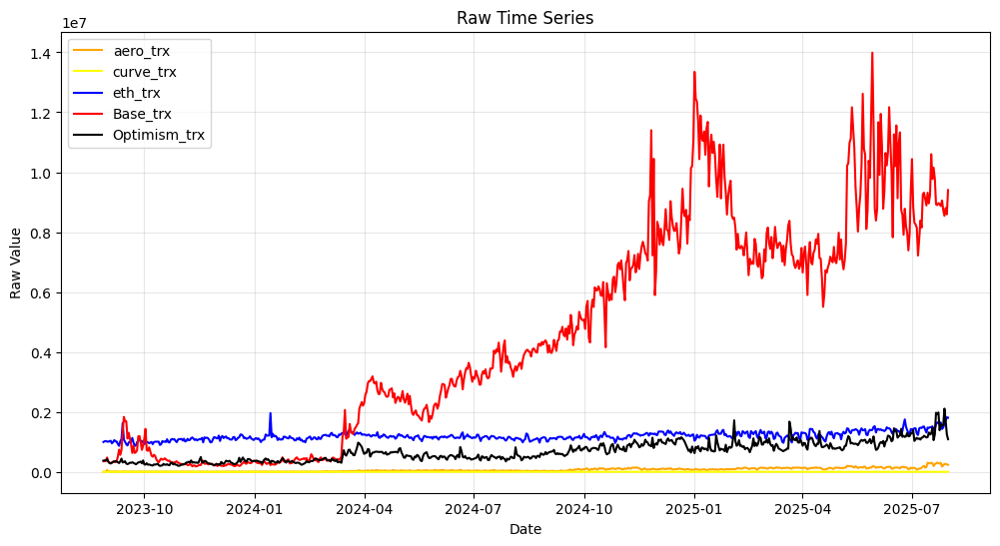

In [66]:
plt.figure(figsize=(12,6))

# Plot each series against the time index
plt.plot(boxcox.index, boxcox["aero_trx"], color="orange", label="aero_trx")
plt.plot(boxcox.index, boxcox["curve_trx"], color="yellow", label="curve_trx")
plt.plot(boxcox.index, boxcox["eth_trx"], color="blue", label="eth_trx")
plt.plot(boxcox.index, boxcox["Base_trx"], color="red", label="Base_trx")
plt.plot(boxcox.index, boxcox["Optmism_trx"], color="black", label="Optimism_trx")

plt.xlabel('Date')
plt.ylabel('Raw Value')
plt.title('Raw Time Series')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

In [67]:
boxcox.describe()

,aero_trx,curve_trx,Base_trx,Optmism_trx,eth_trx
count,703.000000,703.000000,7.030000e+02,7.030000e+02,7.030000e+02
mean,66841.480797,1181.630156,4.587589e+06,6.726960e+05,1.195605e+06
std,60701.096738,800.445688,3.596283e+06,3.225002e+05,1.402607e+05
min,572.000000,185.000000,1.785260e+05,2.012000e+05,8.635030e+05
25%,11164.500000,631.500000,6.781065e+05,3.964105e+05,1.105594e+06
50%,45800.000000,938.000000,3.999040e+06,6.449160e+05,1.173934e+06
75%,110265.500000,1558.500000,7.554842e+06,8.914045e+05,1.269980e+06
max,310161.000000,6329.000000,1.399030e+07,2.109142e+06,1.961144e+06


In [68]:
boxcox.columns

Index(['aero_trx', 'curve_trx', 'Base_trx', 'Optmism_trx', 'eth_trx'], dtype='object')

##### Box-cox Alpha analysis

Finding optimal lambda for aero_trx...


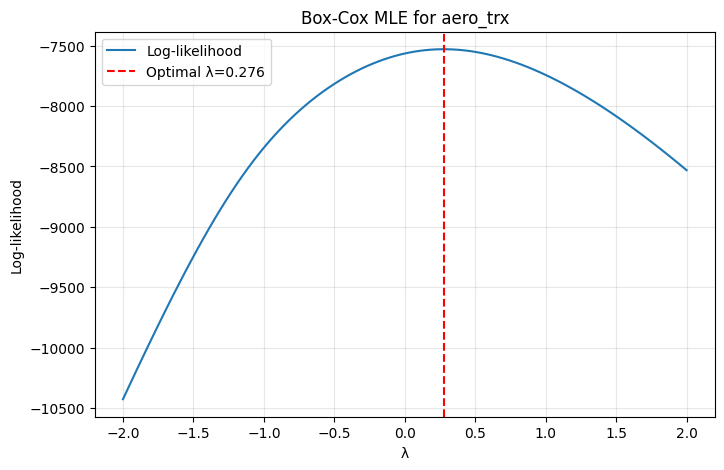

Finding optimal lambda for curve_trx...


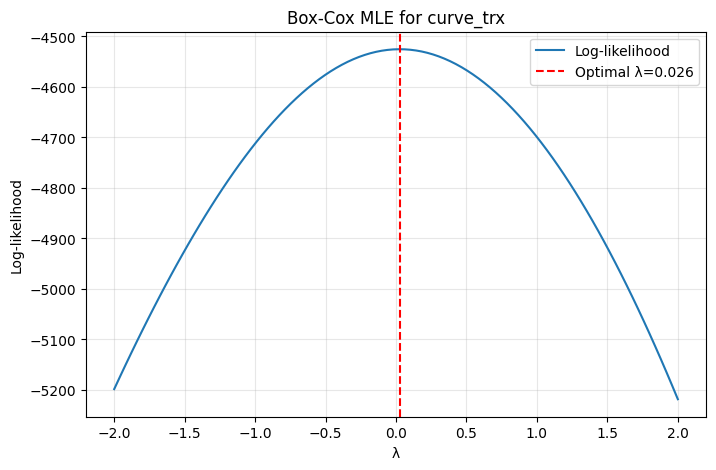

Finding optimal lambda for Base_trx...


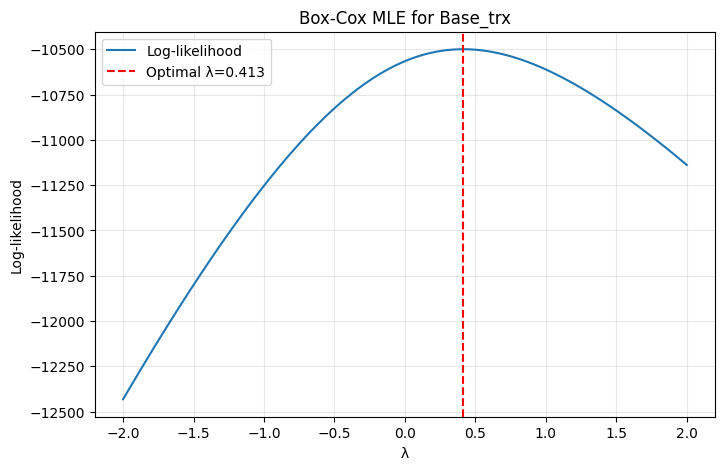

Finding optimal lambda for Optmism_trx...


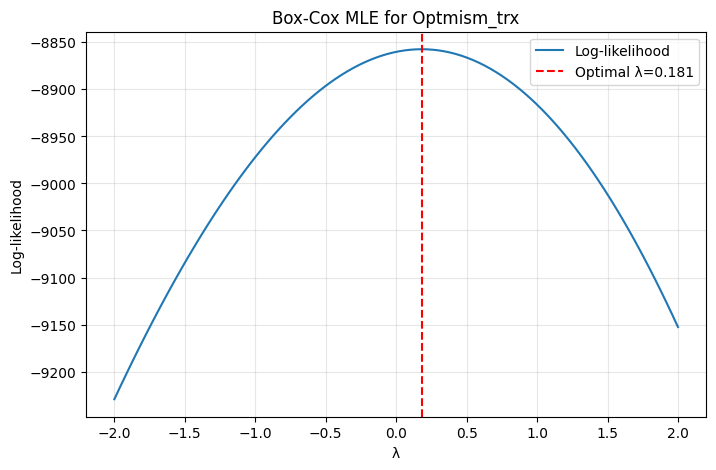

Finding optimal lambda for eth_trx...


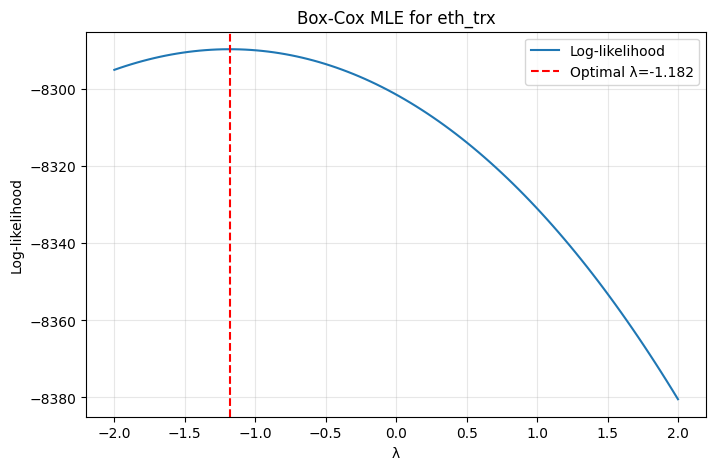


Optimal Lambda Values for Each Column:
             Optimal Lambda
aero_trx           0.276186
curve_trx          0.025845
Base_trx           0.413056
Optmism_trx        0.181229
eth_trx           -1.181844


In [69]:
# Box-Cox transformation 

from scipy import stats


boxcox = boxcox[(boxcox.index >= start_date) & (boxcox.index <= end_date)]

# Function to find optimal lambda for Box-Cox transformation
def find_optimal_lambda(data_series, column_name):
    """Find the optimal lambda parameter for Box-Cox transformation with likelihood profile."""
    data = data_series.copy()
    if (data <= 0).any():
        print(f"Warning: {column_name} contains zeros or negative values. Adding offset...")
        offset = abs(data.min()) + 1
        data = data + offset

    # 1. Optimal lambda (MLE)
    fitted_lambda = stats.boxcox_normmax(data, method='mle')

    # 2. Evaluate log-likelihood across a range
    lambdas = np.linspace(-2, 2, 100)
    llf = [stats.boxcox_llf(lmb, data) for lmb in lambdas]

    # Plot profile likelihood
    plt.figure(figsize=(8, 5))
    plt.plot(lambdas, llf, label='Log-likelihood')
    plt.axvline(fitted_lambda, color='red', linestyle='--', label=f'Optimal λ={fitted_lambda:.3f}')
    plt.xlabel('λ')
    plt.ylabel('Log-likelihood')
    plt.title(f'Box-Cox MLE for {column_name}')
    plt.legend()
    plt.grid(alpha=0.3)
    plt.show()

    return fitted_lambda

# Find optimal lambda for each column and store results
lambda_values = {}
columns_to_transform = ['aero_trx', 'curve_trx', 'Base_trx', 'Optmism_trx', 'eth_trx']

for col in columns_to_transform:
    if col in boxcox.columns:
        print(f"Finding optimal lambda for {col}...")
        lambda_values[col] = find_optimal_lambda(merged_data_filled[col], col)

# Display all optimal lambda values
lambda_df = pd.DataFrame.from_dict(lambda_values, orient='index', columns=['Optimal Lambda'])
print("\nOptimal Lambda Values for Each Column:")
print(lambda_df)

In [70]:
lambda_values

{'aero_trx': np.float64(0.27618626370456734),
 'curve_trx': np.float64(0.025845152527448127),
 'Base_trx': np.float64(0.41305646791159584),
 'Optmism_trx': np.float64(0.1812288968967396),
 'eth_trx': np.float64(-1.181844416820128)}

In [71]:
# Apply Box-Cox transformation to the data
def apply_boxcox_transform(data, lambda_values):
    """
    Apply Box-Cox transformation to each column in the dataframe
    using the provided lambda values.
    
    Parameters:
    -----------
    data : pandas.DataFrame
        The dataframe to transform
    lambda_values : dict
        Dictionary mapping column names to their optimal lambda values
    
    Returns:
    --------
    pandas.DataFrame
        Transformed dataframe
    dict
        Dictionary of offsets applied to make data positive (for inverse transform)
    """
    transformed_data = pd.DataFrame(index=data.index)
    offsets = {}
    
    for col, lambda_val in lambda_values.items():
        if col in data.columns:
            series = data[col].copy()
            
            # Check if we need to add an offset (Box-Cox requires positive values)
            offset = 0
            if (series <= 0).any():
                offset = abs(series.min()) + 1
                series = series + offset
                offsets[col] = offset
            
            # Apply Box-Cox transformation
            if abs(lambda_val) < 1e-10:  # lambda ≈ 0
                transformed_data[col] = np.log(series)
            else:
                transformed_data[col] = (series**lambda_val - 1) / lambda_val
                
            # Add a note about the transformation
            print(f"Transformed {col} with lambda={lambda_val:.4f}" + 
                  (f" and offset={offset}" if offset > 0 else ""))
    
    return transformed_data, offsets



# # Save the transformed data
# merged_data_boxcox.to_parquet('../data/merged_data_boxcox.parquet')


Transformed aero_trx with lambda=0.2762
Transformed curve_trx with lambda=0.0258
Transformed Base_trx with lambda=0.4131
Transformed Optmism_trx with lambda=0.1812
Transformed eth_trx with lambda=-1.1818


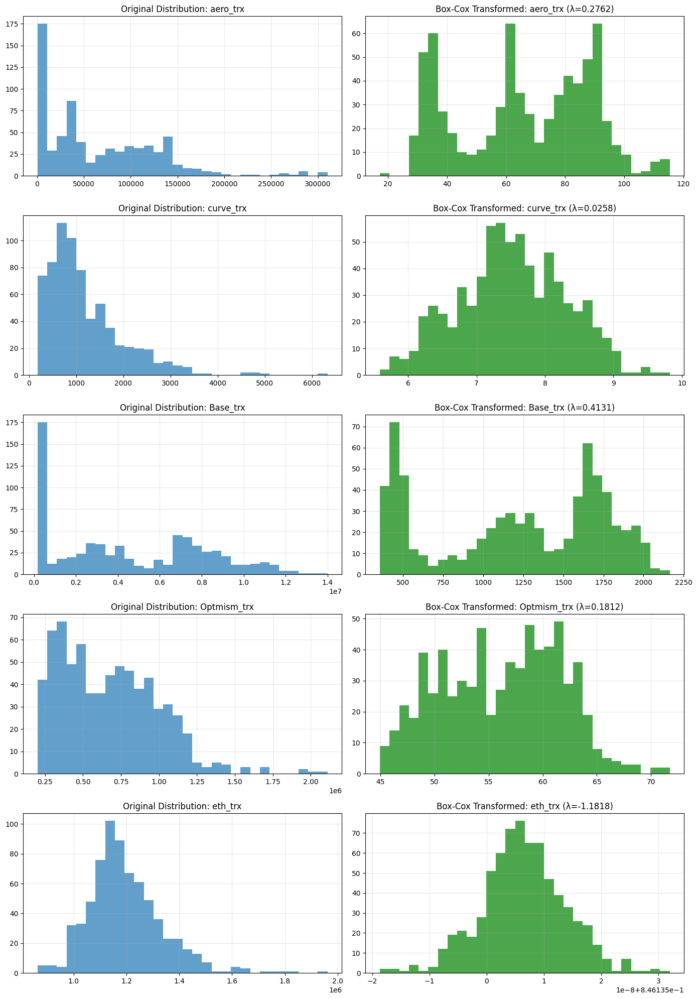

In [72]:
# Apply the transformation
merged_data_boxcox, offsets = apply_boxcox_transform(boxcox, lambda_values)

# Compare original and transformed distributions for a few key columns
key_columns = ['aero_trx', 'curve_trx', 'Base_trx', 'Optmism_trx', 'eth_trx']
fig, axes = plt.subplots(len(key_columns), 2, figsize=(14, 4*len(key_columns)))

for i, col in enumerate(key_columns):
    if col in boxcox.columns and col in merged_data_boxcox.columns:
        # Original data histogram
        axes[i, 0].hist(boxcox[col], bins=30, alpha=0.7)
        axes[i, 0].set_title(f'Original Distribution: {col}')
        axes[i, 0].grid(alpha=0.3)
        
        # Transformed data histogram
        axes[i, 1].hist(merged_data_boxcox[col], bins=30, alpha=0.7, color='green')
        axes[i, 1].set_title(f'Box-Cox Transformed: {col} (λ={lambda_values[col]:.4f})')
        axes[i, 1].grid(alpha=0.3)

plt.tight_layout()
plt.show()

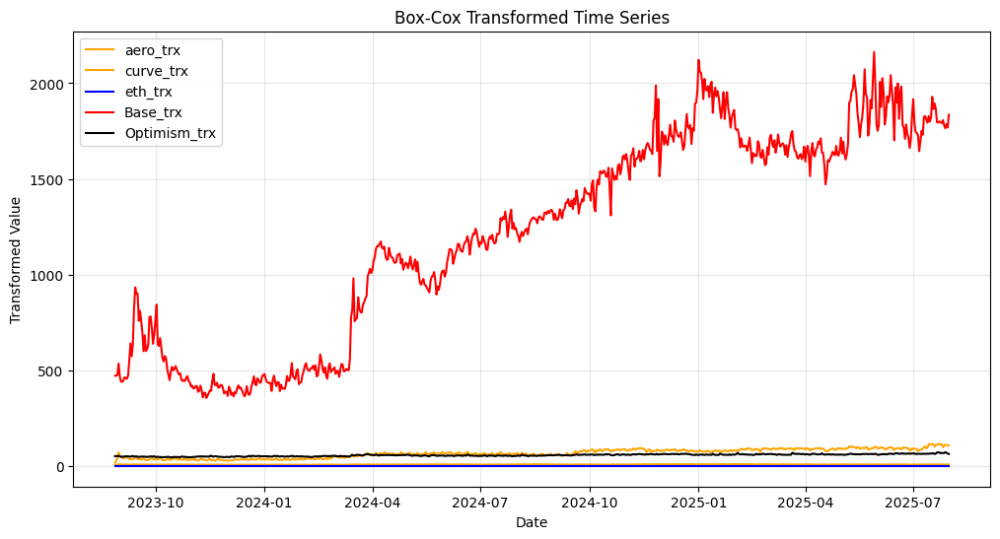

In [73]:
merged_data_boxcox

plt.figure(figsize=(12,6))

# Plot each series against the time index
plt.plot(merged_data_boxcox.index, merged_data_boxcox["aero_trx"], color="orange", label="aero_trx")
plt.plot(merged_data_boxcox.index, merged_data_boxcox["curve_trx"], color="orange", label="curve_trx")
plt.plot(merged_data_boxcox.index, merged_data_boxcox["eth_trx"], color="blue", label="eth_trx")
plt.plot(merged_data_boxcox.index, merged_data_boxcox["Base_trx"], color="red", label="Base_trx")
plt.plot(merged_data_boxcox.index, merged_data_boxcox["Optmism_trx"], color="black", label="Optimism_trx")

plt.xlabel('Date')
plt.ylabel('Transformed Value')
plt.title('Box-Cox Transformed Time Series')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

In [74]:
# Running Causal Impact analysis with Box-Cox transformed data

# Define analysis periods
start_date = "2023-08-01"
treatment_date = "2025-04-05"
day_after_treatment = "2025-04-06"
end_date = "2025-07-31"

# Select columns for analysis
analysis_columns = ['aero_trx', 'curve_trx', 'Base_trx', 'Optmism_trx', 'eth_trx']
boxcox_data_for_analysis = merged_data_boxcox[analysis_columns].copy()

# Run causal impact analysis on Box-Cox transformed data
impact_boxcox = causalimpact.fit_causalimpact(
    data=boxcox_data_for_analysis,
    pre_period=(start_date, treatment_date),
    post_period=(day_after_treatment, end_date))


In [75]:
# Plot the results
causalimpact.plot(impact_boxcox)

alt.FacetChart(...)

In [71]:
# Print summary
print(causalimpact.summary(impact_boxcox, output_format='summary'))


Posterior Inference {CausalImpact}
                          Average            Cumulative
Actual                    94.2               11017.8
Prediction (s.d.)         90.9 (5.35)        10630.0 (626.51)
95% CI                    [80.6, 101.6]      [9435.3, 11886.2]

Absolute effect (s.d.)    3.3 (5.35)         387.8 (626.51)
95% CI                    [-7.4, 13.5]       [-868.4, 1582.5]

Relative effect (s.d.)    4.0% (6.2%)        4.0% (6.0%)
95% CI                    [-7.3%, 16.8%]     [-7.3%, 16.8%]

Posterior tail-area probability p: 0.27
Posterior prob. of a causal effect: 73.03%

For more details run the command: summary(impact, output_format="report")


C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]


In [72]:
print(causalimpact.summary(impact_boxcox, output_format='report'))


Analysis report {CausalImpact}


During the post-intervention period, the response variable had
an average value of approx. 94.2. In the absence of an
intervention, we would have expected an average response of 90.9.
The 95% interval of this counterfactual prediction is [80.6, 101.6].
Subtracting this prediction from the observed response yields
an estimate of the causal effect the intervention had on the
response variable. This effect is 3.3 with a 95% interval of
[-7.4, 13.5]. For a discussion of the significance of this effect,
see below.


Summing up the individual data points during the post-intervention
period (which can only sometimes be meaningfully interpreted), the
response variable had an overall value of 11017.8.
Had the intervention not taken place, we would have expected
a sum of 10630.0. The 95% interval of this prediction is [9435.3, 11886.2].


The above results are given in terms of absolute numbers. In relative
terms, the response variable showed an increase of +4.0

C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]


In [73]:
# Calculate model quality metrics
y_pre = impact_boxcox.series.loc[start_date:treatment_date, "observed"].values
yhat_pre = impact_boxcox.series.loc[start_date:treatment_date, "posterior_mean"].values

# Residuals
resid = y_pre - yhat_pre

# RMSE and R²
rmse = np.sqrt(np.mean(resid**2))
ss_res = np.sum(resid**2)
ss_tot = np.sum((y_pre - y_pre.mean())**2)
r2 = 1 - ss_res / ss_tot

print("\nBox-Cox Transformed Model Quality:")
print(f"Pre-period RMSE: {rmse:.6f}")
print(f"Pre-period R²: {r2:.6f}")


Box-Cox Transformed Model Quality:
Pre-period RMSE: 3.336101
Pre-period R²: 0.972554


### Checking residuals

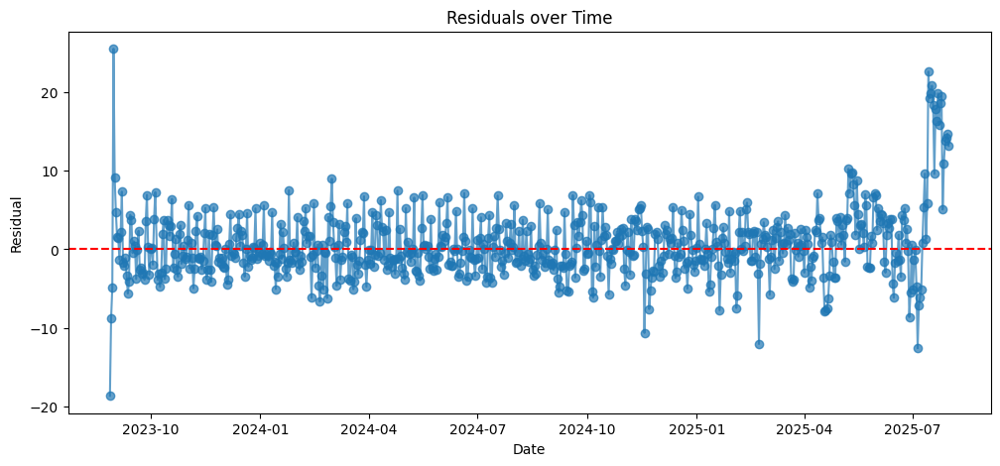

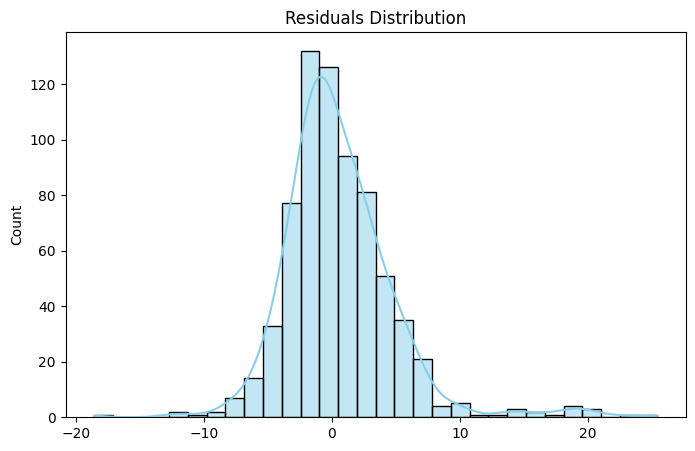

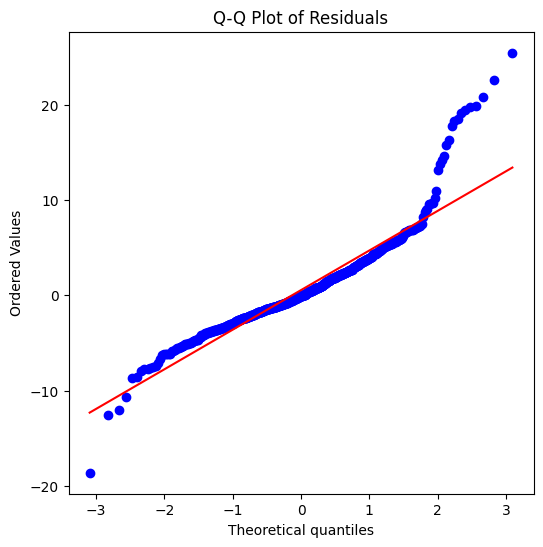

<Figure size 1000x400 with 0 Axes>

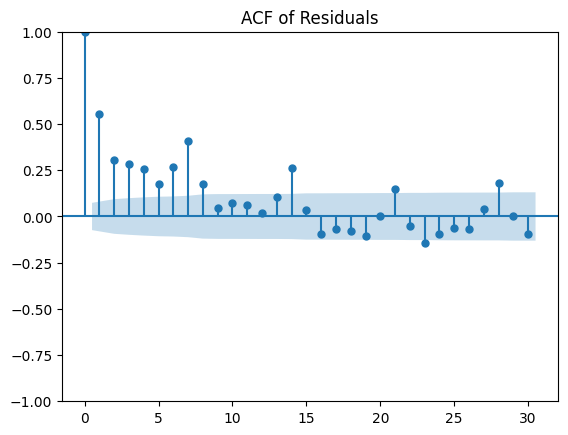

Shapiro-Wilk test: statistic=0.8968, p-value=0.0000
Durbin-Watson statistic: 0.8435 (≈2 means no autocorrelation)


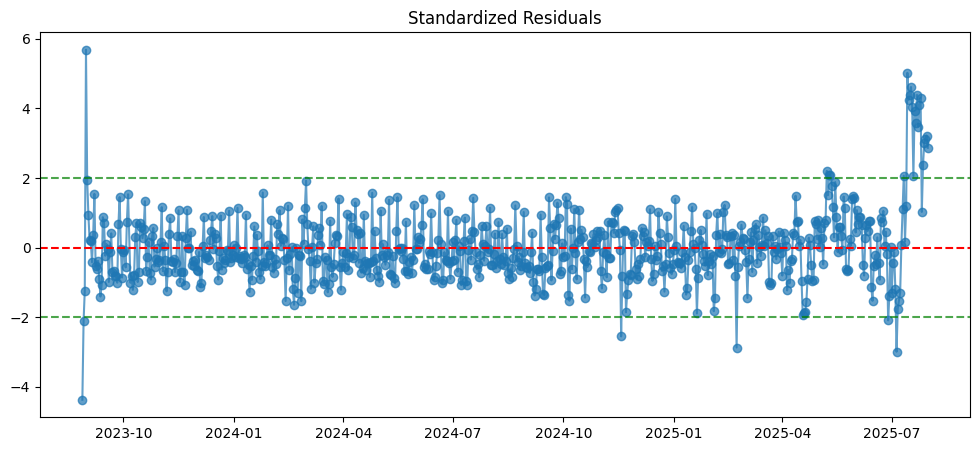

In [74]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf
from scipy import stats
import numpy as np
from statsmodels.stats.stattools import durbin_watson

# -----------------------------
# 1. Extract residuals
# -----------------------------
y_obs = impact_boxcox.series.loc[start_date:end_date, "observed"]
y_pred = impact_boxcox.series.loc[start_date:end_date, "posterior_mean"]

residuals = y_obs - y_pred

# -----------------------------
# 2. Residual plot
# -----------------------------
plt.figure(figsize=(12, 5))
plt.plot(residuals, marker='o', linestyle='-', alpha=0.7)
plt.axhline(0, color='red', linestyle='--')
plt.title("Residuals over Time")
plt.xlabel("Date")
plt.ylabel("Residual") 
plt.show()

# -----------------------------
# 3. Histogram and KDE
# -----------------------------
plt.figure(figsize=(8, 5))
sns.histplot(residuals, kde=True, bins=30, color='skyblue')
plt.title("Residuals Distribution")
plt.show()

# -----------------------------
# 4. Q-Q Plot for normality
# -----------------------------
plt.figure(figsize=(6, 6))
stats.probplot(residuals, dist="norm", plot=plt)
plt.title("Q-Q Plot of Residuals")
plt.show()

# -----------------------------
# 5. Autocorrelation check
# -----------------------------
plt.figure(figsize=(10, 4))
plot_acf(residuals, lags=30)
plt.title("ACF of Residuals")
plt.show()

# -----------------------------
# 6. Statistical tests
# -----------------------------
shapiro_test = stats.shapiro(residuals)
print(f"Shapiro-Wilk test: statistic={shapiro_test.statistic:.4f}, p-value={shapiro_test.pvalue:.4f}")

dw_stat = durbin_watson(residuals)
print(f"Durbin-Watson statistic: {dw_stat:.4f} (≈2 means no autocorrelation)")

# -----------------------------
# 7. Optional: standardized residuals
# -----------------------------
residuals_std = (residuals - residuals.mean()) / residuals.std()
plt.figure(figsize=(12, 5))
plt.plot(residuals_std, marker='o', linestyle='-', alpha=0.7)
plt.axhline(0, color='red', linestyle='--')
plt.axhline(2, color='green', linestyle='--', alpha=0.7)
plt.axhline(-2, color='green', linestyle='--', alpha=0.7)
plt.title("Standardized Residuals")
plt.show()


=== Residual Analysis: Pre-Intervention ===


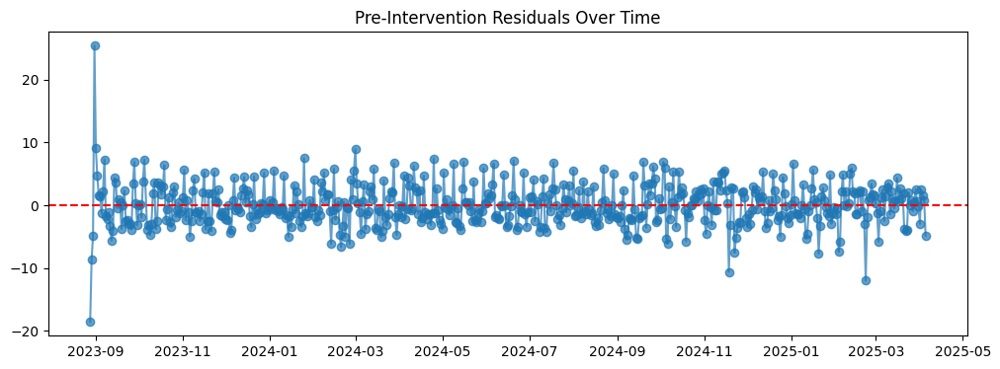

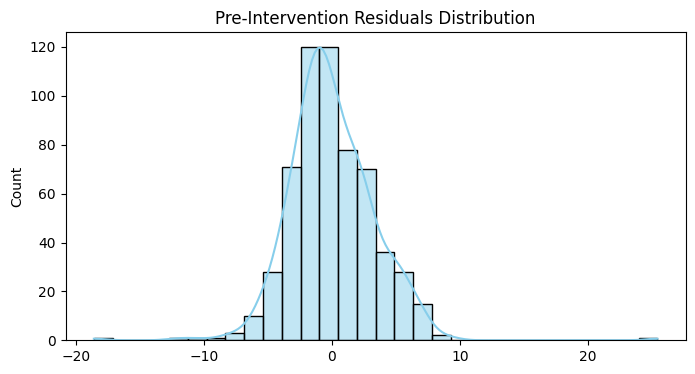

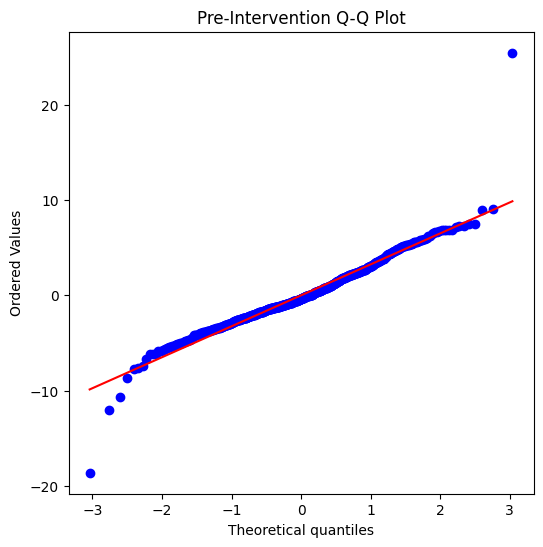

<Figure size 1000x400 with 0 Axes>

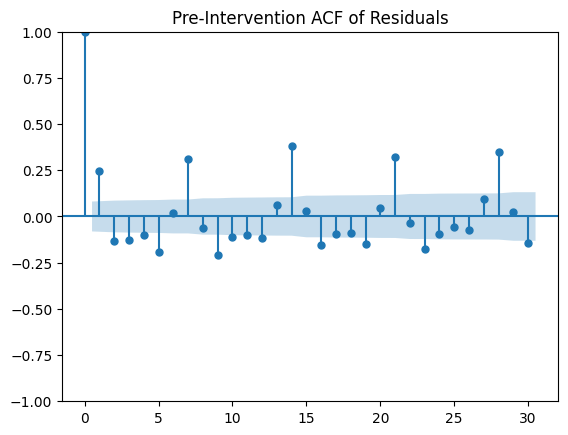

Shapiro-Wilk: stat=0.9449, p-value=0.0000
Durbin-Watson: 1.4479 (≈2 means no autocorrelation)


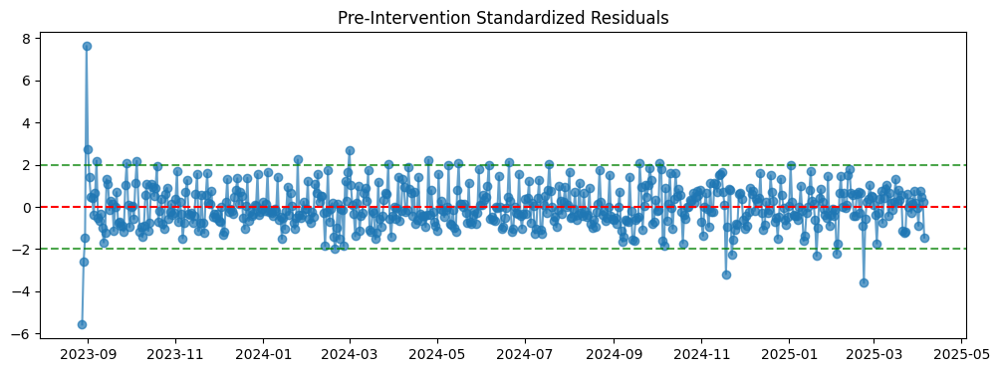

=== Residual Analysis: Post-Intervention ===


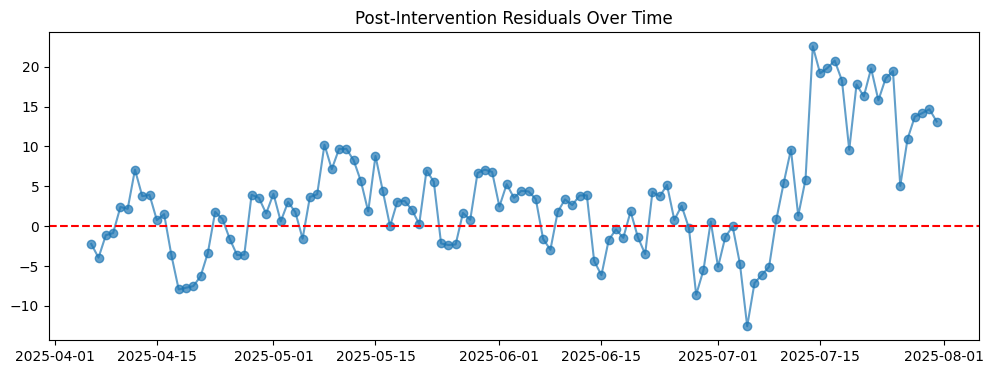

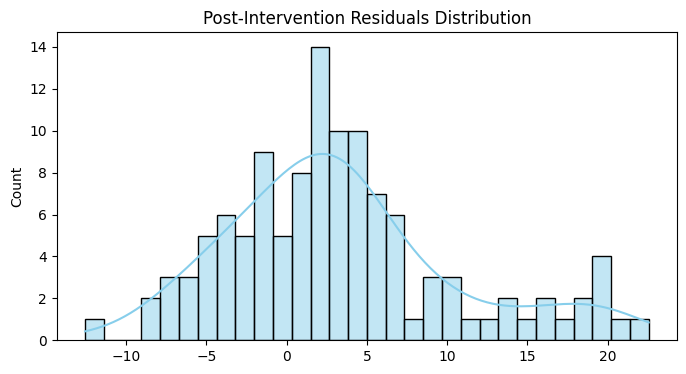

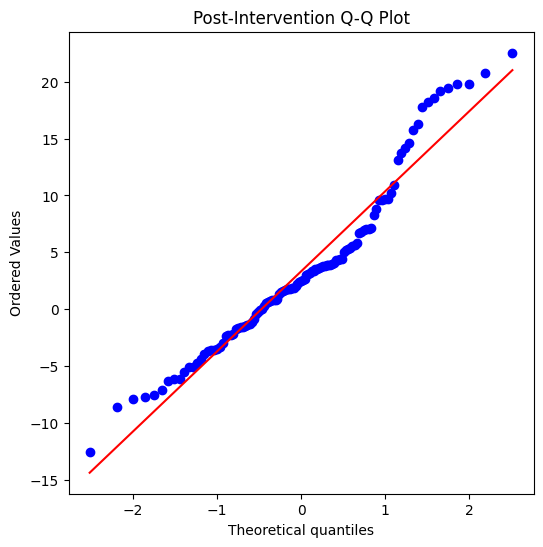

<Figure size 1000x400 with 0 Axes>

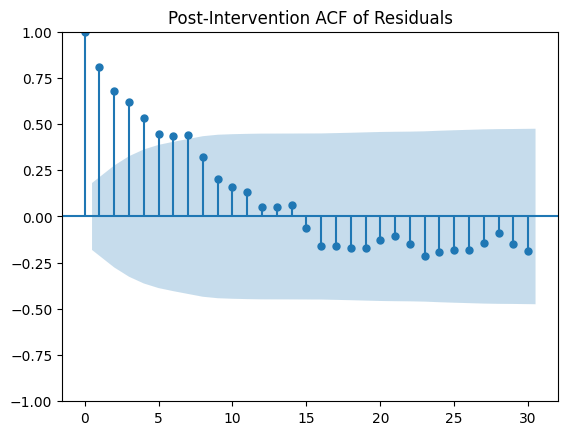

Shapiro-Wilk: stat=0.9488, p-value=0.0002
Durbin-Watson: 0.2924 (≈2 means no autocorrelation)


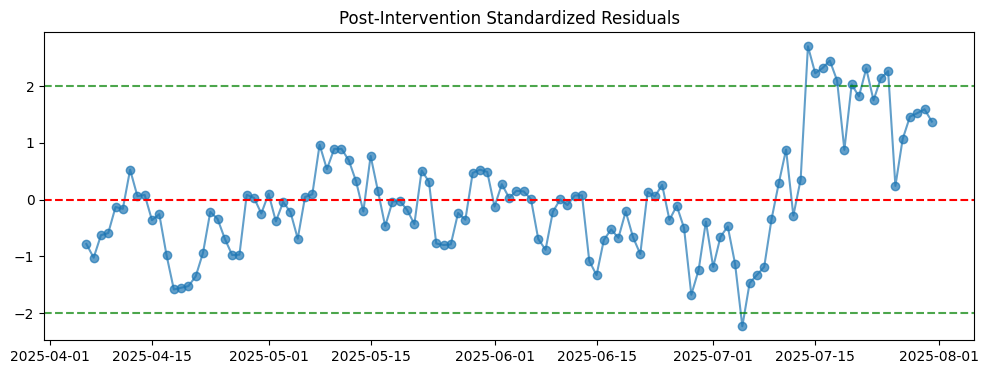

In [75]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf
from scipy import stats
from statsmodels.stats.stattools import durbin_watson

# -----------------------------
# 1. Extract residuals
# -----------------------------

y_obs = impact_boxcox.series.loc[start_date:end_date, "observed"]
y_pred = impact_boxcox.series.loc[start_date:end_date, "posterior_mean"] 

residuals = y_obs - y_pred

# Split into pre- and post-intervention
residuals_pre = residuals.loc[start_date:treatment_date]
residuals_post = residuals.loc[day_after_treatment:end_date]

# Function to analyze residuals
def analyze_residuals(res, period_name):
    print(f"=== Residual Analysis: {period_name} ===")
    
    # Residual over time
    plt.figure(figsize=(12, 4))
    plt.plot(res, marker='o', linestyle='-', alpha=0.7)
    plt.axhline(0, color='red', linestyle='--')
    plt.title(f"{period_name} Residuals Over Time")
    plt.show()
    
    # Histogram + KDE
    plt.figure(figsize=(8, 4))
    sns.histplot(res, kde=True, bins=30, color='skyblue')
    plt.title(f"{period_name} Residuals Distribution")
    plt.show()
    
    # Q-Q plot
    plt.figure(figsize=(6, 6))
    stats.probplot(res, dist="norm", plot=plt)
    plt.title(f"{period_name} Q-Q Plot")
    plt.show()
    
    # Autocorrelation
    plt.figure(figsize=(10, 4))
    plot_acf(res, lags=30)
    plt.title(f"{period_name} ACF of Residuals")
    plt.show()
    
    # Statistical tests
    shapiro_test = stats.shapiro(res)
    dw_stat = durbin_watson(res)
    print(f"Shapiro-Wilk: stat={shapiro_test.statistic:.4f}, p-value={shapiro_test.pvalue:.4f}")
    print(f"Durbin-Watson: {dw_stat:.4f} (≈2 means no autocorrelation)")
    
    # Standardized residuals
    res_std = (res - res.mean()) / res.std()
    plt.figure(figsize=(12, 4))
    plt.plot(res_std, marker='o', linestyle='-', alpha=0.7)
    plt.axhline(0, color='red', linestyle='--')
    plt.axhline(2, color='green', linestyle='--', alpha=0.7)
    plt.axhline(-2, color='green', linestyle='--', alpha=0.7)
    plt.title(f"{period_name} Standardized Residuals")
    plt.show()

# -----------------------------
# 2. Analyze pre- and post- residuals
# -----------------------------
analyze_residuals(residuals_pre, "Pre-Intervention")
analyze_residuals(residuals_post, "Post-Intervention")


### checking counterfactual variables predictive power 

In [76]:

### R2 and RMSE 
## error on the predicted period 

# Extract observed and predicted for the pre-period only
y_pre = impact_boxcox.series.loc[start_date:treatment_date, "observed"].values
yhat_pre = impact_boxcox.series.loc[start_date:treatment_date, "posterior_mean"].values

# Residuals
resid = y_pre - yhat_pre

# RMSE and R²
rmse = np.sqrt(np.mean(resid**2))
ss_res = np.sum(resid**2)
ss_tot = np.sum((y_pre - y_pre.mean())**2)
r2 = 1 - ss_res / ss_tot

print("Pre-period RMSE:", rmse)
print("Pre-period R²:", r2)





Pre-period RMSE: 3.3361011705435137
Pre-period R²: 0.9725542907793795


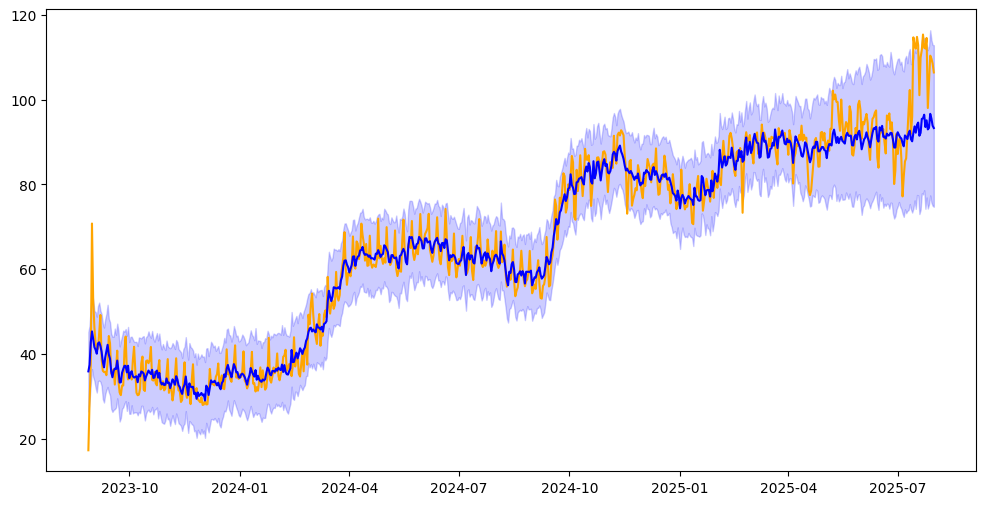

In [77]:
import matplotlib.pyplot as plt

# Extract series from the fitted object
df_plot = impact_boxcox.series

plt.figure(figsize=(12,6))
plt.plot(df_plot.index, df_plot["observed"], color="orange", label="Observed")
plt.plot(df_plot.index, df_plot["posterior_mean"], color="blue", label="Posterior mean")
plt.fill_between(
    df_plot.index,
    df_plot["posterior_lower"],
    df_plot["posterior_upper"],
    color="blue",
    alpha=0.2,
    label="95% credible interval"
)

In [78]:
# Get posterior draws for regression weights
weights = np.asarray(impact_boxcox.posterior_samples.weights)  # shape: (n_draws, n_predictors)

# Split intercept and covariate betas
intercept_draws = weights[:, 0]
beta_draws = weights[:, 1:]  # assume col 0 is intercept, then your covariates

# Name your covariates in the same order used to fit the model
covariate_names = [ 'curve_trx', 'Base_trx', 'Optmism_trx', 'eth_trx']
assert beta_draws.shape[1] == len(covariate_names), (
    f"Expected {len(covariate_names)} betas, got {beta_draws.shape[1]}"
)

# Summaries
for i, name in enumerate(covariate_names):
    b = beta_draws[:, i]
    mean = b.mean()
    lower, upper = np.quantile(b, [0.025, 0.975])
    p_pos = (b > 0).mean()
    p_neg = (b < 0).mean()
    print(f"{name}: mean={mean:.4f}, 95% CI=({lower:.4f},{upper:.4f}), "
          f"P(>0)={p_pos:.3f}, P(<0)={p_neg:.3f}")

curve_trx: mean=0.0456, 95% CI=(0.0000,0.2088), P(>0)=0.328, P(<0)=0.003
Base_trx: mean=0.1261, 95% CI=(0.0683,0.1846), P(>0)=0.992, P(<0)=0.000
Optmism_trx: mean=0.0428, 95% CI=(0.0000,0.0795), P(>0)=0.823, P(<0)=0.000
eth_trx: mean=-0.0004, 95% CI=(0.0000,0.0000), P(>0)=0.002, P(<0)=0.017


### Fitting the model using just relevant Betas 

In [76]:
# Running Causal Impact analysis with Box-Cox transformed data

# Define analysis periods
start_date = "2023-08-01"
treatment_date = "2025-04-05"
day_after_treatment = "2025-04-06"
end_date = "2025-07-31"

# Select columns for analysis
analysis_columns = ['aero_trx', 'curve_trx','Base_trx', 'Optmism_trx']
boxcox_data_for_analysis = merged_data_boxcox[analysis_columns].copy()

# Run causal impact analysis on Box-Cox transformed data
impact_boxcox = causalimpact.fit_causalimpact(
    data=boxcox_data_for_analysis,
    pre_period=(start_date, treatment_date),
    post_period=(day_after_treatment, end_date))


In [77]:
# Plot the results
causalimpact.plot(impact_boxcox)

alt.FacetChart(...)

In [81]:
# Print summary
print(causalimpact.summary(impact_boxcox, output_format='summary'))


Posterior Inference {CausalImpact}
                          Average            Cumulative
Actual                    94.2               11017.8
Prediction (s.d.)         90.2 (5.47)        10554.6 (640.11)
95% CI                    [79.1, 100.9]      [9253.9, 11799.7]

Absolute effect (s.d.)    4.0 (5.47)         463.3 (640.11)
95% CI                    [-6.7, 15.1]       [-781.9, 1763.9]

Relative effect (s.d.)    4.8% (6.5%)        4.8% (6.0%)
95% CI                    [-6.6%, 19.1%]     [-6.6%, 19.1%]

Posterior tail-area probability p: 0.223
Posterior prob. of a causal effect: 77.69%

For more details run the command: summary(impact, output_format="report")


C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]


In [82]:
print(causalimpact.summary(impact_boxcox, output_format='report'))


Analysis report {CausalImpact}


During the post-intervention period, the response variable had
an average value of approx. 94.2. In the absence of an
intervention, we would have expected an average response of 90.2.
The 95% interval of this counterfactual prediction is [79.1, 100.9].
Subtracting this prediction from the observed response yields
an estimate of the causal effect the intervention had on the
response variable. This effect is 4.0 with a 95% interval of
[-6.7, 15.1]. For a discussion of the significance of this effect,
see below.


Summing up the individual data points during the post-intervention
period (which can only sometimes be meaningfully interpreted), the
response variable had an overall value of 11017.8.
Had the intervention not taken place, we would have expected
a sum of 10554.6. The 95% interval of this prediction is [9253.9, 11799.7].


The above results are given in terms of absolute numbers. In relative
terms, the response variable showed an increase of +4.8

C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]


In [83]:
# Calculate model quality metrics
y_pre = impact_boxcox.series.loc[start_date:treatment_date, "observed"].values
yhat_pre = impact_boxcox.series.loc[start_date:treatment_date, "posterior_mean"].values

# Residuals
resid = y_pre - yhat_pre

# RMSE and R²
rmse = np.sqrt(np.mean(resid**2))
ss_res = np.sum(resid**2)
ss_tot = np.sum((y_pre - y_pre.mean())**2)
r2 = 1 - ss_res / ss_tot

print("\nBox-Cox Transformed Model Quality:")
print(f"Pre-period RMSE: {rmse:.6f}")
print(f"Pre-period R²: {r2:.6f}")


Box-Cox Transformed Model Quality:
Pre-period RMSE: 3.371491
Pre-period R²: 0.971969


### Checking residuals

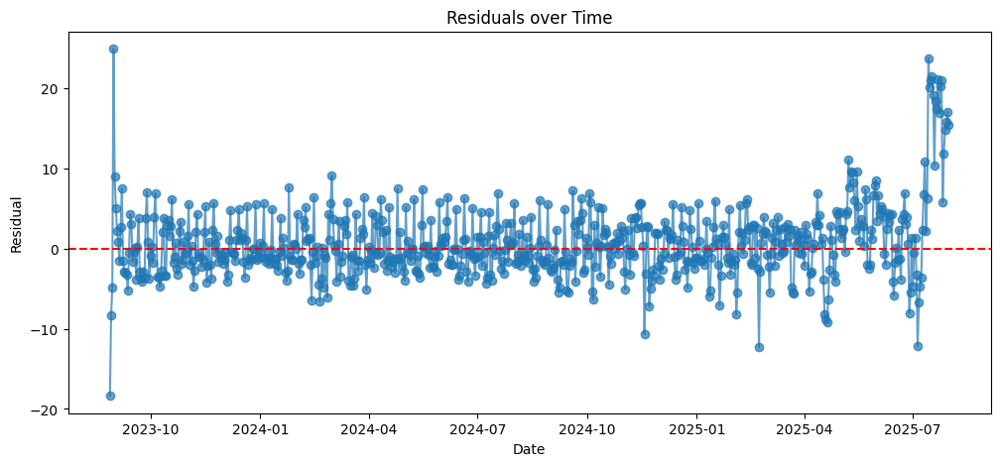

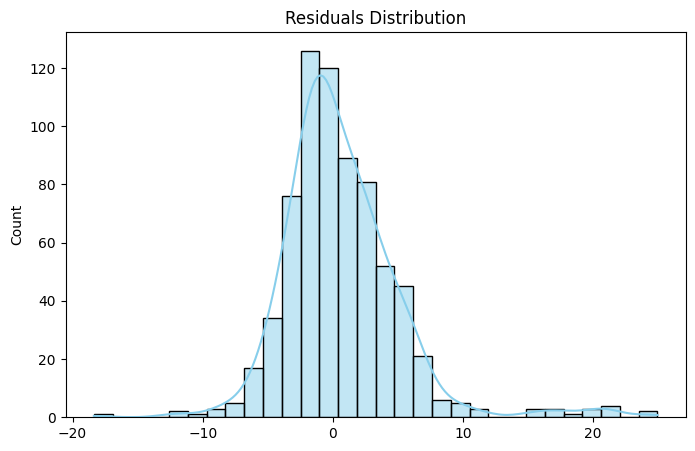

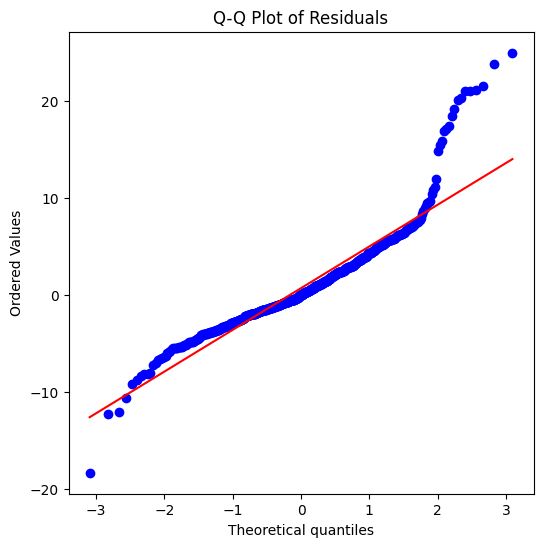

<Figure size 1000x400 with 0 Axes>

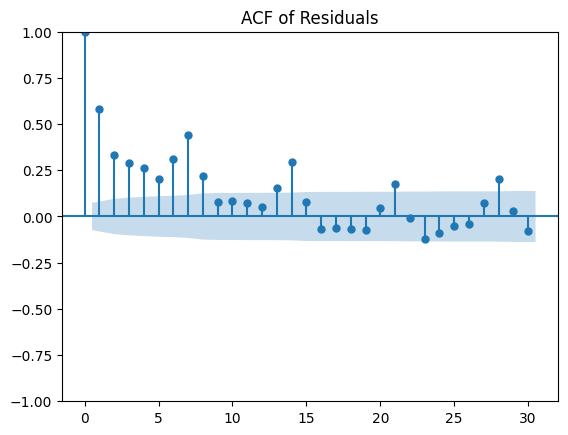

Shapiro-Wilk test: statistic=0.8887, p-value=0.0000
Durbin-Watson statistic: 0.7819 (≈2 means no autocorrelation)


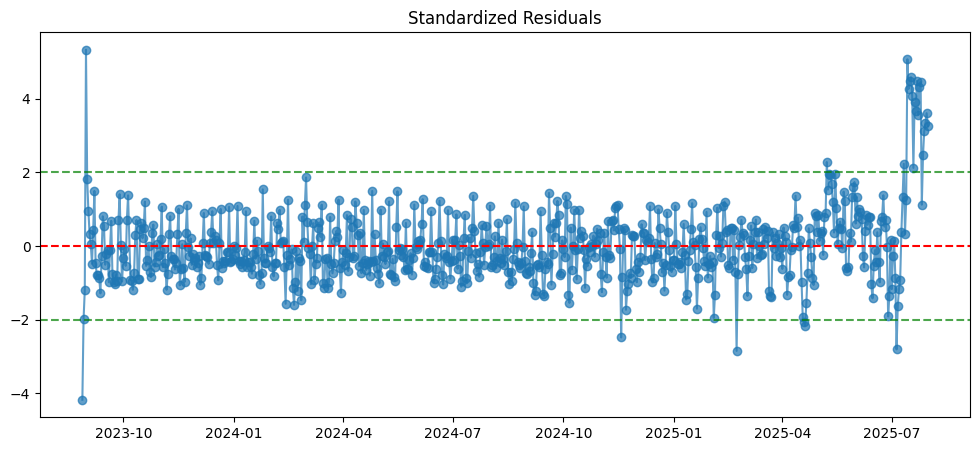

In [84]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf
from scipy import stats
import numpy as np
from statsmodels.stats.stattools import durbin_watson

# -----------------------------
# 1. Extract residuals
# -----------------------------
y_obs = impact_boxcox.series.loc[start_date:end_date, "observed"]
y_pred = impact_boxcox.series.loc[start_date:end_date, "posterior_mean"]

residuals = y_obs - y_pred

# -----------------------------
# 2. Residual plot
# -----------------------------
plt.figure(figsize=(12, 5))
plt.plot(residuals, marker='o', linestyle='-', alpha=0.7)
plt.axhline(0, color='red', linestyle='--')
plt.title("Residuals over Time")
plt.xlabel("Date")
plt.ylabel("Residual") 
plt.show()

# -----------------------------
# 3. Histogram and KDE
# -----------------------------
plt.figure(figsize=(8, 5))
sns.histplot(residuals, kde=True, bins=30, color='skyblue')
plt.title("Residuals Distribution")
plt.show()

# -----------------------------
# 4. Q-Q Plot for normality
# -----------------------------
plt.figure(figsize=(6, 6))
stats.probplot(residuals, dist="norm", plot=plt)
plt.title("Q-Q Plot of Residuals")
plt.show()

# -----------------------------
# 5. Autocorrelation check
# -----------------------------
plt.figure(figsize=(10, 4))
plot_acf(residuals, lags=30)
plt.title("ACF of Residuals")
plt.show()

# -----------------------------
# 6. Statistical tests
# -----------------------------
shapiro_test = stats.shapiro(residuals)
print(f"Shapiro-Wilk test: statistic={shapiro_test.statistic:.4f}, p-value={shapiro_test.pvalue:.4f}")

dw_stat = durbin_watson(residuals)
print(f"Durbin-Watson statistic: {dw_stat:.4f} (≈2 means no autocorrelation)")

# -----------------------------
# 7. Optional: standardized residuals
# -----------------------------
residuals_std = (residuals - residuals.mean()) / residuals.std()
plt.figure(figsize=(12, 5))
plt.plot(residuals_std, marker='o', linestyle='-', alpha=0.7)
plt.axhline(0, color='red', linestyle='--')
plt.axhline(2, color='green', linestyle='--', alpha=0.7)
plt.axhline(-2, color='green', linestyle='--', alpha=0.7)
plt.title("Standardized Residuals")
plt.show()


=== Residual Analysis: Pre-Intervention ===


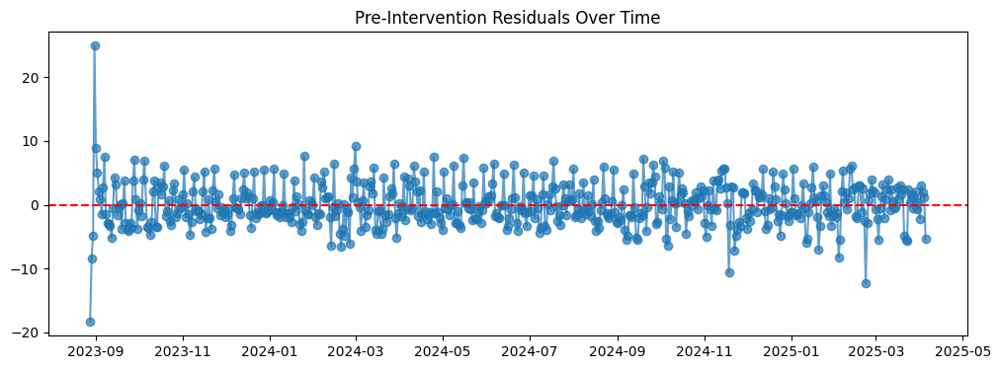

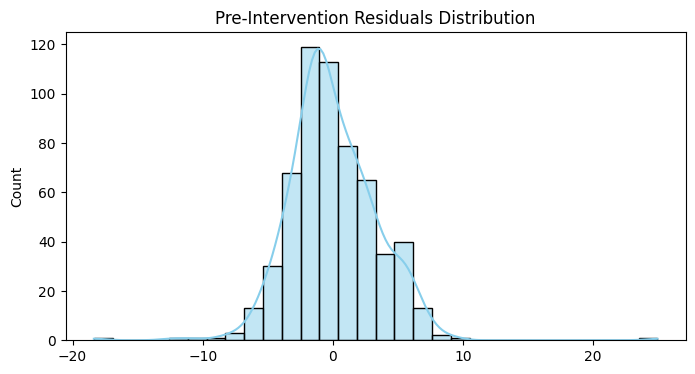

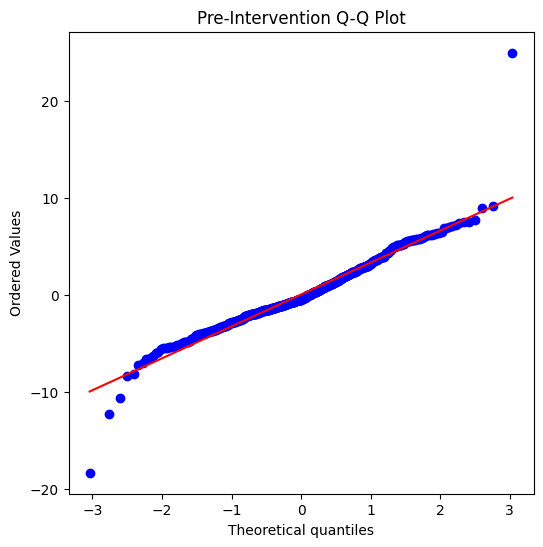

<Figure size 1000x400 with 0 Axes>

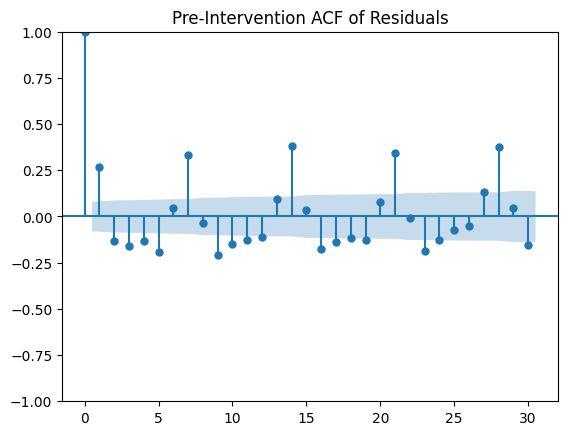

Shapiro-Wilk: stat=0.9487, p-value=0.0000
Durbin-Watson: 1.4080 (≈2 means no autocorrelation)


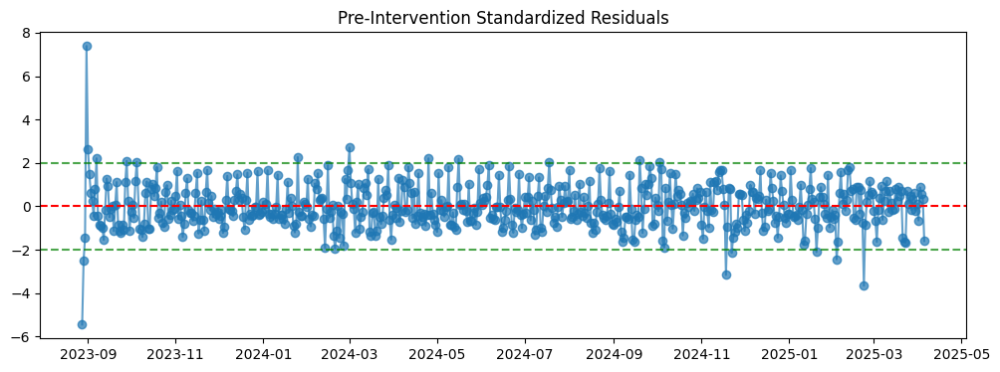

=== Residual Analysis: Post-Intervention ===


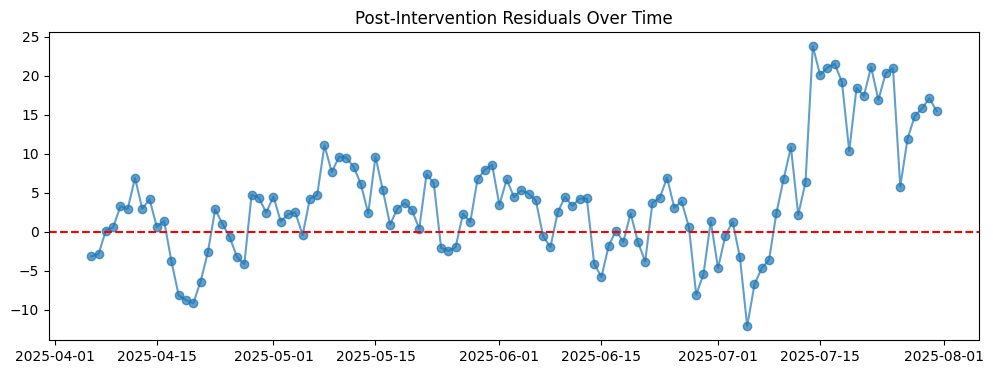

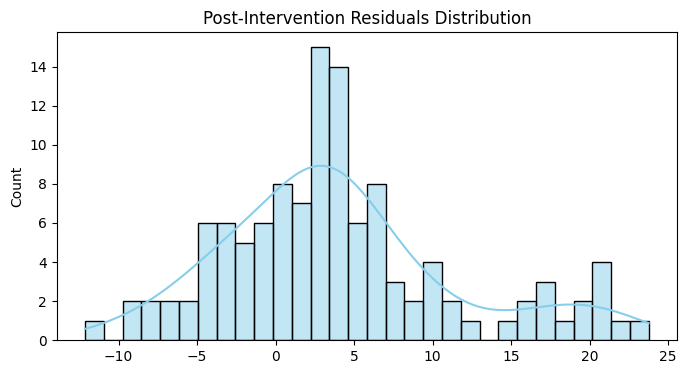

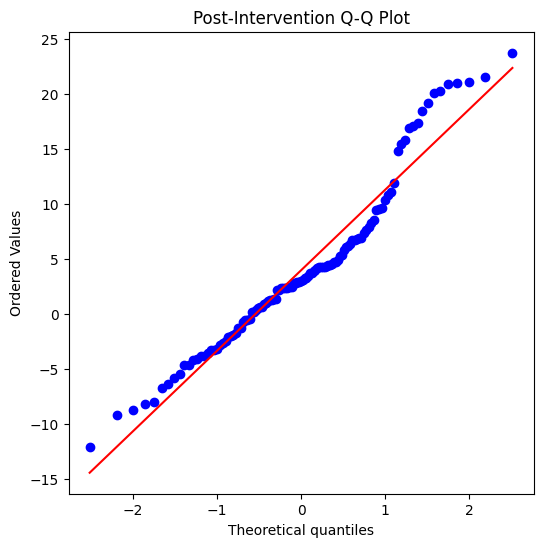

<Figure size 1000x400 with 0 Axes>

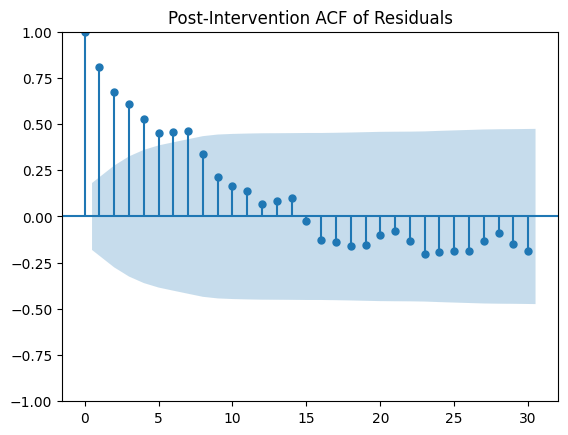

Shapiro-Wilk: stat=0.9470, p-value=0.0002
Durbin-Watson: 0.2731 (≈2 means no autocorrelation)


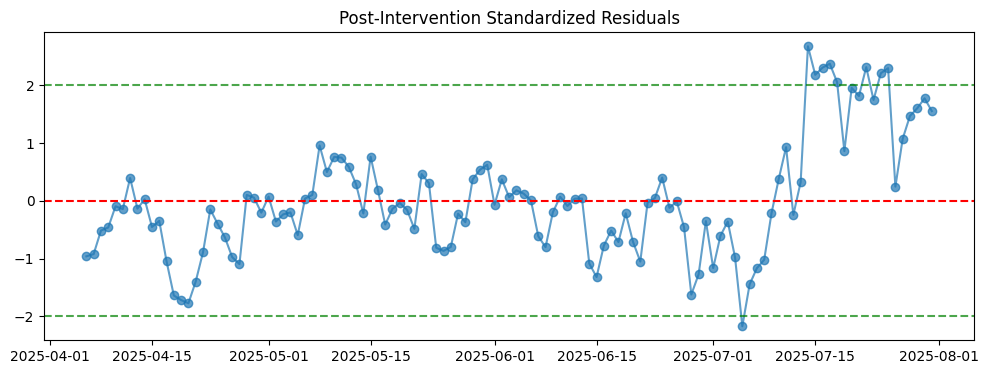

In [85]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf
from scipy import stats
from statsmodels.stats.stattools import durbin_watson

# -----------------------------
# 1. Extract residuals
# -----------------------------

y_obs = impact_boxcox.series.loc[start_date:end_date, "observed"]
y_pred = impact_boxcox.series.loc[start_date:end_date, "posterior_mean"] 

residuals = y_obs - y_pred

# Split into pre- and post-intervention
residuals_pre = residuals.loc[start_date:treatment_date]
residuals_post = residuals.loc[day_after_treatment:end_date]

# Function to analyze residuals
def analyze_residuals(res, period_name):
    print(f"=== Residual Analysis: {period_name} ===")
    
    # Residual over time
    plt.figure(figsize=(12, 4))
    plt.plot(res, marker='o', linestyle='-', alpha=0.7)
    plt.axhline(0, color='red', linestyle='--')
    plt.title(f"{period_name} Residuals Over Time")
    plt.show()
    
    # Histogram + KDE
    plt.figure(figsize=(8, 4))
    sns.histplot(res, kde=True, bins=30, color='skyblue')
    plt.title(f"{period_name} Residuals Distribution")
    plt.show()
    
    # Q-Q plot
    plt.figure(figsize=(6, 6))
    stats.probplot(res, dist="norm", plot=plt)
    plt.title(f"{period_name} Q-Q Plot")
    plt.show()
    
    # Autocorrelation
    plt.figure(figsize=(10, 4))
    plot_acf(res, lags=30)
    plt.title(f"{period_name} ACF of Residuals")
    plt.show()
    
    # Statistical tests
    shapiro_test = stats.shapiro(res)
    dw_stat = durbin_watson(res)
    print(f"Shapiro-Wilk: stat={shapiro_test.statistic:.4f}, p-value={shapiro_test.pvalue:.4f}")
    print(f"Durbin-Watson: {dw_stat:.4f} (≈2 means no autocorrelation)")
    
    # Standardized residuals
    res_std = (res - res.mean()) / res.std()
    plt.figure(figsize=(12, 4))
    plt.plot(res_std, marker='o', linestyle='-', alpha=0.7)
    plt.axhline(0, color='red', linestyle='--')
    plt.axhline(2, color='green', linestyle='--', alpha=0.7)
    plt.axhline(-2, color='green', linestyle='--', alpha=0.7)
    plt.title(f"{period_name} Standardized Residuals")
    plt.show()

# -----------------------------
# 2. Analyze pre- and post- residuals
# -----------------------------
analyze_residuals(residuals_pre, "Pre-Intervention")
analyze_residuals(residuals_post, "Post-Intervention")


# Velodrome Impact Analysis

In [78]:
raw_merged_data =  pd.read_parquet("../data/raw_merged_data.parquet")

In [79]:
velo = raw_merged_data[~raw_merged_data["velo_trx"].isna()]

In [80]:
velo.drop(columns = ["uni_trx", "aero_trx"], inplace = True)

C:\Users\vieir\AppData\Local\Temp\ipykernel_9036\3929904753.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  velo.drop(columns = ["uni_trx", "aero_trx"], inplace = True)


In [81]:
velo.isna().sum()

velo_trx             0
curve_trx           29
balancer_trx        29
Base_trx           418
Optmism_trx         29
Unichain_trx       917
Seneium_trx        947
eth_prices         826
eth_market_caps    826
eth_volume         826
eth_trx              0
dtype: int64

## Correlation analysis

In [82]:
merged_data = velo.copy()

In [83]:

# Define the treatment date
treatment_date = pd.to_datetime('2025-04-01')

# Separate data into pre-treatment and post-treatment periods
pre_treatment_data = merged_data[merged_data.index < treatment_date]
post_treatment_data = merged_data[merged_data.index >= treatment_date]
# temp_pre = pre_treatment_data[['uni_trx', series_name]].dropna()

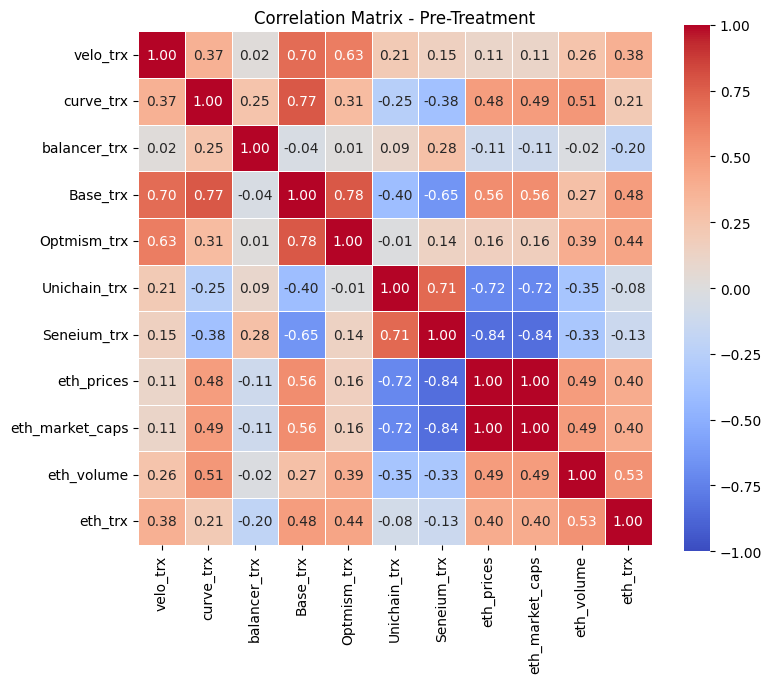

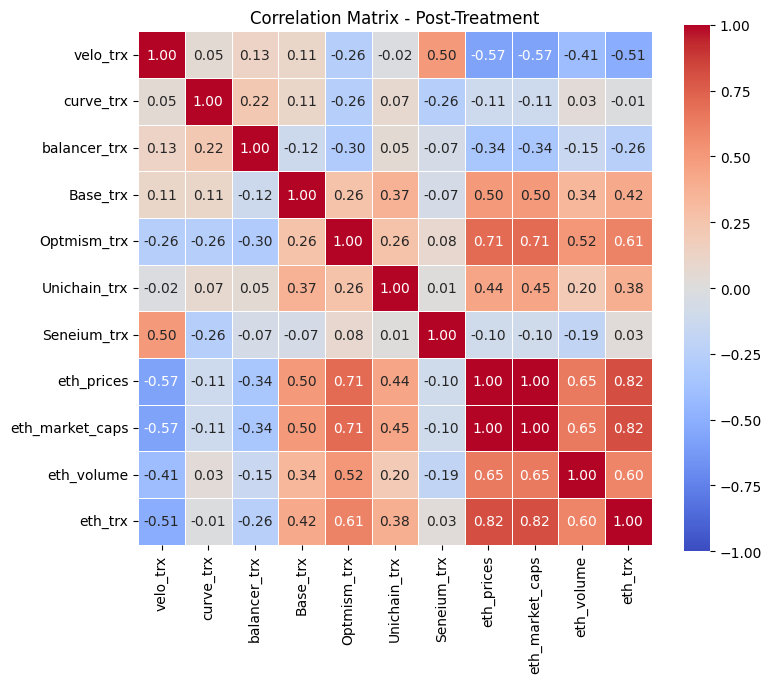

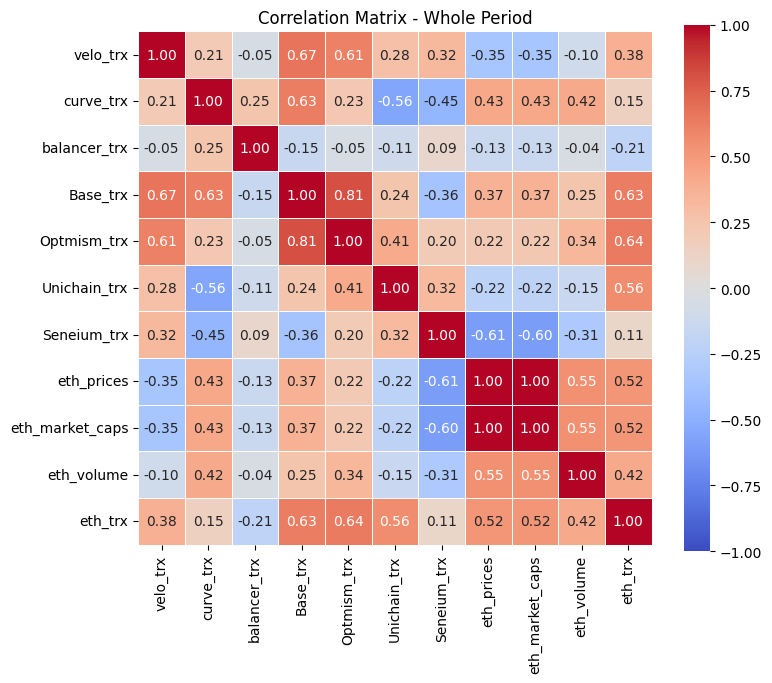

Pre-Treatment Correlations:
                 velo_trx  curve_trx  balancer_trx  Base_trx  Optmism_trx  \
velo_trx         1.000000   0.367331      0.016693  0.699036     0.630623   
curve_trx        0.367331   1.000000      0.250970  0.774530     0.310176   
balancer_trx     0.016693   0.250970      1.000000 -0.041720     0.013200   
Base_trx         0.699036   0.774530     -0.041720  1.000000     0.781046   
Optmism_trx      0.630623   0.310176      0.013200  0.781046     1.000000   
Unichain_trx     0.207292  -0.253192      0.089963 -0.398983    -0.010429   
Seneium_trx      0.151529  -0.379901      0.280104 -0.652384     0.135570   
eth_prices       0.109279   0.483931     -0.113306  0.556420     0.163592   
eth_market_caps  0.111329   0.485486     -0.113674  0.558097     0.164502   
eth_volume       0.255558   0.510074     -0.016487  0.273873     0.392536   
eth_trx          0.376463   0.205372     -0.203014  0.479054     0.439815   

                 Unichain_trx  Seneium_trx  eth

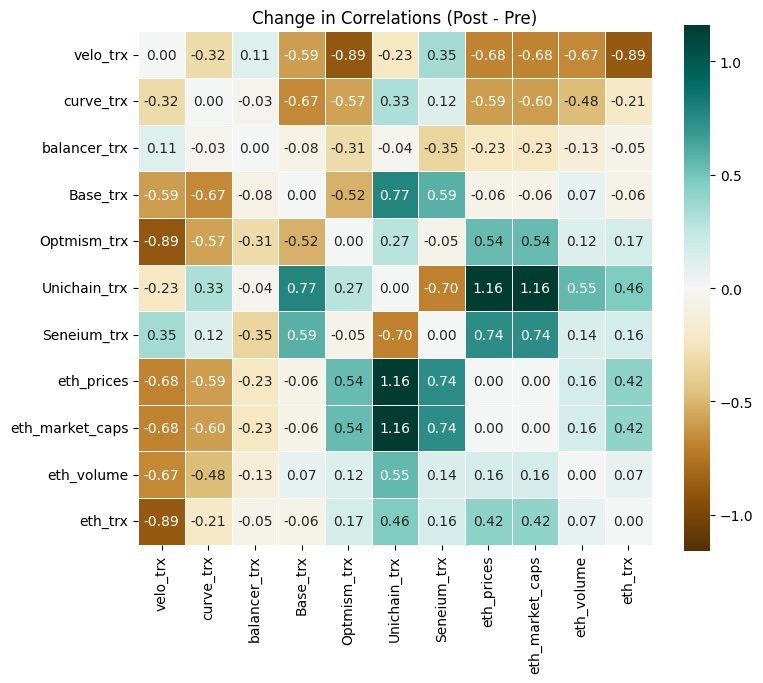

In [84]:

if not isinstance(merged_data.index, pd.DatetimeIndex):
    merged_data = merged_data.copy()
    merged_data.index = pd.to_datetime(merged_data.index)

# Split periods
pre_treatment_data = merged_data[merged_data.index < treatment_date]
post_treatment_data = merged_data[merged_data.index >= treatment_date]

# Use all numeric columns (so every variable is included)
numeric_cols = merged_data.select_dtypes(include=[np.number]).columns.tolist()

# Compute correlation matrices
corr_pre = pre_treatment_data[numeric_cols].corr()
corr_post = post_treatment_data[numeric_cols].corr()
corr_whole = merged_data[numeric_cols].corr()

# Helper: heatmap with smart annotation for large matrices
def plot_corr_heatmap(corr_df, title, annotate_threshold=15):
    annot = corr_df.shape[0] <= annotate_threshold  # avoid clutter on large matrices
    size = max(8, 0.55 * corr_df.shape[0])         # scale figure with number of vars
    plt.figure(figsize=(size, size))
    sns.heatmap(
        corr_df,
        vmin=-1, vmax=1, center=0,
        cmap='coolwarm',
        annot=annot, fmt=".2f" if annot else "",
        square=True, linewidths=0.5,
        cbar_kws={'shrink': 0.75}
    )
    plt.title(title)
    plt.tight_layout()
    plt.show()

# Plot per-period heatmaps
plot_corr_heatmap(corr_pre,  'Correlation Matrix - Pre-Treatment')
plot_corr_heatmap(corr_post, 'Correlation Matrix - Post-Treatment')
plot_corr_heatmap(corr_whole,'Correlation Matrix - Whole Period')

# Optional: print to console (and/or export to CSV)
print("Pre-Treatment Correlations:")
print(corr_pre)
print("\nPost-Treatment Correlations:")
print(corr_post)
print("\nWhole Period Correlations:")
print(corr_whole)

# Optional: visualize how correlations changed from pre to post
delta_corr = corr_post - corr_pre
v = np.nanmax(np.abs(delta_corr.values))
plt.figure(figsize=(max(8, 0.55 * delta_corr.shape[0]), max(8, 0.55 * delta_corr.shape[0])))
sns.heatmap(
    delta_corr,
    vmin=-v, vmax=v, center=0,
    cmap='BrBG',
    annot=delta_corr.shape[0] <= 15, fmt=".2f" if delta_corr.shape[0] <= 15 else "",
    square=True, linewidths=0.5,
    cbar_kws={'shrink': 0.75}
)
plt.title('Change in Correlations (Post - Pre)')
plt.tight_layout()
plt.show()

In [85]:
correlated_variables = ['velo_trx', "curve_trx", "Base_trx", "Optmism_trx",  "eth_trx"]

In [86]:
merged_data[correlated_variables].isna().sum()

velo_trx         0
curve_trx       29
Base_trx       418
Optmism_trx     29
eth_trx          0
dtype: int64

In [87]:

merged_data = merged_data[correlated_variables].copy()

In [88]:
merged_data[merged_data.curve_trx.isna()]

,velo_trx,curve_trx,Base_trx,Optmism_trx,eth_trx
2025-08-01,37766.0,<NA>,<NA>,<NA>,1758306.0
2025-08-02,24409.0,<NA>,<NA>,<NA>,1642345.0
2025-08-03,15409.0,<NA>,<NA>,<NA>,1515954.0
2025-08-04,18707.0,<NA>,<NA>,<NA>,1728281.0
2025-08-05,21597.0,<NA>,<NA>,<NA>,1877988.0
2025-08-06,18545.0,<NA>,<NA>,<NA>,1833756.0
2025-08-07,22195.0,<NA>,<NA>,<NA>,1766307.0
2025-08-08,22306.0,<NA>,<NA>,<NA>,1711849.0
2025-08-09,23962.0,<NA>,<NA>,<NA>,1645152.0
2025-08-10,20232.0,<NA>,<NA>,<NA>,1670117.0


## Velodrome causal impact analysis

In [89]:
import sys
import os
print(f"Python executable: {sys.executable}")
print(f"Virtual env active: {'causal_impact_env' in sys.executable}")

# Test the import
import causalimpact
print("✅ CausalImpact imported successfully!")

# Check TensorFlow is working
import tensorflow as tf
print(f"TensorFlow version: {tf.__version__}")

Python executable: C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Scripts\python.exe
Virtual env active: True
✅ CausalImpact imported successfully!
TensorFlow version: 2.20.0


In [90]:
import sys
print("path:", getattr(causalimpact, "__file__", None))
print("version:", getattr(causalimpact, "__version__", "n/a"))
print("has fit_causalimpact:", hasattr(causalimpact, "fit_causalimpact"))

path: C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\__init__.py
version: 0.2.0
has fit_causalimpact: True


## Box cox transformation Analysis

In [91]:

merged_data= merged_data.apply(pd.to_numeric, errors="coerce").astype("float64")

### Key Dates
start_date = "2023-08-01"
treatment_date = "2025-04-05"
day_after_treatment = "2025-04-06"
end_date = "2025-07-31"

In [92]:
### some missing values on the series
merged_data_filled = merged_data.copy()
merged_data_filled = merged_data_filled[(merged_data_filled.index >= start_date) & (merged_data_filled.index <= end_date)]



In [93]:
merged_data_filled.columns

Index(['velo_trx', 'curve_trx', 'Base_trx', 'Optmism_trx', 'eth_trx'], dtype='object')

In [94]:
boxcox= merged_data_filled.copy()

In [95]:
boxcox.head()

,velo_trx,curve_trx,Base_trx,Optmism_trx,eth_trx
2023-08-01,18621.0,341.0,158837.0,675865.0,1068108.0
2023-08-02,14235.0,162.0,145005.0,547768.0,1042149.0
2023-08-03,24576.0,160.0,458089.0,660791.0,1049539.0
2023-08-04,18867.0,236.0,253225.0,645983.0,1075359.0
2023-08-05,16431.0,301.0,264869.0,559862.0,1124372.0


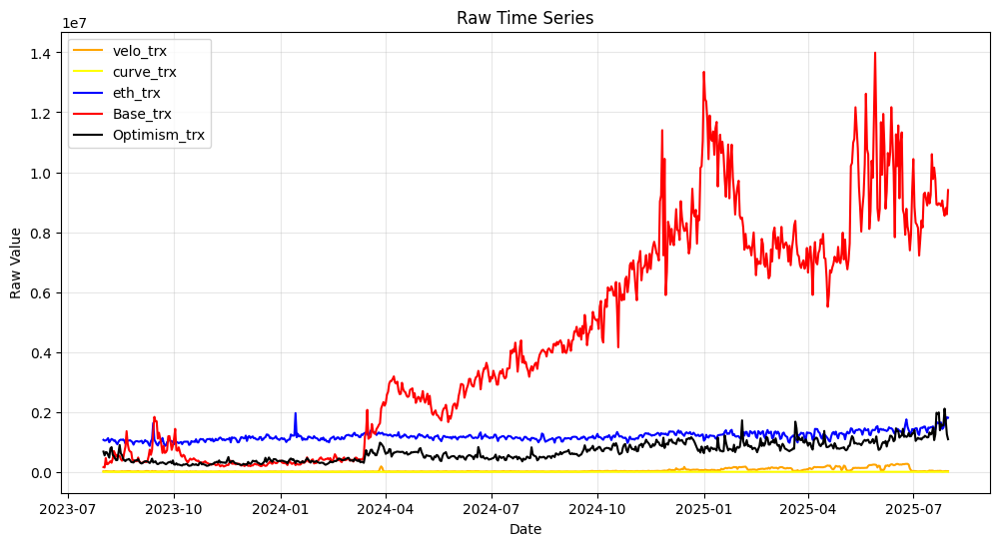

In [96]:
plt.figure(figsize=(12,6))

# Plot each series against the time index
plt.plot(boxcox.index, boxcox["velo_trx"], color="orange", label="velo_trx")
plt.plot(boxcox.index, boxcox["curve_trx"], color="yellow", label="curve_trx")
plt.plot(boxcox.index, boxcox["eth_trx"], color="blue", label="eth_trx")
plt.plot(boxcox.index, boxcox["Base_trx"], color="red", label="Base_trx")
plt.plot(boxcox.index, boxcox["Optmism_trx"], color="black", label="Optimism_trx")

plt.xlabel('Date')
plt.ylabel('Raw Value')
plt.title('Raw Time Series')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

In [97]:
boxcox.describe()

,velo_trx,curve_trx,Base_trx,Optmism_trx,eth_trx
count,730.000000,730.000000,7.300000e+02,7.300000e+02,7.300000e+02
mean,45466.730137,1144.816438,4.437075e+06,6.669655e+05,1.189605e+06
std,61295.741334,807.728427,3.612100e+06,3.192376e+05,1.413474e+05
min,2688.000000,119.000000,1.450050e+05,2.012000e+05,8.635030e+05
25%,8020.750000,592.500000,5.263410e+05,3.951802e+05,1.097158e+06
50%,15580.000000,910.000000,3.700450e+06,6.317050e+05,1.166792e+06
75%,57665.750000,1503.750000,7.514812e+06,8.792442e+05,1.265160e+06
max,268006.000000,6329.000000,1.399030e+07,2.109142e+06,1.961144e+06


In [98]:
boxcox.columns

Index(['velo_trx', 'curve_trx', 'Base_trx', 'Optmism_trx', 'eth_trx'], dtype='object')

##### Box-cox Alpha analysis

Finding optimal lambda for velo_trx...


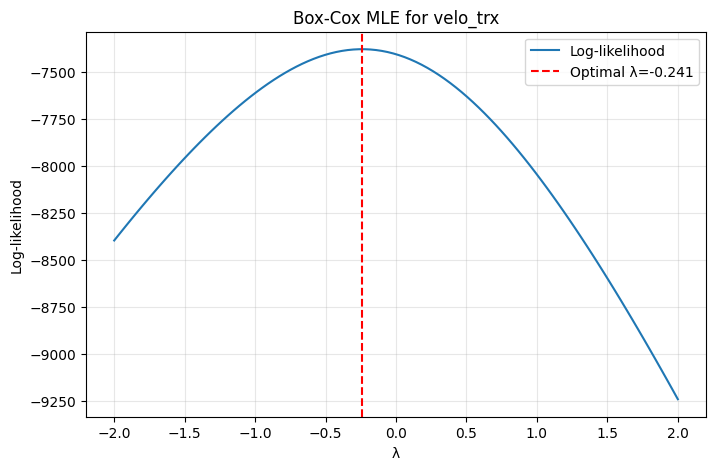

Finding optimal lambda for curve_trx...


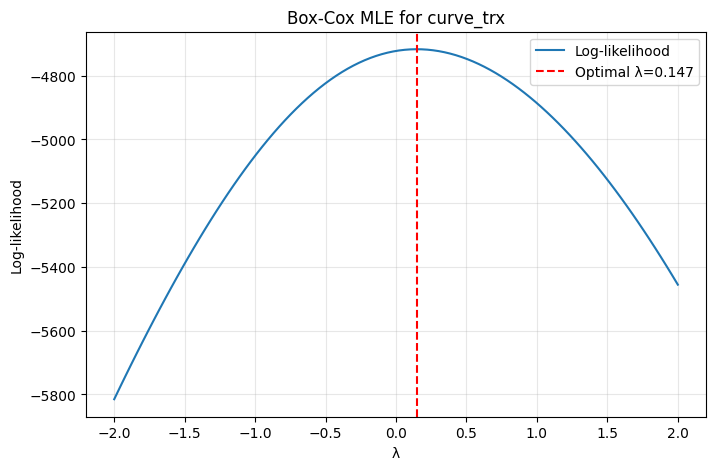

Finding optimal lambda for Base_trx...


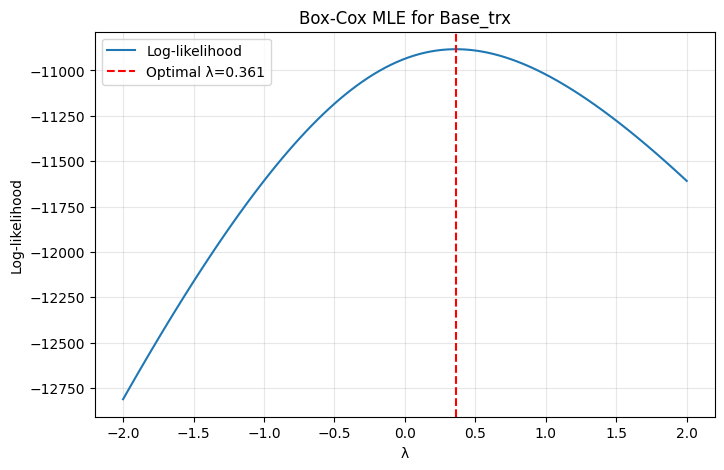

Finding optimal lambda for Optmism_trx...


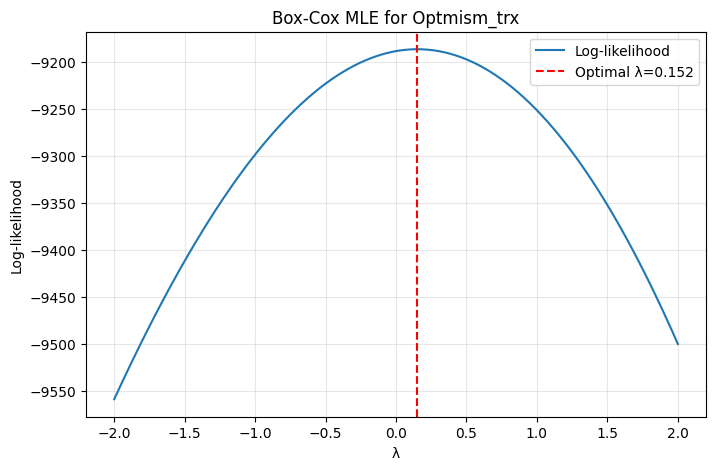

Finding optimal lambda for eth_trx...


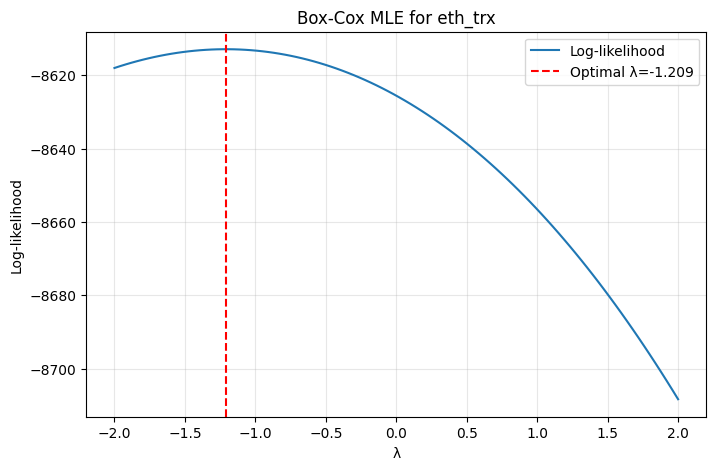


Optimal Lambda Values for Each Column:
             Optimal Lambda
velo_trx          -0.241466
curve_trx          0.147347
Base_trx           0.361301
Optmism_trx        0.151684
eth_trx           -1.209351


In [99]:
# Box-Cox transformation 

from scipy import stats


boxcox = boxcox[(boxcox.index >= start_date) & (boxcox.index <= end_date)]

# Function to find optimal lambda for Box-Cox transformation
def find_optimal_lambda(data_series, column_name):
    """Find the optimal lambda parameter for Box-Cox transformation with likelihood profile."""
    data = data_series.copy()
    if (data <= 0).any():
        print(f"Warning: {column_name} contains zeros or negative values. Adding offset...")
        offset = abs(data.min()) + 1
        data = data + offset

    # 1. Optimal lambda (MLE)
    fitted_lambda = stats.boxcox_normmax(data, method='mle')

    # 2. Evaluate log-likelihood across a range
    lambdas = np.linspace(-2, 2, 100)
    llf = [stats.boxcox_llf(lmb, data) for lmb in lambdas]

    # Plot profile likelihood
    plt.figure(figsize=(8, 5))
    plt.plot(lambdas, llf, label='Log-likelihood')
    plt.axvline(fitted_lambda, color='red', linestyle='--', label=f'Optimal λ={fitted_lambda:.3f}')
    plt.xlabel('λ')
    plt.ylabel('Log-likelihood')
    plt.title(f'Box-Cox MLE for {column_name}')
    plt.legend()
    plt.grid(alpha=0.3)
    plt.show()

    return fitted_lambda

# Find optimal lambda for each column and store results
lambda_values = {}
columns_to_transform = ['velo_trx', 'curve_trx', 'Base_trx', 'Optmism_trx', 'eth_trx']

for col in columns_to_transform:
    if col in boxcox.columns:
        print(f"Finding optimal lambda for {col}...")
        lambda_values[col] = find_optimal_lambda(merged_data_filled[col], col)

# Display all optimal lambda values
lambda_df = pd.DataFrame.from_dict(lambda_values, orient='index', columns=['Optimal Lambda'])
print("\nOptimal Lambda Values for Each Column:")
print(lambda_df)

In [100]:
lambda_values

{'velo_trx': np.float64(-0.24146629595773483),
 'curve_trx': np.float64(0.14734672521363001),
 'Base_trx': np.float64(0.3613012380971313),
 'Optmism_trx': np.float64(0.15168402283536095),
 'eth_trx': np.float64(-1.209350927047231)}

In [101]:
# Apply Box-Cox transformation to the data
def apply_boxcox_transform(data, lambda_values):
    """
    Apply Box-Cox transformation to each column in the dataframe
    using the provided lambda values.
    
    Parameters:
    -----------
    data : pandas.DataFrame
        The dataframe to transform
    lambda_values : dict
        Dictionary mapping column names to their optimal lambda values
    
    Returns:
    --------
    pandas.DataFrame
        Transformed dataframe
    dict
        Dictionary of offsets applied to make data positive (for inverse transform)
    """
    transformed_data = pd.DataFrame(index=data.index)
    offsets = {}
    
    for col, lambda_val in lambda_values.items():
        if col in data.columns:
            series = data[col].copy()
            
            # Check if we need to add an offset (Box-Cox requires positive values)
            offset = 0
            if (series <= 0).any():
                offset = abs(series.min()) + 1
                series = series + offset
                offsets[col] = offset
            
            # Apply Box-Cox transformation
            if abs(lambda_val) < 1e-10:  # lambda ≈ 0
                transformed_data[col] = np.log(series)
            else:
                transformed_data[col] = (series**lambda_val - 1) / lambda_val
                
            # Add a note about the transformation
            print(f"Transformed {col} with lambda={lambda_val:.4f}" + 
                  (f" and offset={offset}" if offset > 0 else ""))
    
    return transformed_data, offsets



# # Save the transformed data
# merged_data_boxcox.to_parquet('../data/merged_data_boxcox.parquet')


Transformed velo_trx with lambda=-0.2415
Transformed curve_trx with lambda=0.1473
Transformed Base_trx with lambda=0.3613
Transformed Optmism_trx with lambda=0.1517
Transformed eth_trx with lambda=-1.2094


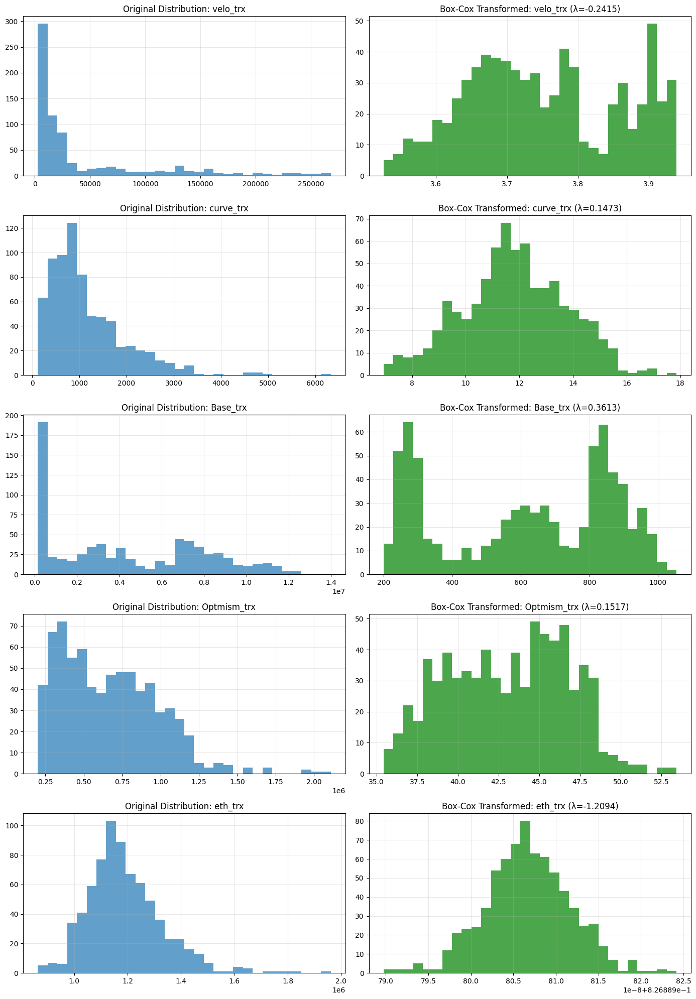

In [102]:
# Apply the transformation
merged_data_boxcox, offsets = apply_boxcox_transform(boxcox, lambda_values)

# Compare original and transformed distributions for a few key columns
key_columns = ['velo_trx', 'curve_trx', 'Base_trx', 'Optmism_trx', 'eth_trx']
fig, axes = plt.subplots(len(key_columns), 2, figsize=(14, 4*len(key_columns)))

for i, col in enumerate(key_columns):
    if col in boxcox.columns and col in merged_data_boxcox.columns:
        # Original data histogram
        axes[i, 0].hist(boxcox[col], bins=30, alpha=0.7)
        axes[i, 0].set_title(f'Original Distribution: {col}')
        axes[i, 0].grid(alpha=0.3)
        
        # Transformed data histogram
        axes[i, 1].hist(merged_data_boxcox[col], bins=30, alpha=0.7, color='green')
        axes[i, 1].set_title(f'Box-Cox Transformed: {col} (λ={lambda_values[col]:.4f})')
        axes[i, 1].grid(alpha=0.3)

plt.tight_layout()
plt.show()

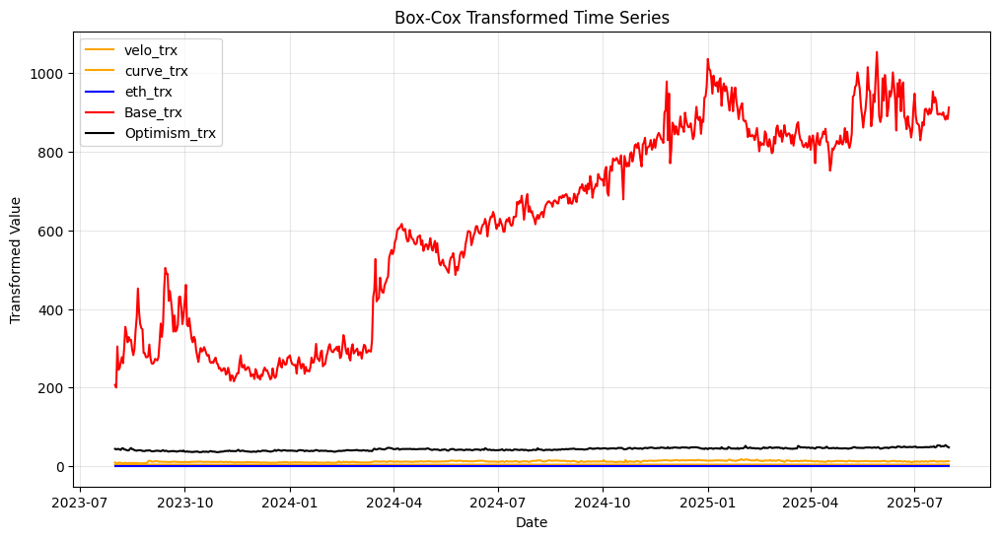

In [103]:
merged_data_boxcox

plt.figure(figsize=(12,6))

# Plot each series against the time index
plt.plot(merged_data_boxcox.index, merged_data_boxcox["velo_trx"], color="orange", label="velo_trx")
plt.plot(merged_data_boxcox.index, merged_data_boxcox["curve_trx"], color="orange", label="curve_trx")
plt.plot(merged_data_boxcox.index, merged_data_boxcox["eth_trx"], color="blue", label="eth_trx")
plt.plot(merged_data_boxcox.index, merged_data_boxcox["Base_trx"], color="red", label="Base_trx")
plt.plot(merged_data_boxcox.index, merged_data_boxcox["Optmism_trx"], color="black", label="Optimism_trx")

plt.xlabel('Date')
plt.ylabel('Transformed Value')
plt.title('Box-Cox Transformed Time Series')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

In [104]:
# Running Causal Impact analysis with Box-Cox transformed data

# Define analysis periods
start_date = "2023-08-01"
treatment_date = "2025-04-05"
day_after_treatment = "2025-04-06"
end_date = "2025-07-31"

# Select columns for analysis
analysis_columns = ['velo_trx', 'curve_trx', 'Base_trx', 'Optmism_trx', 'eth_trx']
boxcox_data_for_analysis = merged_data_boxcox[analysis_columns].copy()

# Run causal impact analysis on Box-Cox transformed data
impact_boxcox = causalimpact.fit_causalimpact(
    data=boxcox_data_for_analysis,
    pre_period=(start_date, treatment_date),
    post_period=(day_after_treatment, end_date))


In [105]:
# Plot the results
causalimpact.plot(impact_boxcox)

alt.FacetChart(...)

In [106]:
# Print summary
print(causalimpact.summary(impact_boxcox, output_format='summary'))


Posterior Inference {CausalImpact}
                          Average            Cumulative
Actual                    3.9                452.9
Prediction (s.d.)         3.9 (0.03)         455.9 (3.91)
95% CI                    [3.8, 4.0]         [448.1, 463.7]

Absolute effect (s.d.)    -0.0 (0.03)        -3.0 (3.91)
95% CI                    [-0.1, 0.0]        [-10.7, 4.8]

Relative effect (s.d.)    -0.6% (0.9%)       -0.6% (1.0%)
95% CI                    [-2.3%, 1.1%]      [-2.3%, 1.1%]

Posterior tail-area probability p: 0.213
Posterior prob. of a causal effect: 78.69%

For more details run the command: summary(impact, output_format="report")


C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]


In [107]:
print(causalimpact.summary(impact_boxcox, output_format='report'))


Analysis report {CausalImpact}


During the post-intervention period, the response variable had
an average value of approx. 3.9. In the absence of an
intervention, we would have expected an average response of 3.9.
The 95% interval of this counterfactual prediction is [3.8, 4.0].
Subtracting this prediction from the observed response yields
an estimate of the causal effect the intervention had on the
response variable. This effect is -0.0 with a 95% interval of
[-0.1, 0.0]. For a discussion of the significance of this effect,
see below.


Summing up the individual data points during the post-intervention
period (which can only sometimes be meaningfully interpreted), the
response variable had an overall value of 452.9.
Had the intervention not taken place, we would have expected
a sum of 455.9. The 95% interval of this prediction is [448.1, 463.7].


The above results are given in terms of absolute numbers. In relative
terms, the response variable showed a decrease of -0.6%. The 95%
in

C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]


In [108]:
# Calculate model quality metrics
y_pre = impact_boxcox.series.loc[start_date:treatment_date, "observed"].values
yhat_pre = impact_boxcox.series.loc[start_date:treatment_date, "posterior_mean"].values

# Residuals
resid = y_pre - yhat_pre

# RMSE and R²
rmse = np.sqrt(np.mean(resid**2))
ss_res = np.sum(resid**2)
ss_tot = np.sum((y_pre - y_pre.mean())**2)
r2 = 1 - ss_res / ss_tot

print("\nBox-Cox Transformed Model Quality:")
print(f"Pre-period RMSE: {rmse:.6f}")
print(f"Pre-period R²: {r2:.6f}")


Box-Cox Transformed Model Quality:
Pre-period RMSE: 0.033637
Pre-period R²: 0.879785


### Checking residuals

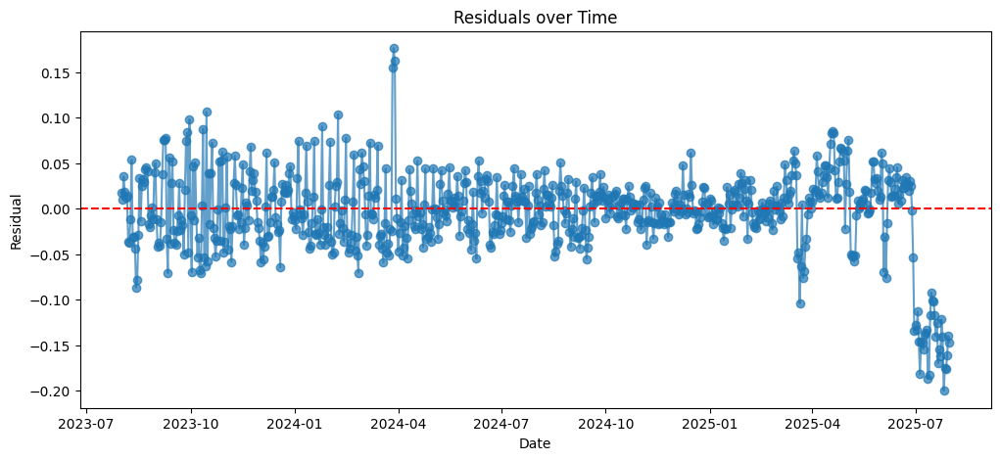

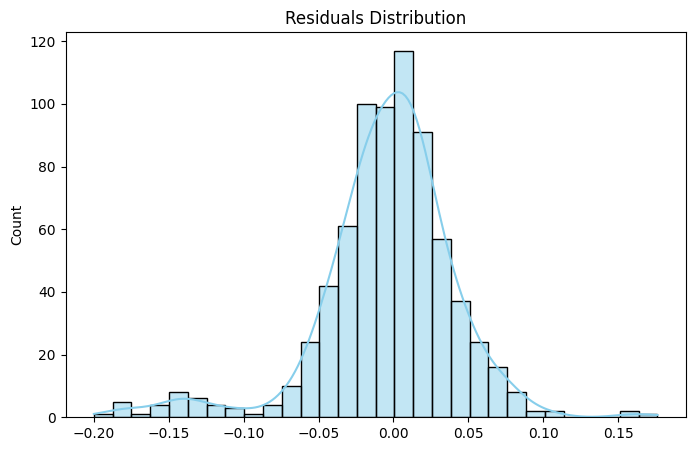

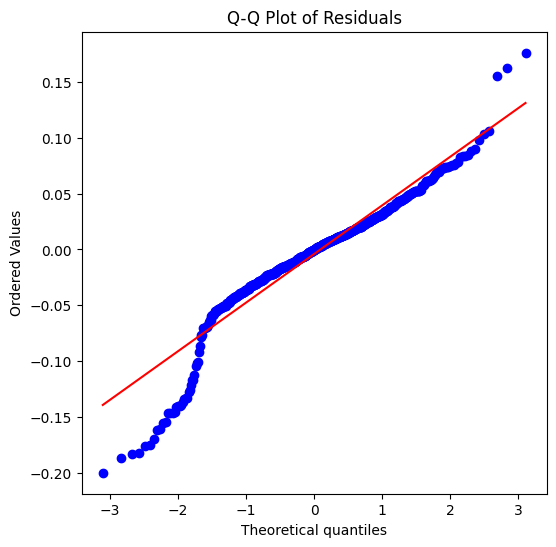

<Figure size 1000x400 with 0 Axes>

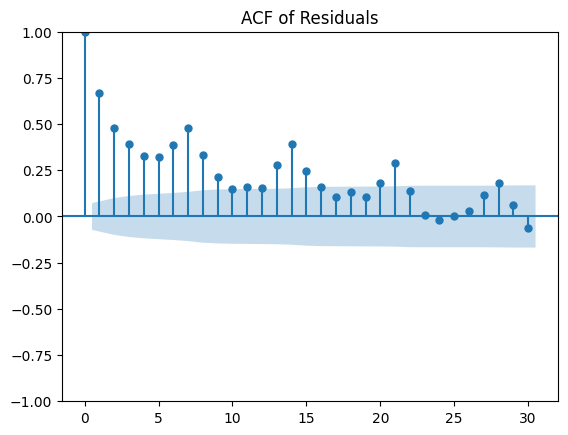

Shapiro-Wilk test: statistic=0.9202, p-value=0.0000
Durbin-Watson statistic: 0.6484 (≈2 means no autocorrelation)


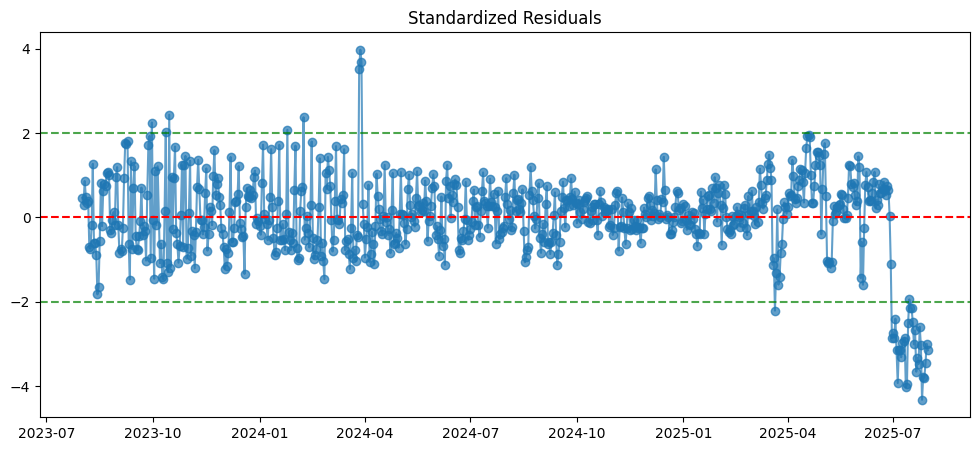

In [109]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf
from scipy import stats
import numpy as np
from statsmodels.stats.stattools import durbin_watson

# -----------------------------
# 1. Extract residuals
# -----------------------------
y_obs = impact_boxcox.series.loc[start_date:end_date, "observed"]
y_pred = impact_boxcox.series.loc[start_date:end_date, "posterior_mean"]

residuals = y_obs - y_pred

# -----------------------------
# 2. Residual plot
# -----------------------------
plt.figure(figsize=(12, 5))
plt.plot(residuals, marker='o', linestyle='-', alpha=0.7)
plt.axhline(0, color='red', linestyle='--')
plt.title("Residuals over Time")
plt.xlabel("Date")
plt.ylabel("Residual") 
plt.show()

# -----------------------------
# 3. Histogram and KDE
# -----------------------------
plt.figure(figsize=(8, 5))
sns.histplot(residuals, kde=True, bins=30, color='skyblue')
plt.title("Residuals Distribution")
plt.show()

# -----------------------------
# 4. Q-Q Plot for normality
# -----------------------------
plt.figure(figsize=(6, 6))
stats.probplot(residuals, dist="norm", plot=plt)
plt.title("Q-Q Plot of Residuals")
plt.show()

# -----------------------------
# 5. Autocorrelation check
# -----------------------------
plt.figure(figsize=(10, 4))
plot_acf(residuals, lags=30)
plt.title("ACF of Residuals")
plt.show()

# -----------------------------
# 6. Statistical tests
# -----------------------------
shapiro_test = stats.shapiro(residuals)
print(f"Shapiro-Wilk test: statistic={shapiro_test.statistic:.4f}, p-value={shapiro_test.pvalue:.4f}")

dw_stat = durbin_watson(residuals)
print(f"Durbin-Watson statistic: {dw_stat:.4f} (≈2 means no autocorrelation)")

# -----------------------------
# 7. Optional: standardized residuals
# -----------------------------
residuals_std = (residuals - residuals.mean()) / residuals.std()
plt.figure(figsize=(12, 5))
plt.plot(residuals_std, marker='o', linestyle='-', alpha=0.7)
plt.axhline(0, color='red', linestyle='--')
plt.axhline(2, color='green', linestyle='--', alpha=0.7)
plt.axhline(-2, color='green', linestyle='--', alpha=0.7)
plt.title("Standardized Residuals")
plt.show()


=== Residual Analysis: Pre-Intervention ===


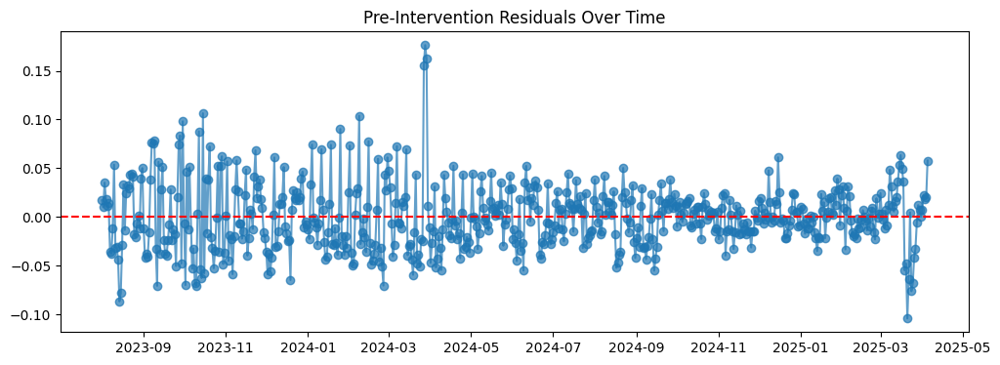

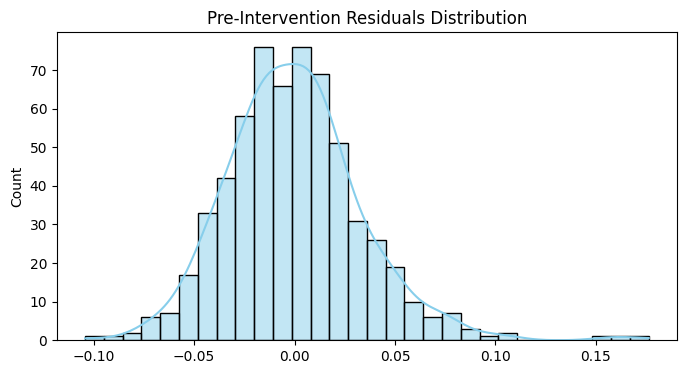

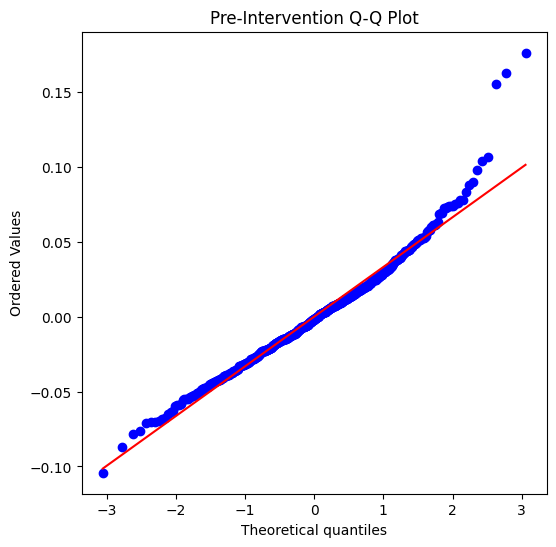

<Figure size 1000x400 with 0 Axes>

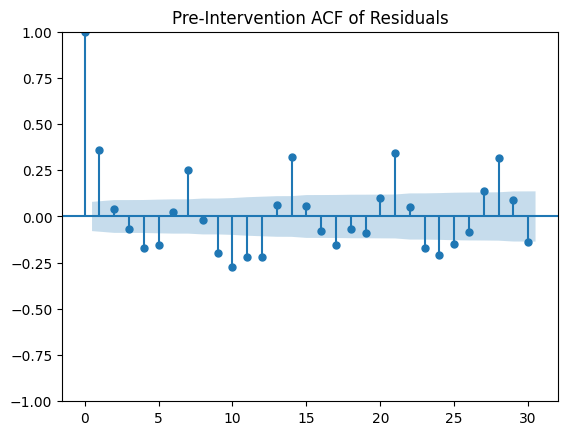

Shapiro-Wilk: stat=0.9689, p-value=0.0000
Durbin-Watson: 1.2786 (≈2 means no autocorrelation)


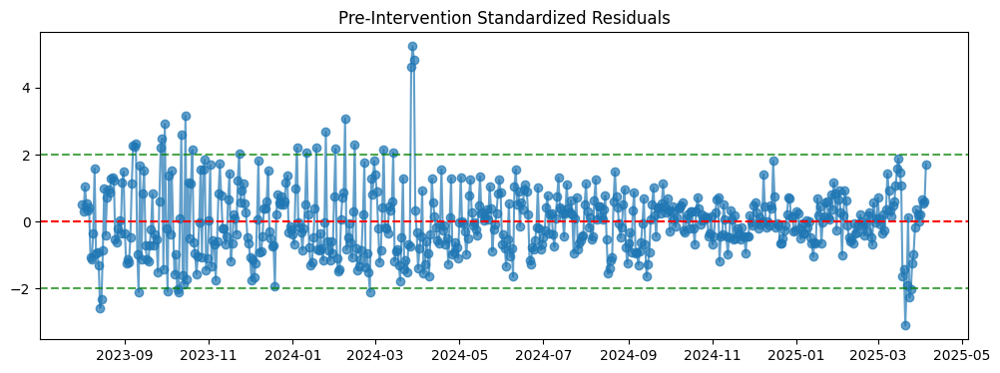

=== Residual Analysis: Post-Intervention ===


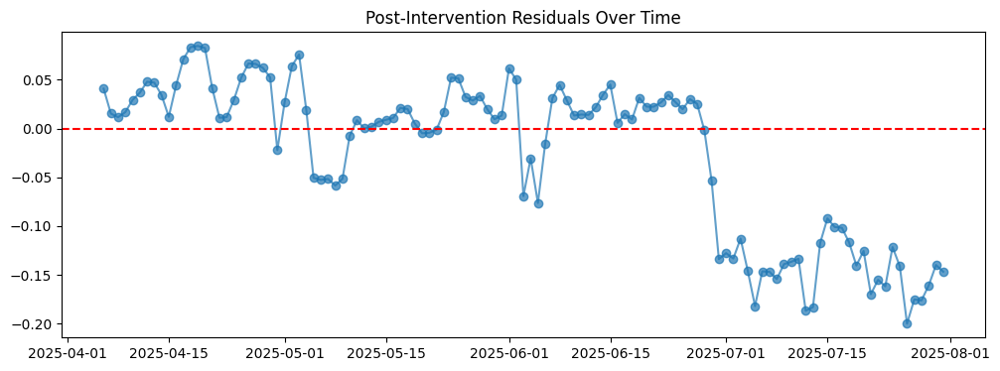

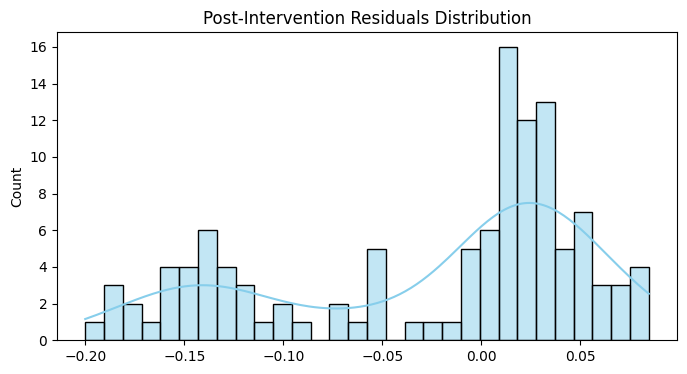

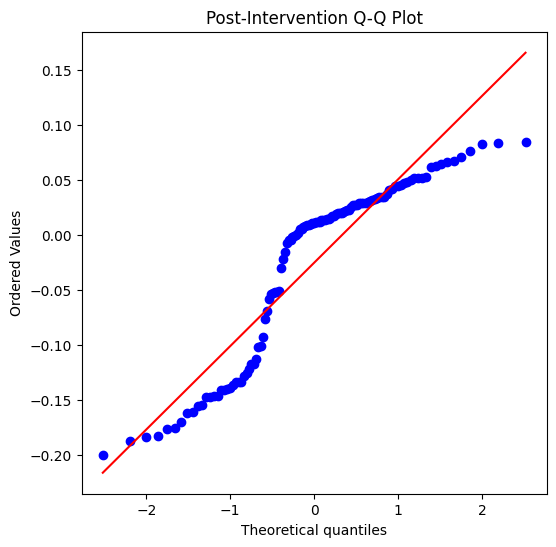

<Figure size 1000x400 with 0 Axes>

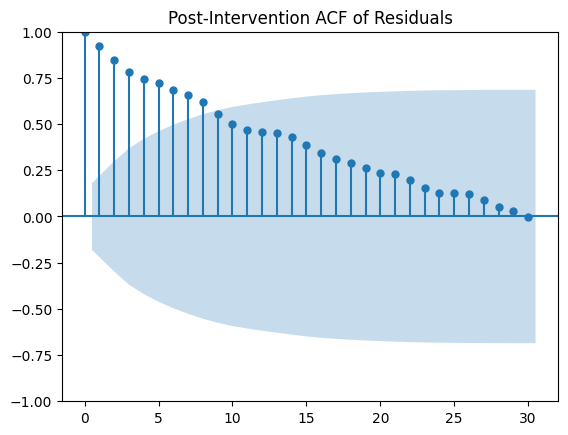

Shapiro-Wilk: stat=0.8660, p-value=0.0000
Durbin-Watson: 0.1127 (≈2 means no autocorrelation)


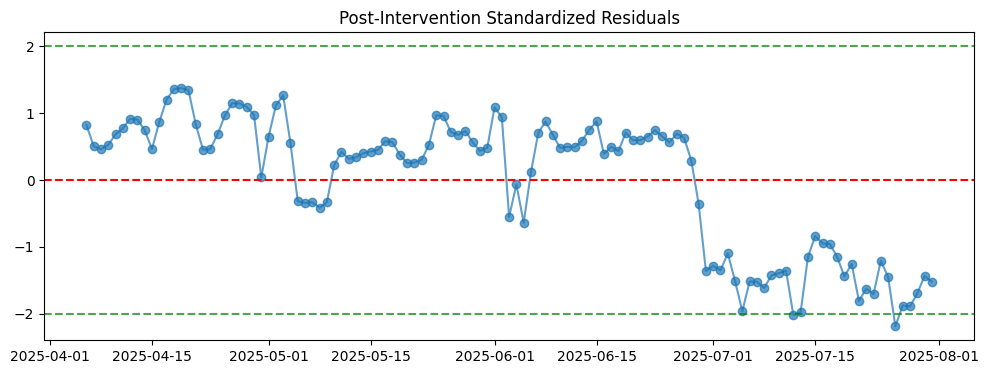

In [110]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf
from scipy import stats
from statsmodels.stats.stattools import durbin_watson

# -----------------------------
# 1. Extract residuals
# -----------------------------

y_obs = impact_boxcox.series.loc[start_date:end_date, "observed"]
y_pred = impact_boxcox.series.loc[start_date:end_date, "posterior_mean"] 

residuals = y_obs - y_pred

# Split into pre- and post-intervention
residuals_pre = residuals.loc[start_date:treatment_date]
residuals_post = residuals.loc[day_after_treatment:end_date]

# Function to analyze residuals
def analyze_residuals(res, period_name):
    print(f"=== Residual Analysis: {period_name} ===")
    
    # Residual over time
    plt.figure(figsize=(12, 4))
    plt.plot(res, marker='o', linestyle='-', alpha=0.7)
    plt.axhline(0, color='red', linestyle='--')
    plt.title(f"{period_name} Residuals Over Time")
    plt.show()
    
    # Histogram + KDE
    plt.figure(figsize=(8, 4))
    sns.histplot(res, kde=True, bins=30, color='skyblue')
    plt.title(f"{period_name} Residuals Distribution")
    plt.show()
    
    # Q-Q plot
    plt.figure(figsize=(6, 6))
    stats.probplot(res, dist="norm", plot=plt)
    plt.title(f"{period_name} Q-Q Plot")
    plt.show()
    
    # Autocorrelation
    plt.figure(figsize=(10, 4))
    plot_acf(res, lags=30)
    plt.title(f"{period_name} ACF of Residuals")
    plt.show()
    
    # Statistical tests
    shapiro_test = stats.shapiro(res)
    dw_stat = durbin_watson(res)
    print(f"Shapiro-Wilk: stat={shapiro_test.statistic:.4f}, p-value={shapiro_test.pvalue:.4f}")
    print(f"Durbin-Watson: {dw_stat:.4f} (≈2 means no autocorrelation)")
    
    # Standardized residuals
    res_std = (res - res.mean()) / res.std()
    plt.figure(figsize=(12, 4))
    plt.plot(res_std, marker='o', linestyle='-', alpha=0.7)
    plt.axhline(0, color='red', linestyle='--')
    plt.axhline(2, color='green', linestyle='--', alpha=0.7)
    plt.axhline(-2, color='green', linestyle='--', alpha=0.7)
    plt.title(f"{period_name} Standardized Residuals")
    plt.show()

# -----------------------------
# 2. Analyze pre- and post- residuals
# -----------------------------
analyze_residuals(residuals_pre, "Pre-Intervention")
analyze_residuals(residuals_post, "Post-Intervention")


### checking counterfactual variables predictive power 

In [111]:

### R2 and RMSE 
## error on the predicted period 

# Extract observed and predicted for the pre-period only
y_pre = impact_boxcox.series.loc[start_date:treatment_date, "observed"].values
yhat_pre = impact_boxcox.series.loc[start_date:treatment_date, "posterior_mean"].values

# Residuals
resid = y_pre - yhat_pre

# RMSE and R²
rmse = np.sqrt(np.mean(resid**2))
ss_res = np.sum(resid**2)
ss_tot = np.sum((y_pre - y_pre.mean())**2)
r2 = 1 - ss_res / ss_tot

print("Pre-period RMSE:", rmse)
print("Pre-period R²:", r2)





Pre-period RMSE: 0.03363670941109335
Pre-period R²: 0.8797852843098979


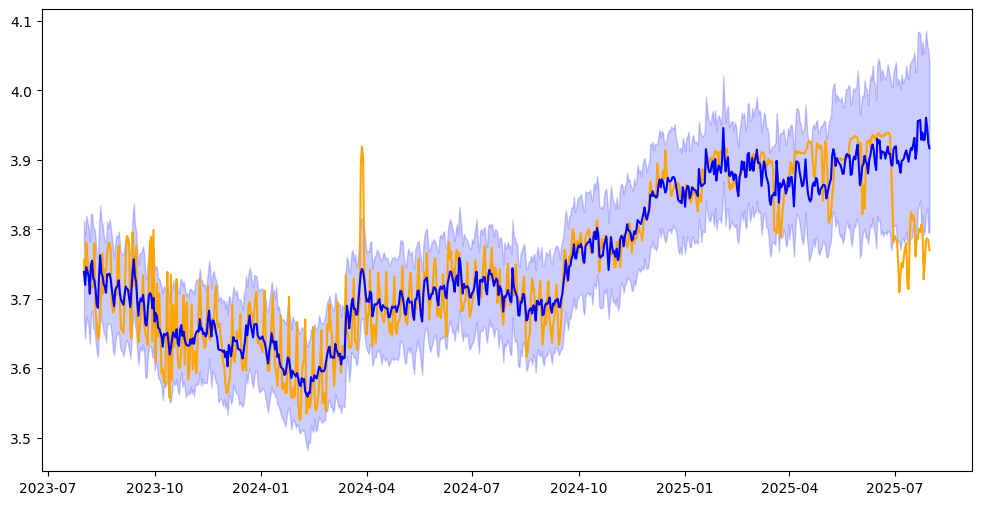

In [112]:
import matplotlib.pyplot as plt

# Extract series from the fitted object
df_plot = impact_boxcox.series

plt.figure(figsize=(12,6))
plt.plot(df_plot.index, df_plot["observed"], color="orange", label="Observed")
plt.plot(df_plot.index, df_plot["posterior_mean"], color="blue", label="Posterior mean")
plt.fill_between(
    df_plot.index,
    df_plot["posterior_lower"],
    df_plot["posterior_upper"],
    color="blue",
    alpha=0.2,
    label="95% credible interval"
)

In [113]:
# Get posterior draws for regression weights
weights = np.asarray(impact_boxcox.posterior_samples.weights)  # shape: (n_draws, n_predictors)

# Split intercept and covariate betas
intercept_draws = weights[:, 0]
beta_draws = weights[:, 1:]  # assume col 0 is intercept, then your covariates

# Name your covariates in the same order used to fit the model
covariate_names = [ 'curve_trx', 'Base_trx', 'Optmism_trx', 'eth_trx']
assert beta_draws.shape[1] == len(covariate_names), (
    f"Expected {len(covariate_names)} betas, got {beta_draws.shape[1]}"
)

# Summaries
for i, name in enumerate(covariate_names):
    b = beta_draws[:, i]
    mean = b.mean()
    lower, upper = np.quantile(b, [0.025, 0.975])
    p_pos = (b > 0).mean()
    p_neg = (b < 0).mean()
    print(f"{name}: mean={mean:.4f}, 95% CI=({lower:.4f},{upper:.4f}), "
          f"P(>0)={p_pos:.3f}, P(<0)={p_neg:.3f}")

curve_trx: mean=0.2751, 95% CI=(0.0000,0.4797), P(>0)=0.883, P(<0)=0.000
Base_trx: mean=0.3223, 95% CI=(0.2306,0.4321), P(>0)=1.000, P(<0)=0.000
Optmism_trx: mean=0.0919, 95% CI=(0.0000,0.1421), P(>0)=0.973, P(<0)=0.000
eth_trx: mean=0.0066, 95% CI=(0.0000,0.1495), P(>0)=0.061, P(<0)=0.019


### Fitting the model using just relevatn Betas 

In [114]:
# Running Causal Impact analysis with Box-Cox transformed data

# Define analysis periods
start_date = "2023-08-01"
treatment_date = "2025-04-05"
day_after_treatment = "2025-04-06"
end_date = "2025-07-31"

# Select columns for analysis
analysis_columns = ['velo_trx', 'Base_trx', 'curve_trx', 'Optmism_trx' ]
boxcox_data_for_analysis = merged_data_boxcox[analysis_columns].copy()

# Run causal impact analysis on Box-Cox transformed data
impact_boxcox = causalimpact.fit_causalimpact(
    data=boxcox_data_for_analysis,
    pre_period=(start_date, treatment_date),
    post_period=(day_after_treatment, end_date))


In [115]:
# Plot the results
causalimpact.plot(impact_boxcox)

alt.FacetChart(...)

In [116]:
# Print summary
print(causalimpact.summary(impact_boxcox, output_format='summary'))


Posterior Inference {CausalImpact}
                          Average            Cumulative
Actual                    3.9                452.9
Prediction (s.d.)         3.9 (0.04)         454.8 (4.5)
95% CI                    [3.8, 4.0]         [446.4, 463.7]

Absolute effect (s.d.)    -0.0 (0.04)        -1.9 (4.5)
95% CI                    [-0.1, 0.1]        [-10.8, 6.5]

Relative effect (s.d.)    -0.4% (1.0%)       -0.4% (1.0%)
95% CI                    [-2.3%, 1.5%]      [-2.3%, 1.5%]

Posterior tail-area probability p: 0.329
Posterior prob. of a causal effect: 67.15%

For more details run the command: summary(impact, output_format="report")


C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]


In [117]:
print(causalimpact.summary(impact_boxcox, output_format='report'))


Analysis report {CausalImpact}


During the post-intervention period, the response variable had
an average value of approx. 3.9. In the absence of an
intervention, we would have expected an average response of 3.9.
The 95% interval of this counterfactual prediction is [3.8, 4.0].
Subtracting this prediction from the observed response yields
an estimate of the causal effect the intervention had on the
response variable. This effect is -0.0 with a 95% interval of
[-0.1, 0.1]. For a discussion of the significance of this effect,
see below.


Summing up the individual data points during the post-intervention
period (which can only sometimes be meaningfully interpreted), the
response variable had an overall value of 452.9.
Had the intervention not taken place, we would have expected
a sum of 454.8. The 95% interval of this prediction is [446.4, 463.7].


The above results are given in terms of absolute numbers. In relative
terms, the response variable showed a decrease of -0.4%. The 95%
in

C:\Users\vieir\Documents\XYZ_projects\ImpactEvaluation\Automated_RetroFunding_Tooling\Analysis_and_studies\optimism_season7\causal_impact_env\Lib\site-packages\causalimpact\summary.py:149: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  p_value = ci_model.summary["p_value"][0]


In [118]:
# Calculate model quality metrics
y_pre = impact_boxcox.series.loc[start_date:treatment_date, "observed"].values
yhat_pre = impact_boxcox.series.loc[start_date:treatment_date, "posterior_mean"].values

# Residuals
resid = y_pre - yhat_pre

# RMSE and R²
rmse = np.sqrt(np.mean(resid**2))
ss_res = np.sum(resid**2)
ss_tot = np.sum((y_pre - y_pre.mean())**2)
r2 = 1 - ss_res / ss_tot

print("\nBox-Cox Transformed Model Quality:")
print(f"Pre-period RMSE: {rmse:.6f}")
print(f"Pre-period R²: {r2:.6f}")


Box-Cox Transformed Model Quality:
Pre-period RMSE: 0.033082
Pre-period R²: 0.883718


### Checking residuals

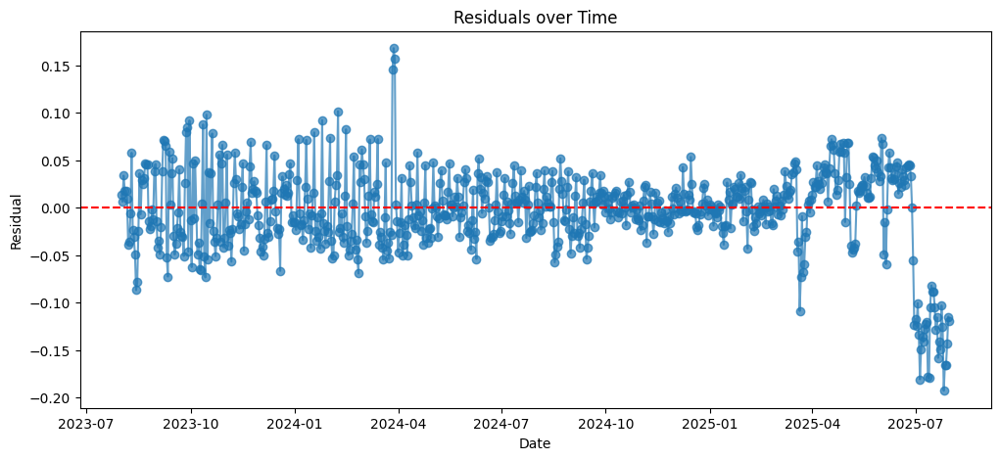

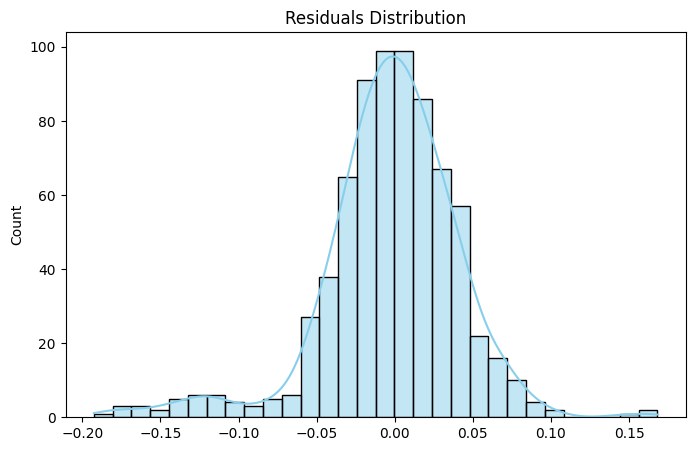

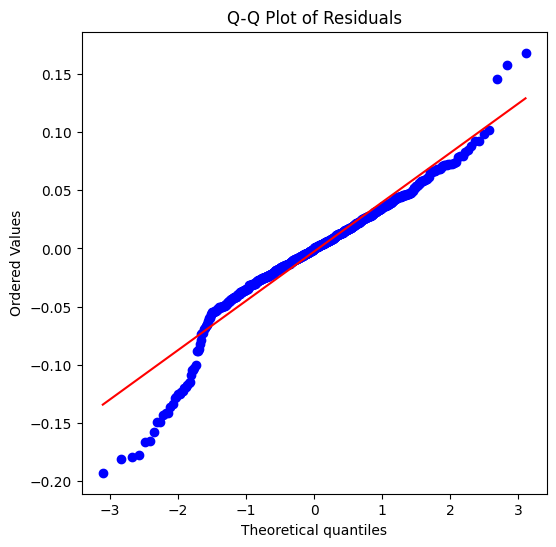

<Figure size 1000x400 with 0 Axes>

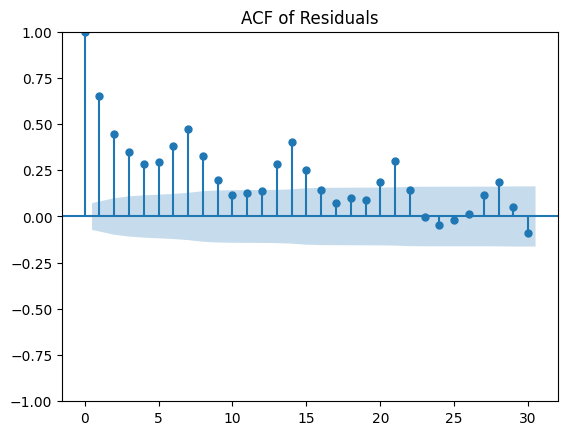

Shapiro-Wilk test: statistic=0.9372, p-value=0.0000
Durbin-Watson statistic: 0.6812 (≈2 means no autocorrelation)


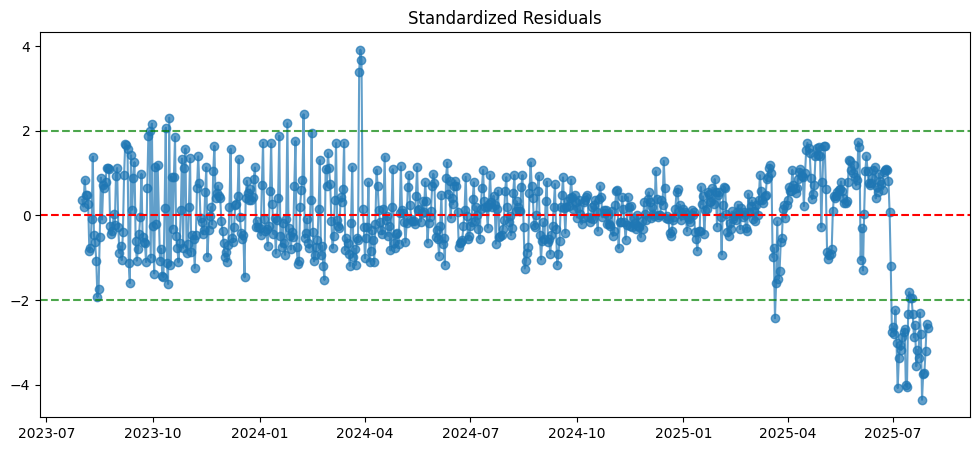

In [119]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf
from scipy import stats
import numpy as np
from statsmodels.stats.stattools import durbin_watson

# -----------------------------
# 1. Extract residuals
# -----------------------------
y_obs = impact_boxcox.series.loc[start_date:end_date, "observed"]
y_pred = impact_boxcox.series.loc[start_date:end_date, "posterior_mean"]

residuals = y_obs - y_pred

# -----------------------------
# 2. Residual plot
# -----------------------------
plt.figure(figsize=(12, 5))
plt.plot(residuals, marker='o', linestyle='-', alpha=0.7)
plt.axhline(0, color='red', linestyle='--')
plt.title("Residuals over Time")
plt.xlabel("Date")
plt.ylabel("Residual") 
plt.show()

# -----------------------------
# 3. Histogram and KDE
# -----------------------------
plt.figure(figsize=(8, 5))
sns.histplot(residuals, kde=True, bins=30, color='skyblue')
plt.title("Residuals Distribution")
plt.show()

# -----------------------------
# 4. Q-Q Plot for normality
# -----------------------------
plt.figure(figsize=(6, 6))
stats.probplot(residuals, dist="norm", plot=plt)
plt.title("Q-Q Plot of Residuals")
plt.show()

# -----------------------------
# 5. Autocorrelation check
# -----------------------------
plt.figure(figsize=(10, 4))
plot_acf(residuals, lags=30)
plt.title("ACF of Residuals")
plt.show()

# -----------------------------
# 6. Statistical tests
# -----------------------------
shapiro_test = stats.shapiro(residuals)
print(f"Shapiro-Wilk test: statistic={shapiro_test.statistic:.4f}, p-value={shapiro_test.pvalue:.4f}")

dw_stat = durbin_watson(residuals)
print(f"Durbin-Watson statistic: {dw_stat:.4f} (≈2 means no autocorrelation)")

# -----------------------------
# 7. Optional: standardized residuals
# -----------------------------
residuals_std = (residuals - residuals.mean()) / residuals.std()
plt.figure(figsize=(12, 5))
plt.plot(residuals_std, marker='o', linestyle='-', alpha=0.7)
plt.axhline(0, color='red', linestyle='--')
plt.axhline(2, color='green', linestyle='--', alpha=0.7)
plt.axhline(-2, color='green', linestyle='--', alpha=0.7)
plt.title("Standardized Residuals")
plt.show()


=== Residual Analysis: Pre-Intervention ===


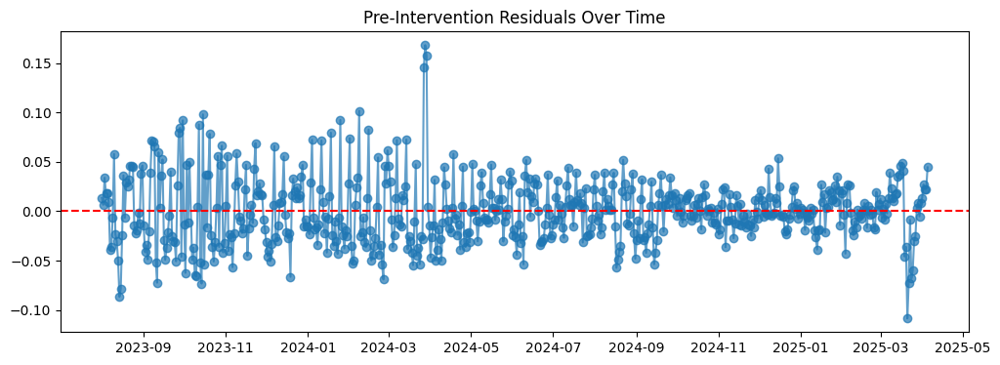

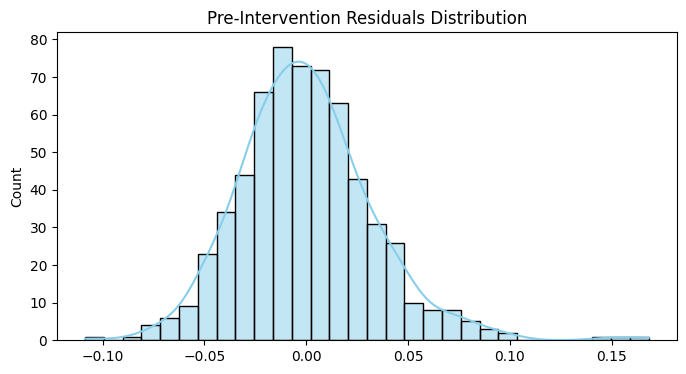

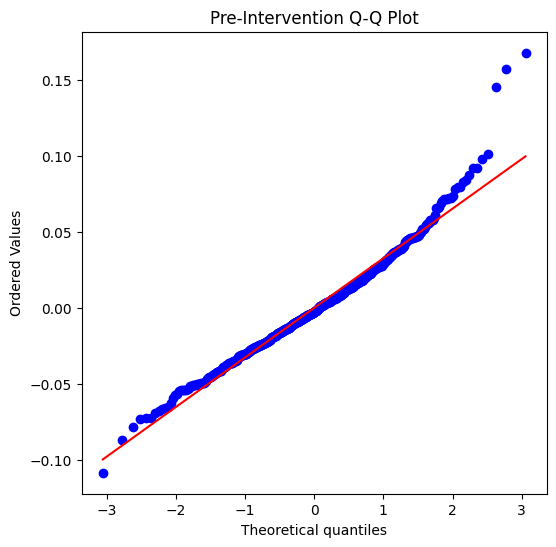

<Figure size 1000x400 with 0 Axes>

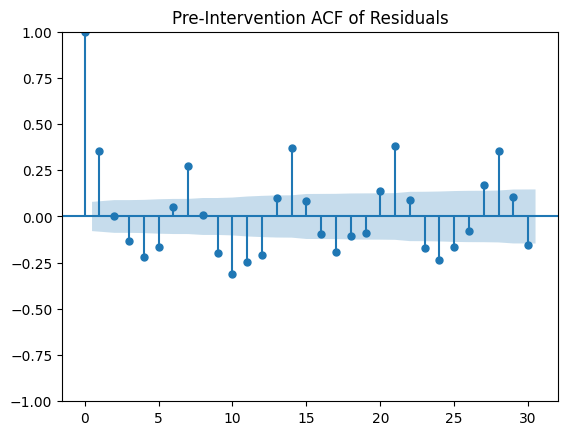

Shapiro-Wilk: stat=0.9712, p-value=0.0000
Durbin-Watson: 1.2874 (≈2 means no autocorrelation)


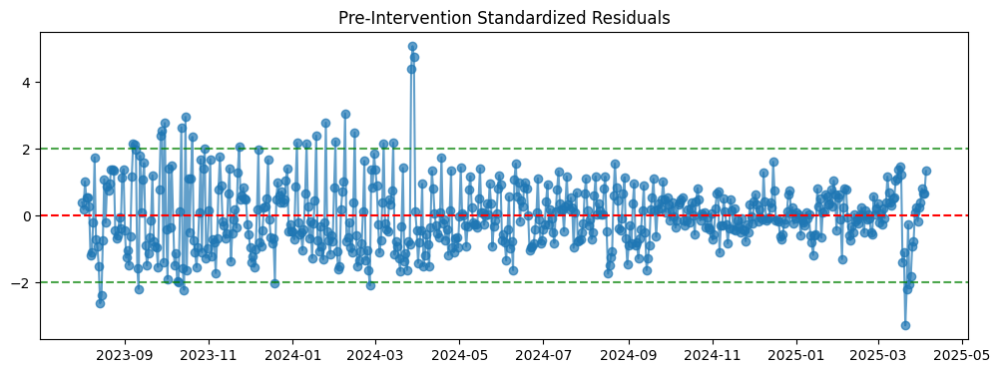

=== Residual Analysis: Post-Intervention ===


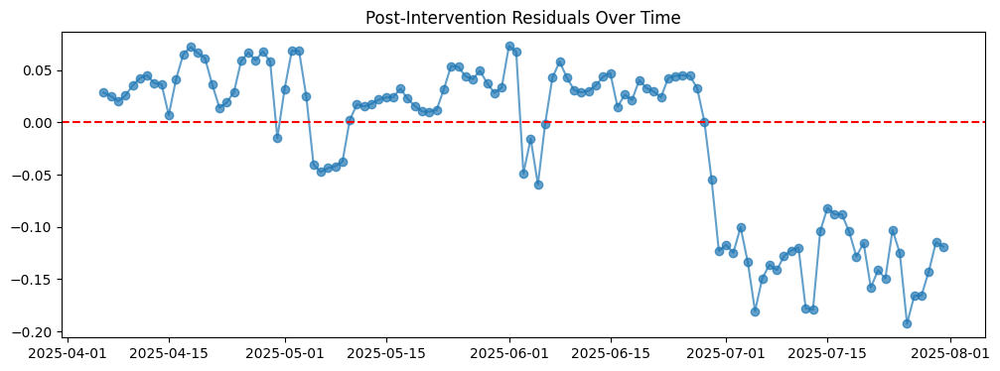

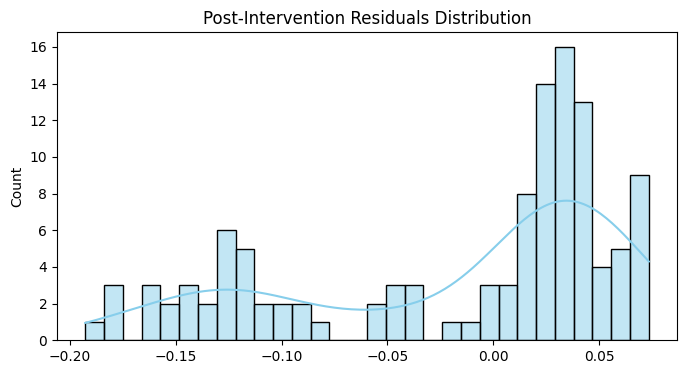

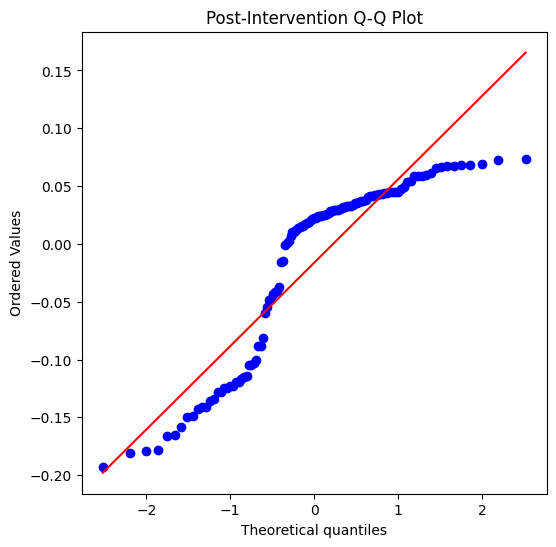

<Figure size 1000x400 with 0 Axes>

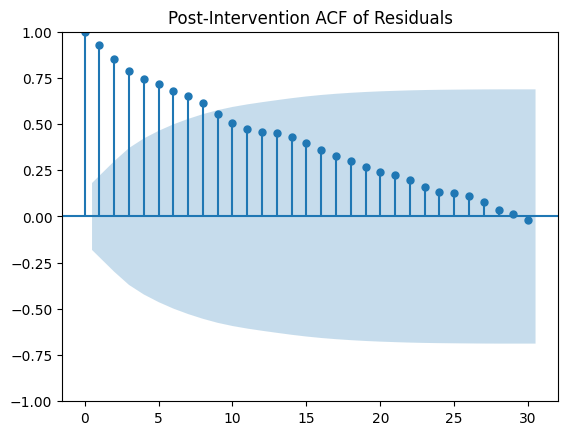

Shapiro-Wilk: stat=0.8407, p-value=0.0000
Durbin-Watson: 0.1196 (≈2 means no autocorrelation)


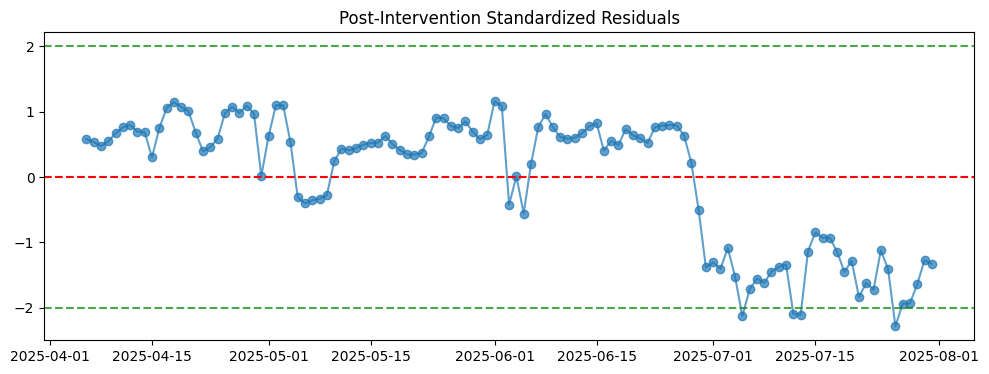

In [120]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf
from scipy import stats
from statsmodels.stats.stattools import durbin_watson

# -----------------------------
# 1. Extract residuals
# -----------------------------

y_obs = impact_boxcox.series.loc[start_date:end_date, "observed"]
y_pred = impact_boxcox.series.loc[start_date:end_date, "posterior_mean"] 

residuals = y_obs - y_pred

# Split into pre- and post-intervention
residuals_pre = residuals.loc[start_date:treatment_date]
residuals_post = residuals.loc[day_after_treatment:end_date]

# Function to analyze residuals
def analyze_residuals(res, period_name):
    print(f"=== Residual Analysis: {period_name} ===")
    
    # Residual over time
    plt.figure(figsize=(12, 4))
    plt.plot(res, marker='o', linestyle='-', alpha=0.7)
    plt.axhline(0, color='red', linestyle='--')
    plt.title(f"{period_name} Residuals Over Time")
    plt.show()
    
    # Histogram + KDE
    plt.figure(figsize=(8, 4))
    sns.histplot(res, kde=True, bins=30, color='skyblue')
    plt.title(f"{period_name} Residuals Distribution")
    plt.show()
    
    # Q-Q plot
    plt.figure(figsize=(6, 6))
    stats.probplot(res, dist="norm", plot=plt)
    plt.title(f"{period_name} Q-Q Plot")
    plt.show()
    
    # Autocorrelation
    plt.figure(figsize=(10, 4))
    plot_acf(res, lags=30)
    plt.title(f"{period_name} ACF of Residuals")
    plt.show()
    
    # Statistical tests
    shapiro_test = stats.shapiro(res)
    dw_stat = durbin_watson(res)
    print(f"Shapiro-Wilk: stat={shapiro_test.statistic:.4f}, p-value={shapiro_test.pvalue:.4f}")
    print(f"Durbin-Watson: {dw_stat:.4f} (≈2 means no autocorrelation)")
    
    # Standardized residuals
    res_std = (res - res.mean()) / res.std()
    plt.figure(figsize=(12, 4))
    plt.plot(res_std, marker='o', linestyle='-', alpha=0.7)
    plt.axhline(0, color='red', linestyle='--')
    plt.axhline(2, color='green', linestyle='--', alpha=0.7)
    plt.axhline(-2, color='green', linestyle='--', alpha=0.7)
    plt.title(f"{period_name} Standardized Residuals")
    plt.show()

# -----------------------------
# 2. Analyze pre- and post- residuals
# -----------------------------
analyze_residuals(residuals_pre, "Pre-Intervention")
analyze_residuals(residuals_post, "Post-Intervention")


In [ ]:

# Get posterior draws for regression weights
weights = np.asarray(impact.posterior_samples.weights)  # shape: (n_draws, n_predictors)

# Split intercept and covariate betas
intercept_draws = weights[:, 0]
beta_draws = weights[:, 1:]  # assume col 0 is intercept, then your covariates

# Name your covariates in the same order used to fit the model
covariate_names = ["curve_trx", "Base_trx", "Optmism_trx","eth_trx"]
assert beta_draws.shape[1] == len(covariate_names), (
    f"Expected {len(covariate_names)} betas, got {beta_draws.shape[1]}"
)

# Summaries
for i, name in enumerate(covariate_names):
    b = beta_draws[:, i]
    mean = b.mean()
    lower, upper = np.quantile(b, [0.025, 0.975])
    p_pos = (b > 0).mean()
    p_neg = (b < 0).mean()
    print(f"{name}: mean={mean:.4f}, 95% CI=({lower:.4f},{upper:.4f}), "
          f"P(>0)={p_pos:.3f}, P(<0)={p_neg:.3f}")